<a href="https://colab.research.google.com/github/boyuan1004/vae_autoencoder--for-Anomaly-Detection/blob/main/VAE_mvtec.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install -q kaggle

from google.colab import files
files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json


Saving kaggle.json to kaggle.json


In [ ]:
!kaggle datasets download ipythonx/mvtec-ad

100% 4.91G/4.91G [04:20<00:00, 18.9MB/s]
100% 4.91G/4.91G [04:20<00:00, 20.2MB/s]


In [ ]:
! mkdir mvtec
!unzip mvtec-ad.zip -d mvtec

串流輸出內容已截斷至最後 5000 行。
  inflating: mvtec/carpet/train/good/149.png  
  inflating: mvtec/carpet/train/good/150.png  
  inflating: mvtec/carpet/train/good/151.png  
  inflating: mvtec/carpet/train/good/152.png  
  inflating: mvtec/carpet/train/good/153.png  
  inflating: mvtec/carpet/train/good/154.png  
  inflating: mvtec/carpet/train/good/155.png  
  inflating: mvtec/carpet/train/good/156.png  
  inflating: mvtec/carpet/train/good/157.png  
  inflating: mvtec/carpet/train/good/158.png  
  inflating: mvtec/carpet/train/good/159.png  
  inflating: mvtec/carpet/train/good/160.png  
  inflating: mvtec/carpet/train/good/161.png  
  inflating: mvtec/carpet/train/good/162.png  
  inflating: mvtec/carpet/train/good/163.png  
  inflating: mvtec/carpet/train/good/164.png  
  inflating: mvtec/carpet/train/good/165.png  
  inflating: mvtec/carpet/train/good/166.png  
  inflating: mvtec/carpet/train/good/167.png  
  inflating: mvtec/carpet/train/good/168.png  
  inflating: mvtec/carpet/train/good/16

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader, random_split
from torch import nn
import torch.nn.functional as F
import torch.optim as optim


In [ ]:
from pathlib import Path
mvtec_path = Path("./mvtec")
pill_path_train = mvtec_path / "pill/train/good"
pill_path_test_cb = mvtec_path /"pill/test/combined"
pill_path_test_ct = mvtec_path / "pill/test/contamination"
pill_path_test_cr = mvtec_path / "pill/test/crack"
pill_path_test_g = mvtec_path / "pill/test/good"
pill_path_test_f = mvtec_path / "pill/test/faulty_imprint"
pill_path_test_s = mvtec_path / "pill/test/scratch"


In [ ]:
capsule_path_train = mvtec_path / "capsule/train/good"
capsule_path_valid = mvtec_path / "capsule/test/good"
capsule_path_test_c = mvtec_path / "capsule/test/crack"
capsule_path_test_f = mvtec_path / "capsule/test/faulty_imprint"
capsule_path_test_p = mvtec_path / "capsule/test/poke"
capsule_path_test_sc = mvtec_path / "capsule/test/scratch"
capsule_path_test_sq = mvtec_path / "capsule/test/squeeze"

In [ ]:
import os
def walk_through_dir(dir_path):
  for dirpath, dirnames, filenames in os.walk(dir_path):
    print(f"There are {len(dirnames)} directories and {len(filenames)} images in '{dirpath}'.")


In [ ]:
walk_through_dir(pill_path_train)
walk_through_dir(pill_path_test_cb)
walk_through_dir(pill_path_test_ct)
walk_through_dir(pill_path_test_cr)
walk_through_dir(pill_path_test_g)
walk_through_dir(pill_path_test_f)
walk_through_dir(pill_path_test_s)


There are 0 directories and 267 images in 'mvtec/pill/train/good'.
There are 0 directories and 17 images in 'mvtec/pill/test/combined'.
There are 0 directories and 21 images in 'mvtec/pill/test/contamination'.
There are 0 directories and 26 images in 'mvtec/pill/test/crack'.
There are 0 directories and 26 images in 'mvtec/pill/test/good'.
There are 0 directories and 19 images in 'mvtec/pill/test/faulty_imprint'.
There are 0 directories and 24 images in 'mvtec/pill/test/scratch'.


In [ ]:
walk_through_dir(capsule_path_train)
walk_through_dir(capsule_path_valid)
walk_through_dir(capsule_path_test_c)
walk_through_dir(capsule_path_test_f)
walk_through_dir(capsule_path_test_p)
walk_through_dir(capsule_path_test_sc)
walk_through_dir(capsule_path_test_sq)

There are 0 directories and 219 images in 'mvtec/capsule/train/good'.
There are 0 directories and 23 images in 'mvtec/capsule/test/good'.
There are 0 directories and 23 images in 'mvtec/capsule/test/crack'.
There are 0 directories and 22 images in 'mvtec/capsule/test/faulty_imprint'.
There are 0 directories and 21 images in 'mvtec/capsule/test/poke'.
There are 0 directories and 23 images in 'mvtec/capsule/test/scratch'.
There are 0 directories and 20 images in 'mvtec/capsule/test/squeeze'.


In [ ]:
# Write a custom dataset class (inherits from torch.utils.data.Dataset)
from torch.utils.data import Dataset
import pathlib
from PIL import Image

# 1. Subclass torch.utils.data.Dataset
class ImageFolderCustom(Dataset):

    # 2. Initialize with a targ_dir and transform (optional) parameter
    def __init__(self, targ_dir: str, transform=None):

        # 3. Create class attributes
        # Get all image paths
        self.paths = list(pathlib.Path(targ_dir).glob("*.png")) # note: you'd have to update this if you've got .png's or .jpeg's
        #self.paths = list(pathlib.Path(targ_dir).glob("*.jpg")) # note: you'd have to update this if you've got .png's or .jpeg's
        # Setup transforms
        self.transform = transform

    # 4. Make function to load images
    def load_image(self, index: int):
        "Opens an image via a path and returns it."
        image_path = self.paths[index]
        return Image.open(image_path).convert("RGB")

    # 5. Overwrite the __len__() method (optional but recommended for subclasses of torch.utils.data.Dataset)
    def __len__(self) -> int:
        "Returns the total number of samples."
        return len(self.paths)

    # 6. Overwrite the __getitem__() method (required for subclasses of torch.utils.data.Dataset)
    def __getitem__(self, index: int):
        "Returns one sample of data, data and label (X, y)."
        img = self.load_image(index)

        # Transform if necessary
        if self.transform:
            return self.transform(img) # return data, label (X, y)
        else:
            return img # return data, label (X, y)

In [ ]:
transform = transforms.Compose([transforms.Resize([256,256]),transforms.Grayscale(),transforms.ToTensor()])
pill_train = ImageFolderCustom(pill_path_train,transform)
pill_valid = ImageFolderCustom(pill_path_test_g, transform)
pill_test_cb = ImageFolderCustom(pill_path_test_cb,transform)
pill_test_ct = ImageFolderCustom(pill_path_test_ct, transform)
pill_test_cr = ImageFolderCustom(pill_path_test_cr, transform)
pill_test_f = ImageFolderCustom(pill_path_test_f, transform)
pill_test_s= ImageFolderCustom(pill_path_test_s,transform)



batch_size=10
pill_trainloader = torch.utils.data.DataLoader(pill_train, batch_size=batch_size, shuffle=True)
pill_validloader = torch.utils.data.DataLoader(pill_valid, batch_size=batch_size, shuffle=False)
pill_test_cbloader = torch.utils.data.DataLoader(pill_test_cb, batch_size=batch_size, shuffle=False)
pill_test_ctloader = torch.utils.data.DataLoader(pill_test_ct ,batch_size=batch_size, shuffle=False)
pill_test_crloader = torch.utils.data.DataLoader(pill_test_cr, batch_size=batch_size, shuffle=False)
pill_test_floader = torch.utils.data.DataLoader(pill_test_f, batch_size=batch_size, shuffle=False)
pill_test_sloader = torch.utils.data.DataLoader(pill_test_s, batch_size=batch_size, shuffle=False)


In [ ]:
transform = transforms.Compose([transforms.Resize([224,224]),transforms.RandomVerticalFlip(p=0.5),transforms.Grayscale(),transforms.ToTensor()])
capsule_train = ImageFolderCustom(capsule_path_train, transform)
capsule_valid = ImageFolderCustom(capsule_path_valid,transform)
capsule_test_c = ImageFolderCustom(capsule_path_test_c, transform)
capsule_test_f = ImageFolderCustom(capsule_path_test_f,transform)
capsule_test_p= ImageFolderCustom(capsule_path_test_p,transform)
capsule_test_sc = ImageFolderCustom(capsule_path_test_sc,transform)
capsule_test_sq= ImageFolderCustom(capsule_path_test_sq,transform)

batch_size = 10
capsule_trainloader = torch.utils.data.DataLoader(capsule_train, batch_size=batch_size, shuffle=True)
capsule_validloader = torch.utils.data.DataLoader(capsule_valid, batch_size=batch_size, shuffle=False)
capsule_test_cloader= torch.utils.data.DataLoader(capsule_test_c, batch_size=batch_size, shuffle=False)
capsule_test_floader= torch.utils.data.DataLoader(capsule_test_f, batch_size=batch_size, shuffle=False)
capsule_test_ploader= torch.utils.data.DataLoader(capsule_test_p, batch_size=batch_size, shuffle=False)
capsule_test_scloader= torch.utils.data.DataLoader(capsule_test_sc, batch_size=batch_size, shuffle=False)
capsule_test_sqloader= torch.utils.data.DataLoader(capsule_test_sq, batch_size=batch_size, shuffle=False)

In [ ]:
def check_visual_data(train_data, test_data):
  img = train_data[0]
  print(f"Image tensor:\n{img}")
  print(f"Image shape: {img.shape}")
  print(f"Image datatype: {img.dtype}")
  for i in range(9):
    image_t =test_data[i]
    img=image_t.permute(1,2,0)
    plt.subplot(3,3,i+1)
    plt.imshow(img.cpu().numpy(), cmap="gray")
    print(image_t.shape)
  plt.show()

In [ ]:
check_visual_data(capsule_train, capsule_valid)

NameError: ignored

In [ ]:
def check_dataloader(train_loader, val_loader, test_loader):
  img = next(iter(train_loader))
  print(f"Image shape: {img.shape} -> [batch_size, color_channels, height, width]")
  #print(f"Label shape: {label.shape}")
  print("valid part ---------")
  img_vd = next(iter(val_loader))
  print(f"Image shape: {img_vd.shape} -> [batch_size, color_channels, height, width]")
  #print(f"Label shape: {label_vd.shape}")
  print("test part ---------")
  img_test = next(iter(test_loader))
  print(f"Image shape: {img_test.shape} -> [batch_size, color_channels, height, width]")
  #print(f"Label shape: {label_test.shape}")


In [ ]:
check_dataloader(capsule_trainloader, capsule_validloader, capsule_test_floader)

Image shape: torch.Size([10, 1, 224, 224]) -> [batch_size, color_channels, height, width]
valid part ---------
Image shape: torch.Size([10, 1, 224, 224]) -> [batch_size, color_channels, height, width]
test part ---------
Image shape: torch.Size([10, 1, 224, 224]) -> [batch_size, color_channels, height, width]


#define encoder and decoder

**encoder class**

In [ ]:
class Encoder(nn.Module):
  def __init__(self, encoded_space_dim, fc2_input_dim):
    super().__init__()

    self.encoder_cnn = nn.Sequential(
        nn.Conv2d(1,32,kernel_size=4,stride=2,padding=1),
        nn.BatchNorm2d(32),
        nn.ReLU(True),
        nn.Conv2d(32,64,kernel_size=4,stride=2,padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        nn.Conv2d(64,128,kernel_size=4, stride=2,padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(True),
        nn.Conv2d(128,64,kernel_size=4, stride=2,padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        nn.Conv2d(64,512,kernel_size=3, stride=1,padding=0),

    )

    self.fc1 = nn.Linear(512*12*12, 512)
    self.fc2 = nn.Linear(512*12*12, 512)



  def forward(self,x):
    x = self.encoder_cnn(x)
    x = x.view(-1, 512*12*12)
    mu = self.fc1(x)
    logvar = self.fc2(x)
    return mu, logvar

encoderm = Encoder(1,256)
encoderm

Encoder(
  (encoder_cnn): Sequential(
    (0): Conv2d(1, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=True)
    (3): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=True)
    (6): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=True)
    (9): Conv2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=True)
    (12): Conv2d(64, 512, kernel_size=(3, 3), stride=(1, 1))
  )
  (fc1): Linear(in_features=73728, out_features=512, bias=True)
  (fc2): Line

**decoder class**

In [ ]:
from torch.nn.modules import BatchNorm2d

class Decoder(nn.Module):
  def __init__(self,encoded_space_dim, fc2_input_dim):
    super().__init__()

    self.decoder_conv = nn.Sequential(
        nn.ConvTranspose2d(512,64,kernel_size=3,stride=1,padding=0),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        nn.ConvTranspose2d(64,128,kernel_size=4,stride=2,padding=1),
        nn.BatchNorm2d(128),
        nn.ReLU(True),
        nn.ConvTranspose2d(128,64,kernel_size=4,stride=2,padding=1),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        nn.ConvTranspose2d(64,32,kernel_size=4,stride=2,padding=1),
        nn.BatchNorm2d(32),
        nn.ReLU(True),
        nn.ConvTranspose2d(32,1,kernel_size=4,stride=2,padding=1)
    )
    self.fc1 = nn.Sequential(
        nn.Linear(512, 512*12*12),
        nn.ReLU(True)

    )

  def forward(self,x):
    x = self.fc1(x)
    x = x.view(-1,512,12,12)
    x = self.decoder_conv(x)
    x = torch.sigmoid(x)
    return x

decoderm = Decoder(1,256)
decoderm

Decoder(
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(512, 64, kernel_size=(3, 3), stride=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=True)
    (3): ConvTranspose2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=True)
    (6): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=True)
    (9): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=True)
    (12): ConvTranspose2d(32, 1, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  )
  (fc1): Sequential(
    (0): L

In [ ]:
class AutoEncoder(nn.Module):
  def __init__(self,encoded_space_dim, fc2_input_dim):
    super().__init__()
    #encoder
    self.encoder = Encoder(encoded_space_dim, fc2_input_dim)
    #decoder
    self.decoder = Decoder(encoded_space_dim, fc2_input_dim)

  def reparameterize(self, mu, logVar):

    #Reparameterization takes in the input mu and logVar and sample the mu + std * eps
    std = torch.exp(logVar/2)
    eps = torch.randn_like(std)
    return mu + std * eps


  def forward(self, x):
    mu, logvar = self.encoder(x)
    z = self.reparameterize(mu, logvar)
    decoded = self.decoder(z)

    return decoded, mu, logvar

#lossfunction, optimizer

In [ ]:

#loss_fn = torch.nn.MSELoss()
lr = 0.0002
torch.manual_seed(0)
#initialize the network
d=1

autoencoder = AutoEncoder(encoded_space_dim=1, fc2_input_dim=256)
optimizer = torch.optim.Adam(autoencoder.parameters(),lr=lr,weight_decay=1e-05)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')
autoencoder.to(device)

Selected device: cuda


AutoEncoder(
  (encoder): Encoder(
    (encoder_cnn): Sequential(
      (0): Conv2d(1, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=True)
      (3): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=True)
      (6): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): LeakyReLU(negative_slope=True)
      (9): Conv2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): LeakyReLU(negative_slope=True)
      (12): Conv2d(64, 512, kernel_size=(3, 3), stride=(1, 1))
    )
    (fc1): Linear(in_

#training and evaluation

In [ ]:
from torch.distributions.kl import kl_divergence

def train_epoch(autoencoder, device, dataloader, optimizer,loss_fn):
    # Set train mode for both the encoder and the decoder
    autoencoder.train()

    train_loss = []
    pair_train_loss = 0
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for image_batch in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        decoded_data, mu, logvar = autoencoder(image_batch)
        # Evaluate loss
        #kl_divergence = 0.5*torch.sum(-1 - logvar + mu.pow(2) + logvar.exp())
        kl_divergence = -0.5 * torch.sum(1+logvar - mu.pow(2) - logvar.exp())
        #loss = torch.nn.functional.binary_cross_entropy(decoded_data, image_batch, size_average=False) + kl_divergence
        #loss = (1-loss_fn(decoded_data,image_batch)) + kl_divergence
        loss = loss_fn(decoded_data, image_batch) + kl_divergence
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        print('\t partial train loss (single batch): %f' % (loss.data))
        train_loss.append(loss.detach().cpu().numpy())
    pair_train_loss = np.mean(train_loss)
    return pair_train_loss, train_loss

#test

In [ ]:
def test_epoch(autoencoder, device, dataloader, loss_fn):
  autoencoder.eval()
  with torch.no_grad():
    conc_out=[]
    conc_label=[]
    for image_batch in dataloader:
      image_batch = image_batch.to(device)
      decoded_data, mu, logvar = autoencoder(image_batch)
      # Append the network output and the original image to the lists
      conc_out.append(decoded_data.cpu())
      conc_label.append(image_batch.cpu())

    #create a single tensor with all the value in lists
    conc_out = torch.cat(conc_out)
    conc_label = torch.cat(conc_label)
    #evalute global loss
    #kl_divergence = 0.5*torch.sum(-1 - logvar + mu.pow(2) + logvar.exp())
    kl_divergence = -0.5 * torch.sum(1+logvar - mu.pow(2) - logvar.exp())
    #val_loss = torch.nn.functional.binary_cross_entropy(conc_out, conc_label, size_average=False) + kl_divergence
    #val_loss = loss_fn(conc_out, conc_label) + kl_divergence
    val_loss = (1-loss_fn(conc_out, conc_label)) + kl_divergence
  return val_loss.data


**autoencoder learning to reconstruct the image**



In [ ]:
import tensorflow as tf

def plot_ae_outputs_den(autoencoder,n=4):
    scores = []
    plt.figure(figsize=(16,6))
    for i in range(n):
      ax = plt.subplot(4,5,i+1)
      img_train = capsule_train[i].unsqueeze(0)
      print("train",img_train.shape)
      img_test = capsule_valid[i].unsqueeze(0)
      print("test",img_test.shape)
      img_test = img_test.to(device)
      n=n+1
      autoencoder.eval()
      with torch.no_grad():
         rec_img,_,_ = autoencoder(img_test)

      img_train=img_train.squeeze(0).permute(1,2,0)
      #img_train = img_train.permute(1,2,0)
      print(i,img_train.shape)
      plt.imshow(img_train.cpu().numpy(),cmap="gray")
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Original images')
      ax = plt.subplot(4,5,i+1+5)
      img_test=img_test.squeeze(0).permute(1,2,0)
      print(img_test.shape)
      plt.imshow(img_test.cpu().numpy(),cmap="gray")
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
        ax.set_title('Corrupted images')
      ax = plt.subplot(4,5,i+1+10)
      rec_img=rec_img.squeeze(0).permute(1,2,0)
      print(rec_img.shape)
      plt.imshow(rec_img.cpu().numpy())
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      if i == n//2:
         ax.set_title('Reconstructed images')
      ax = plt.subplot(4,5, i+1+15)
      diff_img = np.abs(rec_img.cpu().numpy() - img_test.cpu().numpy())
      diff = np.sum(diff_img)
      plt.gray()
      plt.imshow(diff_img,cmap='jet')
      ax.get_xaxis().set_visible(True)
      ax.get_yaxis().set_visible(False)
      ax.set_xlabel('score = ' + str(diff))
      scores.append(diff)
      plt.subplots_adjust(left=0.1,
                    bottom=0.1,
                    right=0.7,
                    top=0.9,
                    wspace=0.3,
                    hspace=0.3)
    plt.show()

#trianing cycle

In [ ]:
! pip install dill
! pip install pytorch_msssim

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.5/110.5 kB 16.3 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


EPOCH 1/150
	 partial train loss (single batch): 149.490463
	 partial train loss (single batch): 135.518723
	 partial train loss (single batch): 72.841225
	 partial train loss (single batch): 100.576065
	 partial train loss (single batch): 95.006401
	 partial train loss (single batch): 59.678299
	 partial train loss (single batch): 68.693047
	 partial train loss (single batch): 96.682442
	 partial train loss (single batch): 69.623505
	 partial train loss (single batch): 44.666370
	 partial train loss (single batch): 77.248581
	 partial train loss (single batch): 63.109440
	 partial train loss (single batch): 40.179455
	 partial train loss (single batch): 73.531532
	 partial train loss (single batch): 61.265320
	 partial train loss (single batch): 25.935883
	 partial train loss (single batch): 58.053799
	 partial train loss (single batch): 70.626099
	 partial train loss (single batch): 24.369980
	 partial train loss (single batch): 52.159050
	 partial train loss (single batch): 47.88857

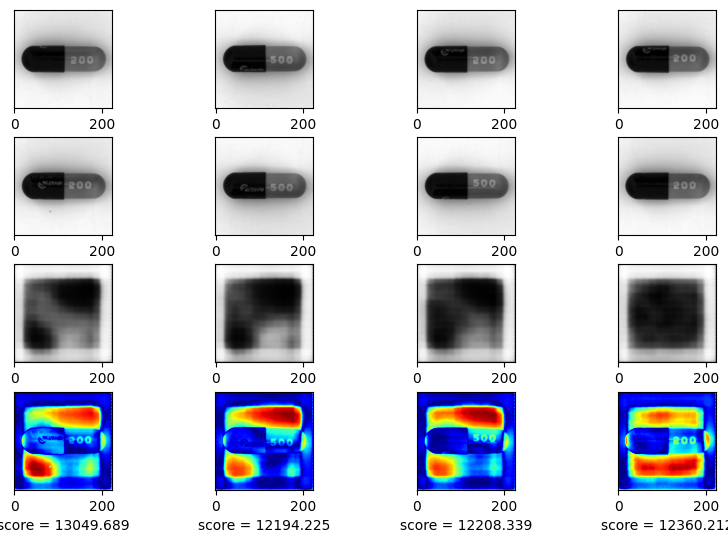

EPOCH 2/150
	 partial train loss (single batch): 32.632320
	 partial train loss (single batch): 32.364025
	 partial train loss (single batch): 17.440926
	 partial train loss (single batch): 25.767002
	 partial train loss (single batch): 35.989929
	 partial train loss (single batch): 14.486284
	 partial train loss (single batch): 19.662361
	 partial train loss (single batch): 38.460026
	 partial train loss (single batch): 16.123779
	 partial train loss (single batch): 27.319880
	 partial train loss (single batch): 21.232599
	 partial train loss (single batch): 14.494034
	 partial train loss (single batch): 16.537128
	 partial train loss (single batch): 23.690344
	 partial train loss (single batch): 15.969314
	 partial train loss (single batch): 25.046551
	 partial train loss (single batch): 22.515741
	 partial train loss (single batch): 11.485445
	 partial train loss (single batch): 23.325115
	 partial train loss (single batch): 26.291880
	 partial train loss (single batch): 13.160421
	

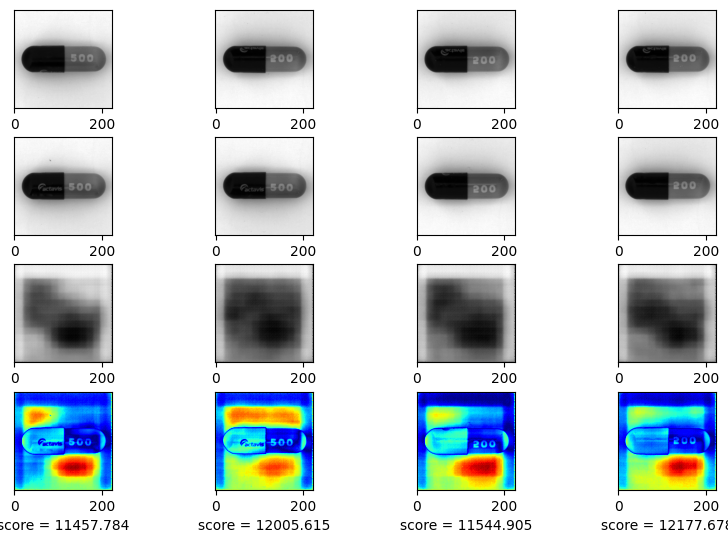

EPOCH 3/150
	 partial train loss (single batch): 20.967056
	 partial train loss (single batch): 10.747908
	 partial train loss (single batch): 12.936033
	 partial train loss (single batch): 18.009003
	 partial train loss (single batch): 8.552783
	 partial train loss (single batch): 15.218384
	 partial train loss (single batch): 13.852202
	 partial train loss (single batch): 5.628022
	 partial train loss (single batch): 17.003433
	 partial train loss (single batch): 7.907575
	 partial train loss (single batch): 13.067576
	 partial train loss (single batch): 6.322170
	 partial train loss (single batch): 8.862594
	 partial train loss (single batch): 6.719850
	 partial train loss (single batch): 12.420071
	 partial train loss (single batch): 6.740743
	 partial train loss (single batch): 6.272658
	 partial train loss (single batch): 6.933485
	 partial train loss (single batch): 4.777082
	 partial train loss (single batch): 6.440977
	 partial train loss (single batch): 10.221769
	 partial tr

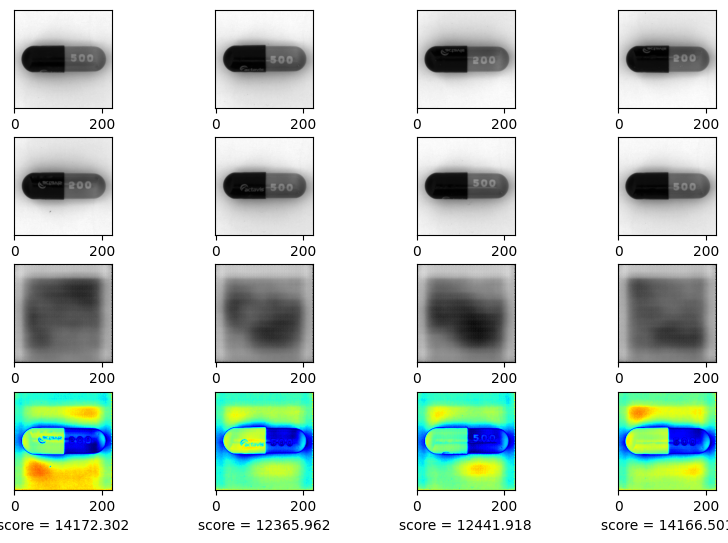

EPOCH 4/150
	 partial train loss (single batch): 10.180260
	 partial train loss (single batch): 4.126198
	 partial train loss (single batch): 9.966500
	 partial train loss (single batch): 6.634409
	 partial train loss (single batch): 8.482027
	 partial train loss (single batch): 7.220605
	 partial train loss (single batch): 4.448178
	 partial train loss (single batch): 8.715544
	 partial train loss (single batch): 6.142550
	 partial train loss (single batch): 6.134511
	 partial train loss (single batch): 8.711991
	 partial train loss (single batch): 5.411156
	 partial train loss (single batch): 5.537738
	 partial train loss (single batch): 12.992182
	 partial train loss (single batch): 9.417345
	 partial train loss (single batch): 11.509208
	 partial train loss (single batch): 8.315197
	 partial train loss (single batch): 10.286543
	 partial train loss (single batch): 6.936819
	 partial train loss (single batch): 6.346567
	 partial train loss (single batch): 6.592860
	 partial train lo

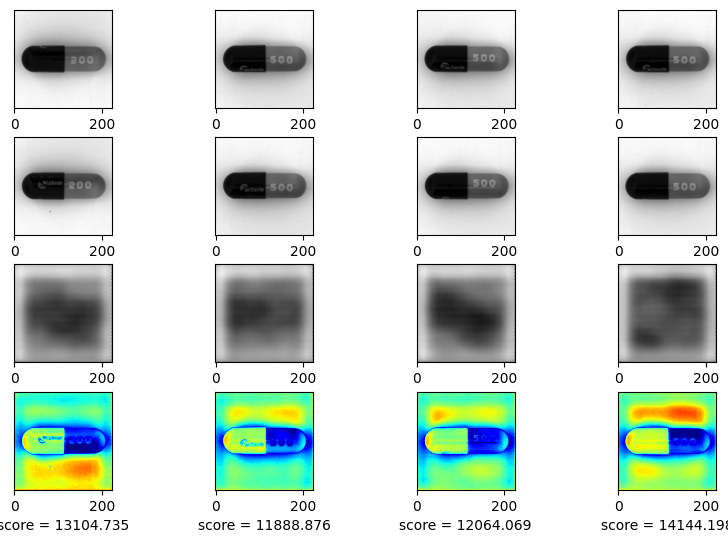

EPOCH 5/150
	 partial train loss (single batch): 7.238663
	 partial train loss (single batch): 7.640251
	 partial train loss (single batch): 7.282821
	 partial train loss (single batch): 7.588102
	 partial train loss (single batch): 7.935456
	 partial train loss (single batch): 5.739069
	 partial train loss (single batch): 4.534984
	 partial train loss (single batch): 6.124573
	 partial train loss (single batch): 7.061862
	 partial train loss (single batch): 4.229939
	 partial train loss (single batch): 6.457842
	 partial train loss (single batch): 6.253835
	 partial train loss (single batch): 5.668064
	 partial train loss (single batch): 9.183999
	 partial train loss (single batch): 5.605818
	 partial train loss (single batch): 5.144190
	 partial train loss (single batch): 4.813683
	 partial train loss (single batch): 6.467595
	 partial train loss (single batch): 6.564042
	 partial train loss (single batch): 5.989980
	 partial train loss (single batch): 5.793725
	 partial train loss (

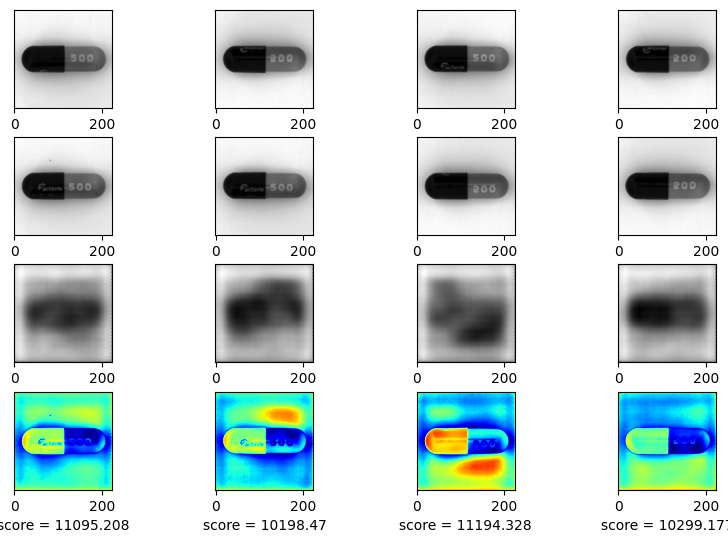

EPOCH 6/150
	 partial train loss (single batch): 10.739893
	 partial train loss (single batch): 5.476099
	 partial train loss (single batch): 8.193707
	 partial train loss (single batch): 4.937813
	 partial train loss (single batch): 8.216135
	 partial train loss (single batch): 3.899967
	 partial train loss (single batch): 8.328768
	 partial train loss (single batch): 8.927479
	 partial train loss (single batch): 5.558153
	 partial train loss (single batch): 8.497516
	 partial train loss (single batch): 6.634928
	 partial train loss (single batch): 6.819922
	 partial train loss (single batch): 6.552125
	 partial train loss (single batch): 4.199834
	 partial train loss (single batch): 7.240338
	 partial train loss (single batch): 4.752527
	 partial train loss (single batch): 5.026063
	 partial train loss (single batch): 3.322889
	 partial train loss (single batch): 4.340547
	 partial train loss (single batch): 4.287523
	 partial train loss (single batch): 4.227035
	 partial train loss 

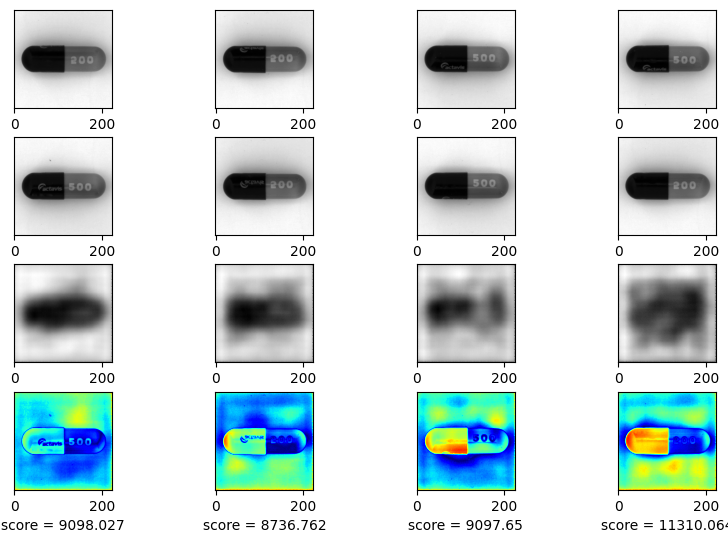

EPOCH 7/150
	 partial train loss (single batch): 4.204882
	 partial train loss (single batch): 4.992618
	 partial train loss (single batch): 5.362378
	 partial train loss (single batch): 3.719436
	 partial train loss (single batch): 5.750204
	 partial train loss (single batch): 5.478375
	 partial train loss (single batch): 5.310795
	 partial train loss (single batch): 5.203953
	 partial train loss (single batch): 5.561167
	 partial train loss (single batch): 8.323524
	 partial train loss (single batch): 6.587428
	 partial train loss (single batch): 4.874674
	 partial train loss (single batch): 4.028658
	 partial train loss (single batch): 4.969868
	 partial train loss (single batch): 4.542548
	 partial train loss (single batch): 8.793580
	 partial train loss (single batch): 6.878635
	 partial train loss (single batch): 5.876291
	 partial train loss (single batch): 6.969637
	 partial train loss (single batch): 6.740083
	 partial train loss (single batch): 5.244032
	 partial train loss (

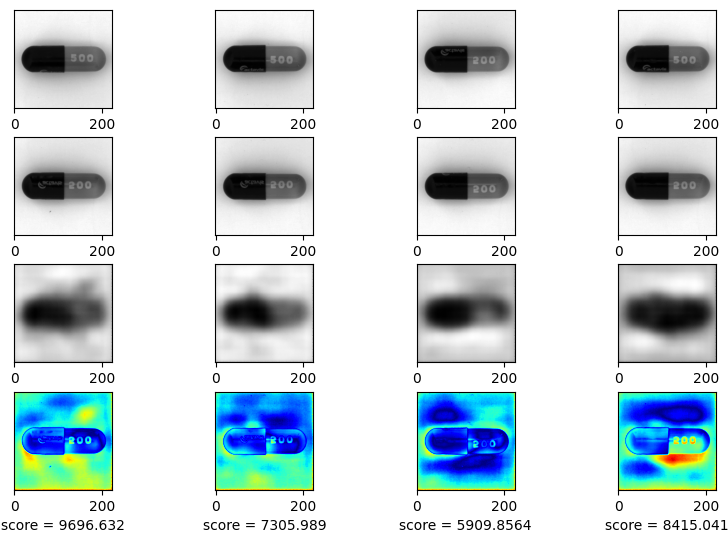

EPOCH 8/150
	 partial train loss (single batch): 5.654815
	 partial train loss (single batch): 4.721417
	 partial train loss (single batch): 4.208778
	 partial train loss (single batch): 6.950002
	 partial train loss (single batch): 6.410285
	 partial train loss (single batch): 5.948215
	 partial train loss (single batch): 5.177779
	 partial train loss (single batch): 5.800096
	 partial train loss (single batch): 6.477550
	 partial train loss (single batch): 3.594674
	 partial train loss (single batch): 5.114248
	 partial train loss (single batch): 4.343222
	 partial train loss (single batch): 5.363795
	 partial train loss (single batch): 4.700142
	 partial train loss (single batch): 4.706211
	 partial train loss (single batch): 3.176755
	 partial train loss (single batch): 6.974844
	 partial train loss (single batch): 6.427021
	 partial train loss (single batch): 4.546021
	 partial train loss (single batch): 5.283683
	 partial train loss (single batch): 4.010216
	 partial train loss (

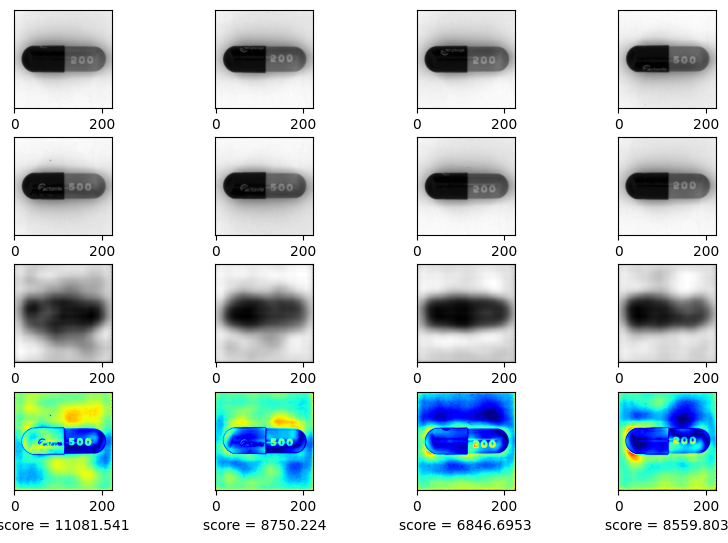

EPOCH 9/150
	 partial train loss (single batch): 4.444963
	 partial train loss (single batch): 3.451514
	 partial train loss (single batch): 6.618267
	 partial train loss (single batch): 5.322248
	 partial train loss (single batch): 6.517442
	 partial train loss (single batch): 5.483083
	 partial train loss (single batch): 9.839344
	 partial train loss (single batch): 6.747255
	 partial train loss (single batch): 7.365030
	 partial train loss (single batch): 6.792866
	 partial train loss (single batch): 7.949309
	 partial train loss (single batch): 6.120336
	 partial train loss (single batch): 10.132373
	 partial train loss (single batch): 7.259496
	 partial train loss (single batch): 5.425751
	 partial train loss (single batch): 6.276940
	 partial train loss (single batch): 3.745027
	 partial train loss (single batch): 3.063642
	 partial train loss (single batch): 4.091822
	 partial train loss (single batch): 4.799877
	 partial train loss (single batch): 3.947797
	 partial train loss 

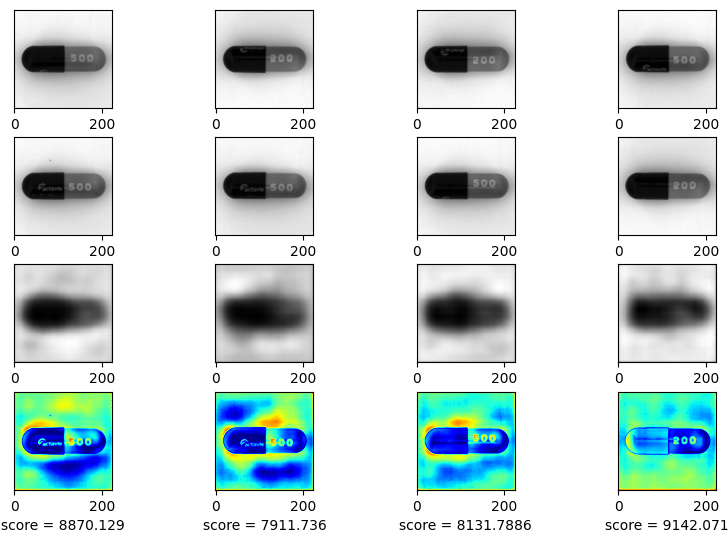

EPOCH 10/150
	 partial train loss (single batch): 2.969869
	 partial train loss (single batch): 7.749475
	 partial train loss (single batch): 3.623279
	 partial train loss (single batch): 8.953835
	 partial train loss (single batch): 2.773393
	 partial train loss (single batch): 10.146353
	 partial train loss (single batch): 3.372501
	 partial train loss (single batch): 5.446465
	 partial train loss (single batch): 3.101185
	 partial train loss (single batch): 5.895478
	 partial train loss (single batch): 3.310031
	 partial train loss (single batch): 5.065056
	 partial train loss (single batch): 4.381323
	 partial train loss (single batch): 3.994240
	 partial train loss (single batch): 4.799953
	 partial train loss (single batch): 4.179436
	 partial train loss (single batch): 4.893413
	 partial train loss (single batch): 7.303267
	 partial train loss (single batch): 3.467799
	 partial train loss (single batch): 6.928857
	 partial train loss (single batch): 3.342824
	 partial train loss

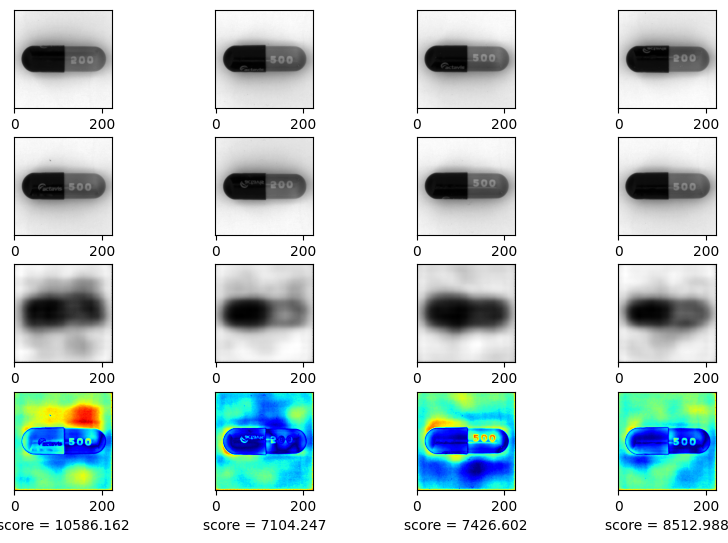

EPOCH 11/150
	 partial train loss (single batch): 3.381397
	 partial train loss (single batch): 3.985553
	 partial train loss (single batch): 4.416610
	 partial train loss (single batch): 5.007630
	 partial train loss (single batch): 2.660249
	 partial train loss (single batch): 4.883866
	 partial train loss (single batch): 7.369439
	 partial train loss (single batch): 5.555454
	 partial train loss (single batch): 7.680159
	 partial train loss (single batch): 3.686935
	 partial train loss (single batch): 5.070895
	 partial train loss (single batch): 2.765219
	 partial train loss (single batch): 3.722593
	 partial train loss (single batch): 3.930263
	 partial train loss (single batch): 5.261992
	 partial train loss (single batch): 5.567790
	 partial train loss (single batch): 8.346354
	 partial train loss (single batch): 5.315404
	 partial train loss (single batch): 8.523477
	 partial train loss (single batch): 3.791884
	 partial train loss (single batch): 7.567258
	 partial train loss 

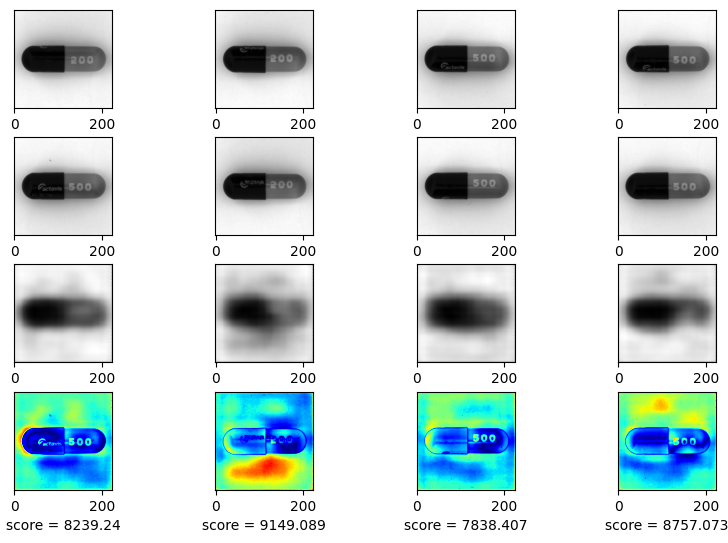

EPOCH 12/150
	 partial train loss (single batch): 11.731929
	 partial train loss (single batch): 3.315307
	 partial train loss (single batch): 8.317591
	 partial train loss (single batch): 4.818152
	 partial train loss (single batch): 4.639610
	 partial train loss (single batch): 6.643901
	 partial train loss (single batch): 6.208043
	 partial train loss (single batch): 8.338446
	 partial train loss (single batch): 4.306708
	 partial train loss (single batch): 7.845711
	 partial train loss (single batch): 4.445966
	 partial train loss (single batch): 9.224389
	 partial train loss (single batch): 5.744984
	 partial train loss (single batch): 4.661644
	 partial train loss (single batch): 6.324546
	 partial train loss (single batch): 5.126208
	 partial train loss (single batch): 6.142582
	 partial train loss (single batch): 6.339211
	 partial train loss (single batch): 3.702641
	 partial train loss (single batch): 5.867950
	 partial train loss (single batch): 2.981630
	 partial train loss

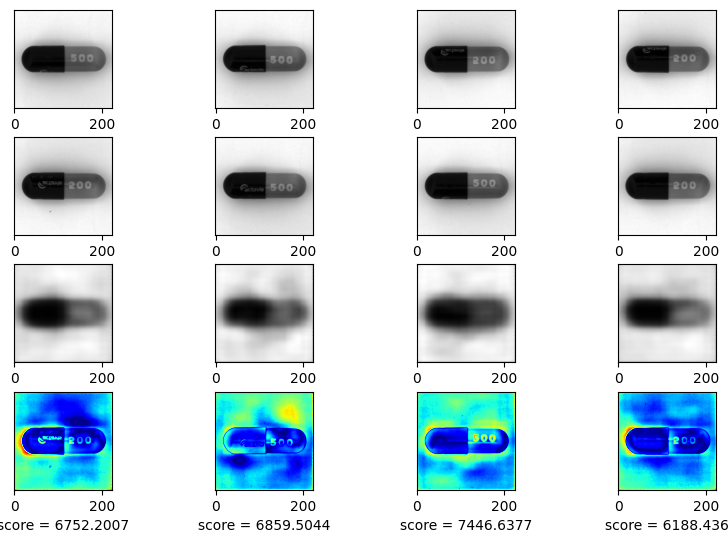

EPOCH 13/150
	 partial train loss (single batch): 3.553139
	 partial train loss (single batch): 8.765715
	 partial train loss (single batch): 4.542120
	 partial train loss (single batch): 8.665613
	 partial train loss (single batch): 6.140552
	 partial train loss (single batch): 6.149918
	 partial train loss (single batch): 8.006486
	 partial train loss (single batch): 6.314640
	 partial train loss (single batch): 7.104120
	 partial train loss (single batch): 5.463330
	 partial train loss (single batch): 11.374992
	 partial train loss (single batch): 2.212123
	 partial train loss (single batch): 8.518587
	 partial train loss (single batch): 2.606018
	 partial train loss (single batch): 11.126950
	 partial train loss (single batch): 4.006158
	 partial train loss (single batch): 10.975909
	 partial train loss (single batch): 9.288267
	 partial train loss (single batch): 6.165044
	 partial train loss (single batch): 7.934280
	 partial train loss (single batch): 4.678174
	 partial train lo

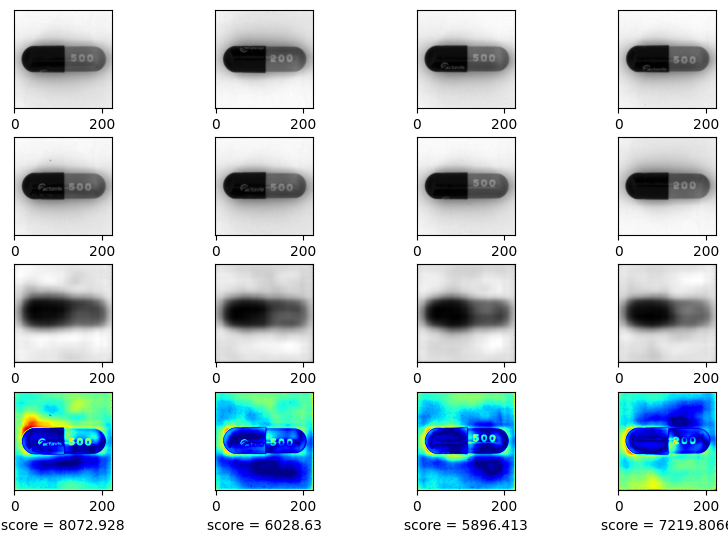

EPOCH 14/150
	 partial train loss (single batch): 4.886327
	 partial train loss (single batch): 6.907529
	 partial train loss (single batch): 3.373695
	 partial train loss (single batch): 9.222761
	 partial train loss (single batch): 5.366797
	 partial train loss (single batch): 3.566821
	 partial train loss (single batch): 4.030826
	 partial train loss (single batch): 2.914035
	 partial train loss (single batch): 3.473726
	 partial train loss (single batch): 3.018578
	 partial train loss (single batch): 4.143071
	 partial train loss (single batch): 3.209323
	 partial train loss (single batch): 4.950881
	 partial train loss (single batch): 4.609867
	 partial train loss (single batch): 5.492127
	 partial train loss (single batch): 7.539351
	 partial train loss (single batch): 2.630079
	 partial train loss (single batch): 4.412144
	 partial train loss (single batch): 3.251863
	 partial train loss (single batch): 5.721106
	 partial train loss (single batch): 3.799652
	 partial train loss 

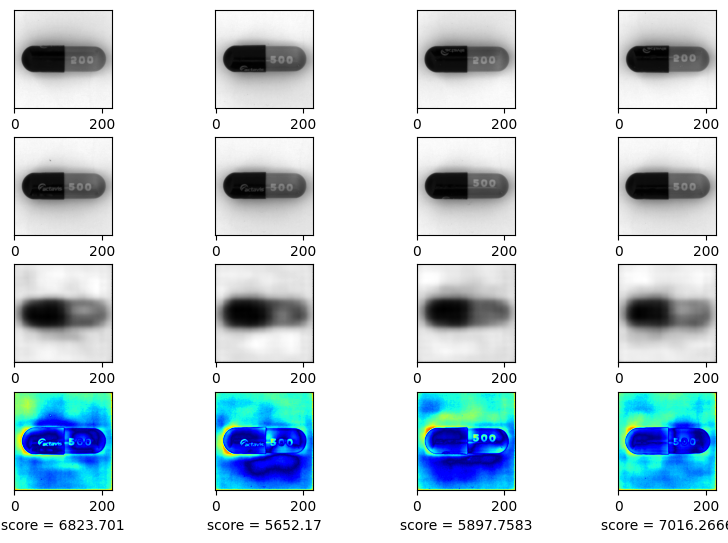

EPOCH 15/150
	 partial train loss (single batch): 7.774671
	 partial train loss (single batch): 2.281146
	 partial train loss (single batch): 5.003145
	 partial train loss (single batch): 2.662011
	 partial train loss (single batch): 3.154037
	 partial train loss (single batch): 3.351399
	 partial train loss (single batch): 2.439503
	 partial train loss (single batch): 3.806160
	 partial train loss (single batch): 3.237994
	 partial train loss (single batch): 3.901913
	 partial train loss (single batch): 3.294740
	 partial train loss (single batch): 4.015332
	 partial train loss (single batch): 2.851097
	 partial train loss (single batch): 3.044331
	 partial train loss (single batch): 2.776422
	 partial train loss (single batch): 2.837846
	 partial train loss (single batch): 3.374578
	 partial train loss (single batch): 3.043211
	 partial train loss (single batch): 2.868365
	 partial train loss (single batch): 3.737458
	 partial train loss (single batch): 2.515742
	 partial train loss 

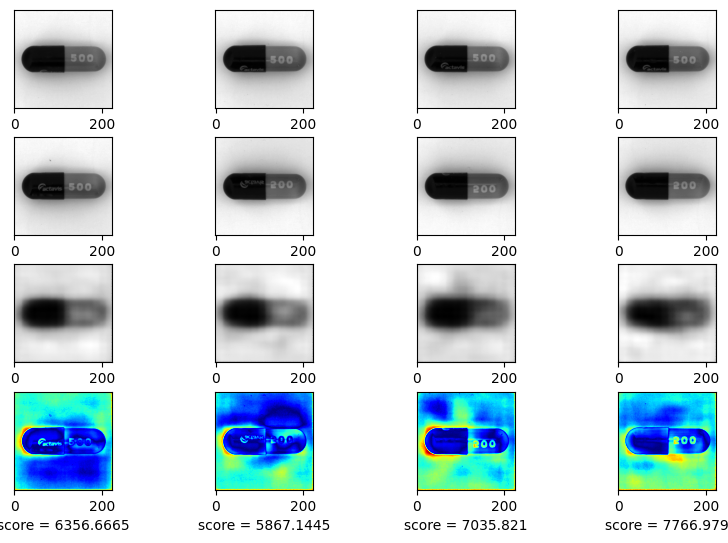

EPOCH 16/150
	 partial train loss (single batch): 3.285617
	 partial train loss (single batch): 2.884283
	 partial train loss (single batch): 2.429958
	 partial train loss (single batch): 3.855029
	 partial train loss (single batch): 5.066288
	 partial train loss (single batch): 2.635240
	 partial train loss (single batch): 3.184233
	 partial train loss (single batch): 2.944870
	 partial train loss (single batch): 3.131950
	 partial train loss (single batch): 2.659767
	 partial train loss (single batch): 2.415573
	 partial train loss (single batch): 3.713282
	 partial train loss (single batch): 2.901913
	 partial train loss (single batch): 5.230857
	 partial train loss (single batch): 3.449374
	 partial train loss (single batch): 4.954294
	 partial train loss (single batch): 3.284808
	 partial train loss (single batch): 4.730756
	 partial train loss (single batch): 5.563586
	 partial train loss (single batch): 4.422242
	 partial train loss (single batch): 5.471822
	 partial train loss 

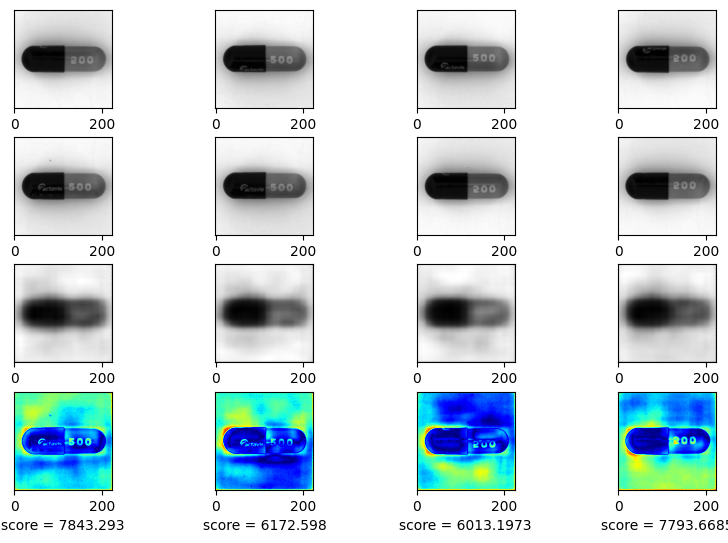

EPOCH 17/150
	 partial train loss (single batch): 7.594462
	 partial train loss (single batch): 3.243528
	 partial train loss (single batch): 4.947783
	 partial train loss (single batch): 3.287696
	 partial train loss (single batch): 6.942531
	 partial train loss (single batch): 5.586205
	 partial train loss (single batch): 3.543997
	 partial train loss (single batch): 4.196622
	 partial train loss (single batch): 3.191198
	 partial train loss (single batch): 3.495080
	 partial train loss (single batch): 4.315594
	 partial train loss (single batch): 4.480018
	 partial train loss (single batch): 3.576903
	 partial train loss (single batch): 3.073136
	 partial train loss (single batch): 2.226373
	 partial train loss (single batch): 3.634125
	 partial train loss (single batch): 3.669083
	 partial train loss (single batch): 2.419353
	 partial train loss (single batch): 4.207249
	 partial train loss (single batch): 3.267629
	 partial train loss (single batch): 2.980449
	 partial train loss 

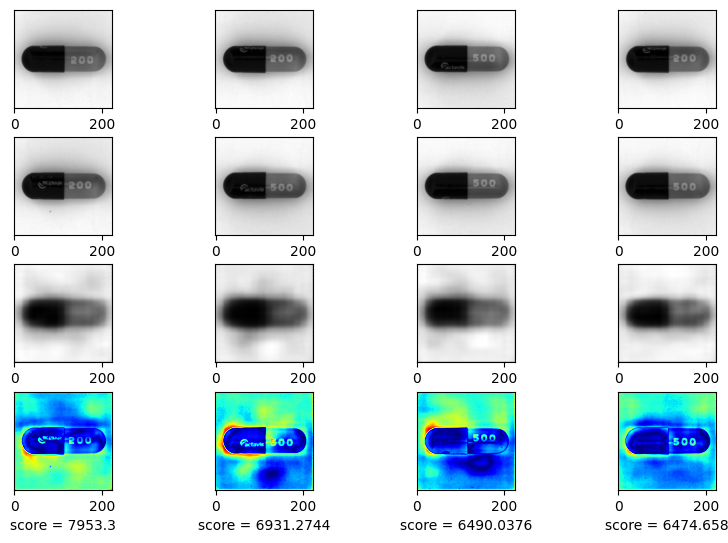

EPOCH 18/150
	 partial train loss (single batch): 3.374197
	 partial train loss (single batch): 3.060083
	 partial train loss (single batch): 3.429621
	 partial train loss (single batch): 5.189205
	 partial train loss (single batch): 6.424448
	 partial train loss (single batch): 3.565815
	 partial train loss (single batch): 2.663852
	 partial train loss (single batch): 4.174421
	 partial train loss (single batch): 3.503936
	 partial train loss (single batch): 3.335925
	 partial train loss (single batch): 3.454071
	 partial train loss (single batch): 4.998033
	 partial train loss (single batch): 4.894648
	 partial train loss (single batch): 2.288811
	 partial train loss (single batch): 3.826346
	 partial train loss (single batch): 2.952997
	 partial train loss (single batch): 4.841328
	 partial train loss (single batch): 2.982215
	 partial train loss (single batch): 4.527026
	 partial train loss (single batch): 5.161256
	 partial train loss (single batch): 3.838968
	 partial train loss 

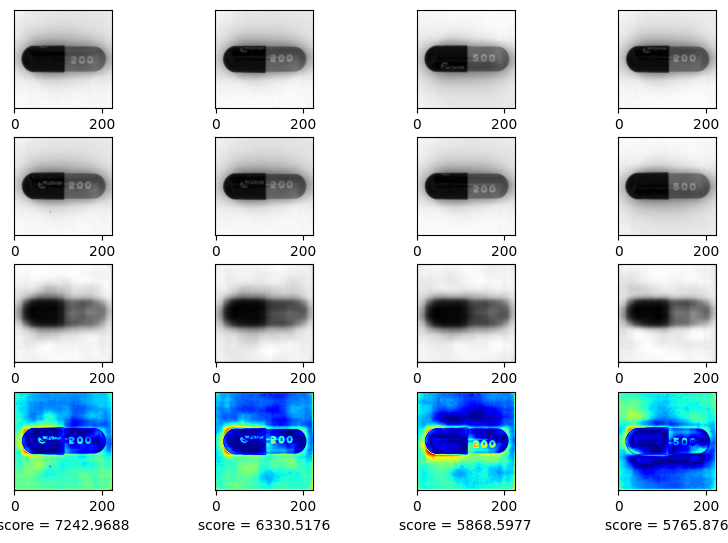

EPOCH 19/150
	 partial train loss (single batch): 1.924062
	 partial train loss (single batch): 5.206656
	 partial train loss (single batch): 3.150754
	 partial train loss (single batch): 3.130779
	 partial train loss (single batch): 6.505987
	 partial train loss (single batch): 4.200999
	 partial train loss (single batch): 3.683878
	 partial train loss (single batch): 8.597234
	 partial train loss (single batch): 6.452741
	 partial train loss (single batch): 4.561532
	 partial train loss (single batch): 4.858687
	 partial train loss (single batch): 3.955723
	 partial train loss (single batch): 2.749570
	 partial train loss (single batch): 3.536363
	 partial train loss (single batch): 2.209497
	 partial train loss (single batch): 3.744492
	 partial train loss (single batch): 2.502048
	 partial train loss (single batch): 5.190080
	 partial train loss (single batch): 2.756618
	 partial train loss (single batch): 5.955762
	 partial train loss (single batch): 7.712926
	 partial train loss 

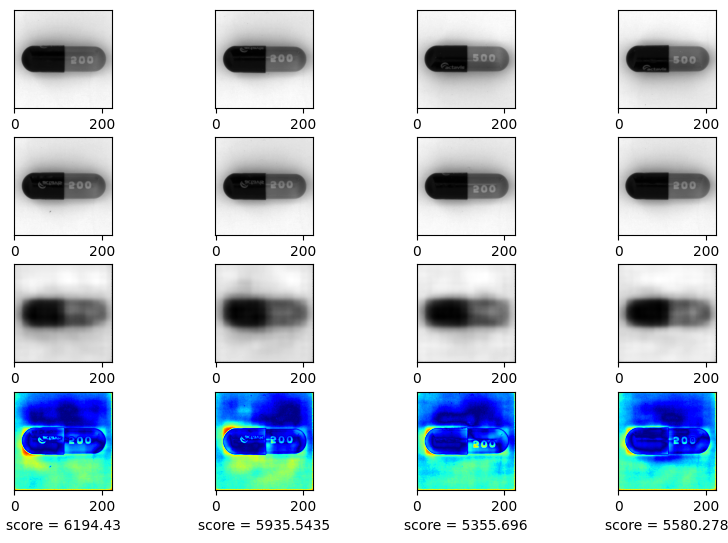

EPOCH 20/150
	 partial train loss (single batch): 8.450965
	 partial train loss (single batch): 4.416254
	 partial train loss (single batch): 5.175863
	 partial train loss (single batch): 3.468917
	 partial train loss (single batch): 4.512077
	 partial train loss (single batch): 5.044421
	 partial train loss (single batch): 2.715278
	 partial train loss (single batch): 5.134981
	 partial train loss (single batch): 2.360816
	 partial train loss (single batch): 4.725426
	 partial train loss (single batch): 4.657320
	 partial train loss (single batch): 2.603700
	 partial train loss (single batch): 3.379548
	 partial train loss (single batch): 3.608590
	 partial train loss (single batch): 2.567826
	 partial train loss (single batch): 4.844320
	 partial train loss (single batch): 2.492081
	 partial train loss (single batch): 7.201622
	 partial train loss (single batch): 5.758579
	 partial train loss (single batch): 3.158248
	 partial train loss (single batch): 5.992420
	 partial train loss 

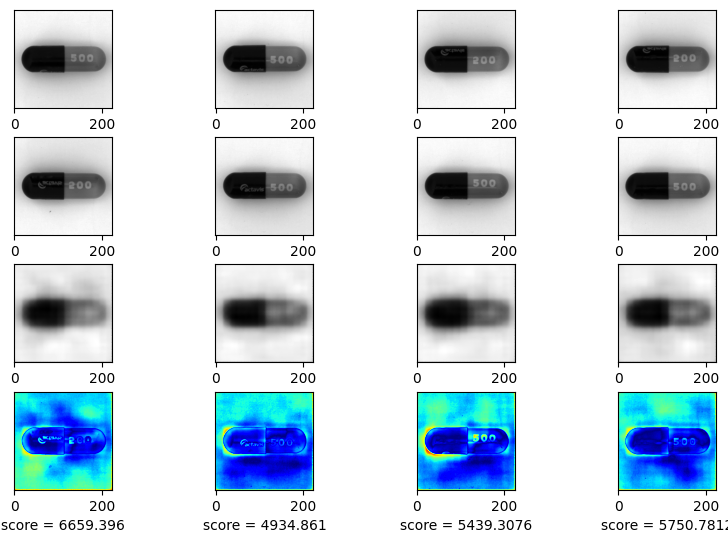

EPOCH 21/150
	 partial train loss (single batch): 7.452236
	 partial train loss (single batch): 4.094314
	 partial train loss (single batch): 3.646051
	 partial train loss (single batch): 3.969697
	 partial train loss (single batch): 3.237046
	 partial train loss (single batch): 6.577188
	 partial train loss (single batch): 6.093289
	 partial train loss (single batch): 6.842782
	 partial train loss (single batch): 5.229572
	 partial train loss (single batch): 4.818505
	 partial train loss (single batch): 8.629996
	 partial train loss (single batch): 3.373540
	 partial train loss (single batch): 3.779525
	 partial train loss (single batch): 3.376513
	 partial train loss (single batch): 4.631794
	 partial train loss (single batch): 6.041117
	 partial train loss (single batch): 2.733910
	 partial train loss (single batch): 5.845880
	 partial train loss (single batch): 6.695325
	 partial train loss (single batch): 2.340688
	 partial train loss (single batch): 8.699338
	 partial train loss 

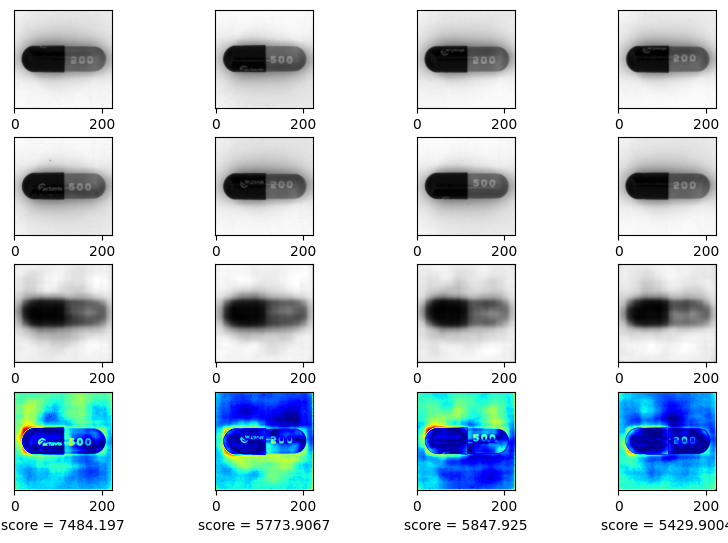

EPOCH 22/150
	 partial train loss (single batch): 5.469568
	 partial train loss (single batch): 14.869690
	 partial train loss (single batch): 9.050608
	 partial train loss (single batch): 3.782945
	 partial train loss (single batch): 9.657074
	 partial train loss (single batch): 6.438358
	 partial train loss (single batch): 3.649461
	 partial train loss (single batch): 14.114337
	 partial train loss (single batch): 3.977707
	 partial train loss (single batch): 7.096799
	 partial train loss (single batch): 13.079264
	 partial train loss (single batch): 3.932532
	 partial train loss (single batch): 4.199521
	 partial train loss (single batch): 5.635578
	 partial train loss (single batch): 2.606197
	 partial train loss (single batch): 4.635671
	 partial train loss (single batch): 4.709001
	 partial train loss (single batch): 2.291323
	 partial train loss (single batch): 4.703755
	 partial train loss (single batch): 2.393513
	 partial train loss (single batch): 4.291541
	 partial train lo

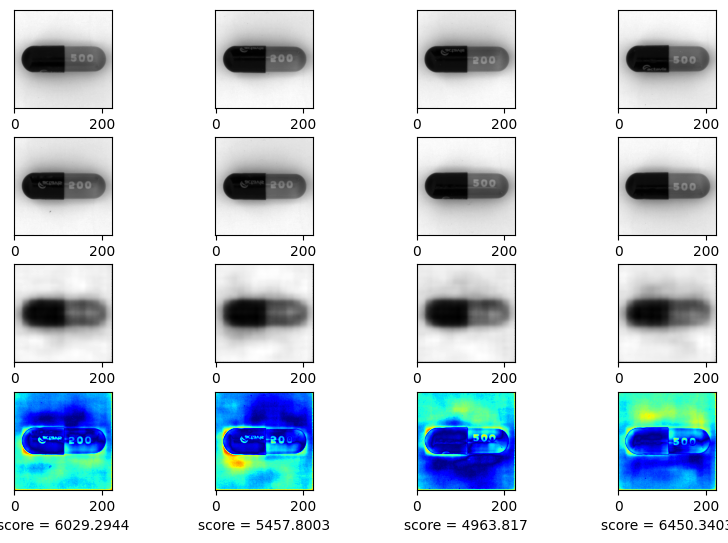

EPOCH 23/150
	 partial train loss (single batch): 3.735839
	 partial train loss (single batch): 5.087217
	 partial train loss (single batch): 2.372684
	 partial train loss (single batch): 7.556568
	 partial train loss (single batch): 7.779843
	 partial train loss (single batch): 3.920900
	 partial train loss (single batch): 4.272377
	 partial train loss (single batch): 5.493896
	 partial train loss (single batch): 2.823164
	 partial train loss (single batch): 2.600502
	 partial train loss (single batch): 2.806574
	 partial train loss (single batch): 4.211193
	 partial train loss (single batch): 3.828232
	 partial train loss (single batch): 4.177463
	 partial train loss (single batch): 2.382906
	 partial train loss (single batch): 3.198224
	 partial train loss (single batch): 3.555267
	 partial train loss (single batch): 3.745828
	 partial train loss (single batch): 2.400423
	 partial train loss (single batch): 2.691636
	 partial train loss (single batch): 3.463745
	 partial train loss 

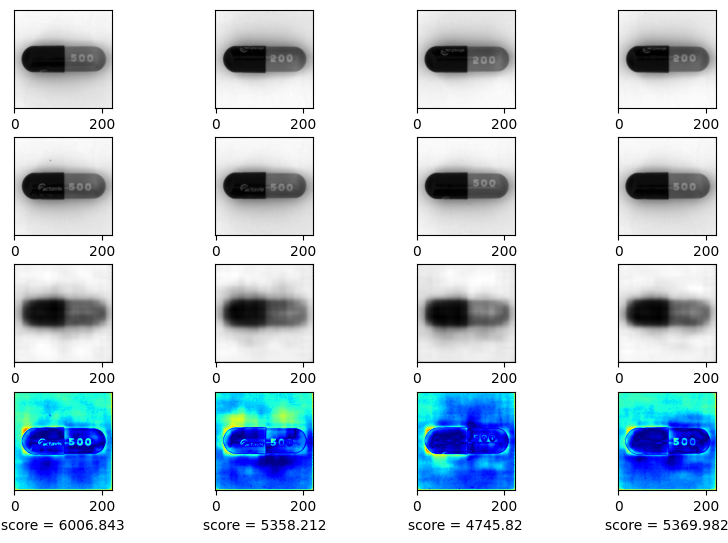

EPOCH 24/150
	 partial train loss (single batch): 2.267984
	 partial train loss (single batch): 2.436421
	 partial train loss (single batch): 3.841718
	 partial train loss (single batch): 2.246336
	 partial train loss (single batch): 3.699756
	 partial train loss (single batch): 3.436483
	 partial train loss (single batch): 2.036302
	 partial train loss (single batch): 4.118047
	 partial train loss (single batch): 4.214189
	 partial train loss (single batch): 2.406337
	 partial train loss (single batch): 2.410093
	 partial train loss (single batch): 3.015434
	 partial train loss (single batch): 2.060642
	 partial train loss (single batch): 3.147882
	 partial train loss (single batch): 3.483262
	 partial train loss (single batch): 2.672508
	 partial train loss (single batch): 3.630332
	 partial train loss (single batch): 3.385267
	 partial train loss (single batch): 2.099814
	 partial train loss (single batch): 4.251133
	 partial train loss (single batch): 4.459334
	 partial train loss 

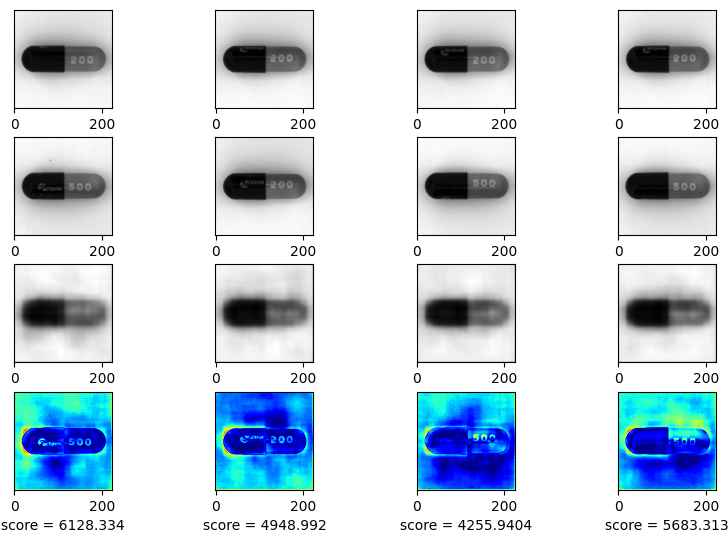

EPOCH 25/150
	 partial train loss (single batch): 3.533722
	 partial train loss (single batch): 3.372519
	 partial train loss (single batch): 3.201607
	 partial train loss (single batch): 6.102435
	 partial train loss (single batch): 5.216804
	 partial train loss (single batch): 2.433707
	 partial train loss (single batch): 3.488937
	 partial train loss (single batch): 5.009699
	 partial train loss (single batch): 2.776533
	 partial train loss (single batch): 2.537729
	 partial train loss (single batch): 5.639363
	 partial train loss (single batch): 4.871649
	 partial train loss (single batch): 3.247582
	 partial train loss (single batch): 2.007968
	 partial train loss (single batch): 1.992587
	 partial train loss (single batch): 2.791793
	 partial train loss (single batch): 2.183709
	 partial train loss (single batch): 2.282321
	 partial train loss (single batch): 2.696875
	 partial train loss (single batch): 1.913708
	 partial train loss (single batch): 4.003251
	 partial train loss 

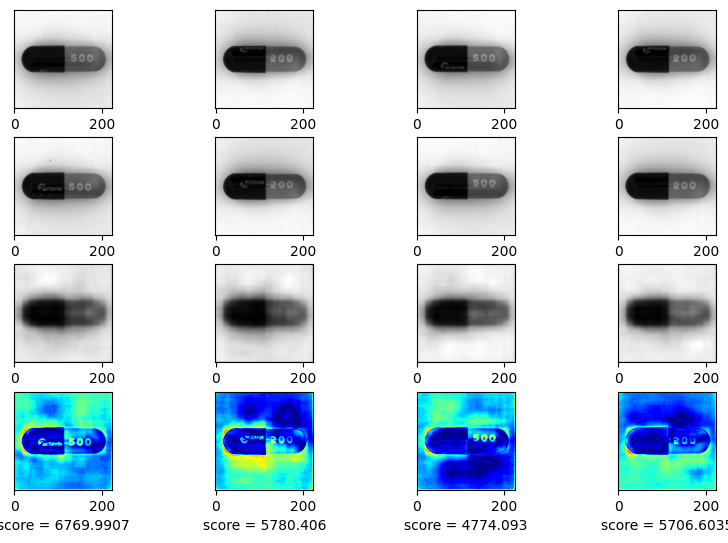

EPOCH 26/150
	 partial train loss (single batch): 1.996639
	 partial train loss (single batch): 4.940112
	 partial train loss (single batch): 4.919605
	 partial train loss (single batch): 1.556871
	 partial train loss (single batch): 4.201439
	 partial train loss (single batch): 5.057615
	 partial train loss (single batch): 2.096092
	 partial train loss (single batch): 2.278147
	 partial train loss (single batch): 4.473984
	 partial train loss (single batch): 3.689147
	 partial train loss (single batch): 2.544744
	 partial train loss (single batch): 4.779095
	 partial train loss (single batch): 3.274386
	 partial train loss (single batch): 2.003716
	 partial train loss (single batch): 3.583876
	 partial train loss (single batch): 4.632957
	 partial train loss (single batch): 2.224303
	 partial train loss (single batch): 4.863214
	 partial train loss (single batch): 7.326574
	 partial train loss (single batch): 2.470869
	 partial train loss (single batch): 9.555715
	 partial train loss 

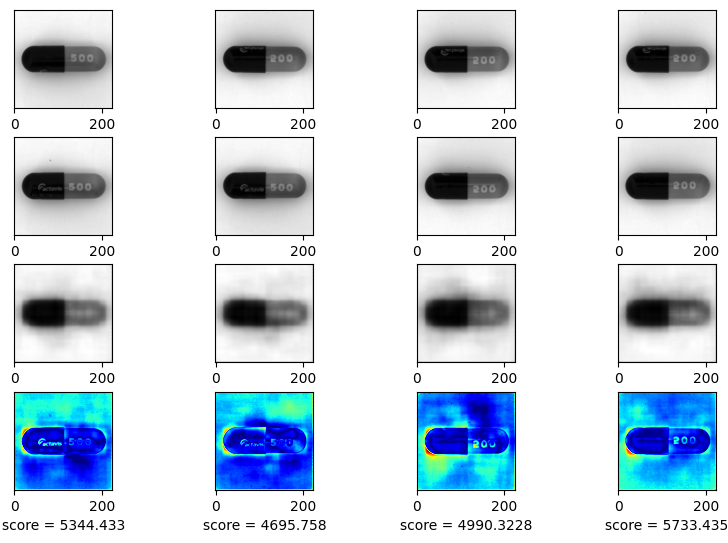

EPOCH 27/150
	 partial train loss (single batch): 3.974585
	 partial train loss (single batch): 9.794513
	 partial train loss (single batch): 6.116658
	 partial train loss (single batch): 4.377561
	 partial train loss (single batch): 5.937407
	 partial train loss (single batch): 6.935055
	 partial train loss (single batch): 3.242552
	 partial train loss (single batch): 3.742773
	 partial train loss (single batch): 6.663767
	 partial train loss (single batch): 2.619022
	 partial train loss (single batch): 6.950309
	 partial train loss (single batch): 11.327755
	 partial train loss (single batch): 3.121308
	 partial train loss (single batch): 9.848853
	 partial train loss (single batch): 16.541254
	 partial train loss (single batch): 3.835810
	 partial train loss (single batch): 6.993405
	 partial train loss (single batch): 8.757733
	 partial train loss (single batch): 5.112523
	 partial train loss (single batch): 4.727672
	 partial train loss (single batch): 7.095050
	 partial train los

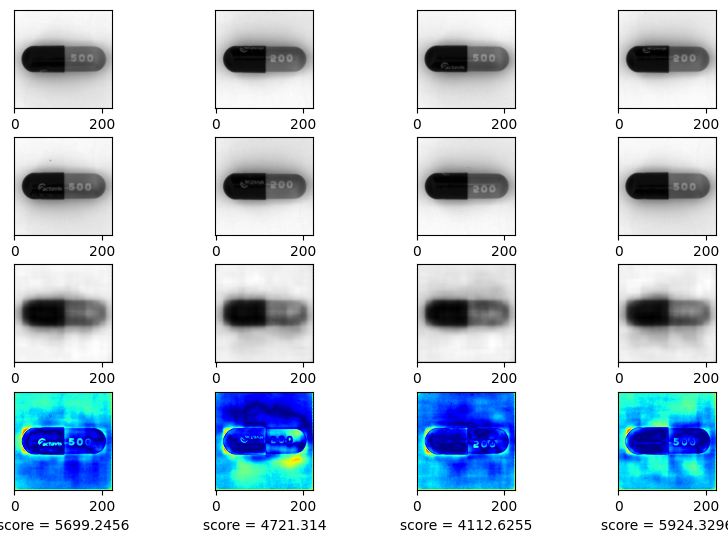

EPOCH 28/150
	 partial train loss (single batch): 2.831632
	 partial train loss (single batch): 6.166387
	 partial train loss (single batch): 4.530392
	 partial train loss (single batch): 11.798974
	 partial train loss (single batch): 6.681042
	 partial train loss (single batch): 2.471616
	 partial train loss (single batch): 6.322909
	 partial train loss (single batch): 2.960333
	 partial train loss (single batch): 5.363973
	 partial train loss (single batch): 3.597790
	 partial train loss (single batch): 8.786720
	 partial train loss (single batch): 5.526284
	 partial train loss (single batch): 3.154496
	 partial train loss (single batch): 8.734397
	 partial train loss (single batch): 3.636692
	 partial train loss (single batch): 3.793310
	 partial train loss (single batch): 6.932618
	 partial train loss (single batch): 10.053198
	 partial train loss (single batch): 8.147291
	 partial train loss (single batch): 2.392101
	 partial train loss (single batch): 4.446012
	 partial train los

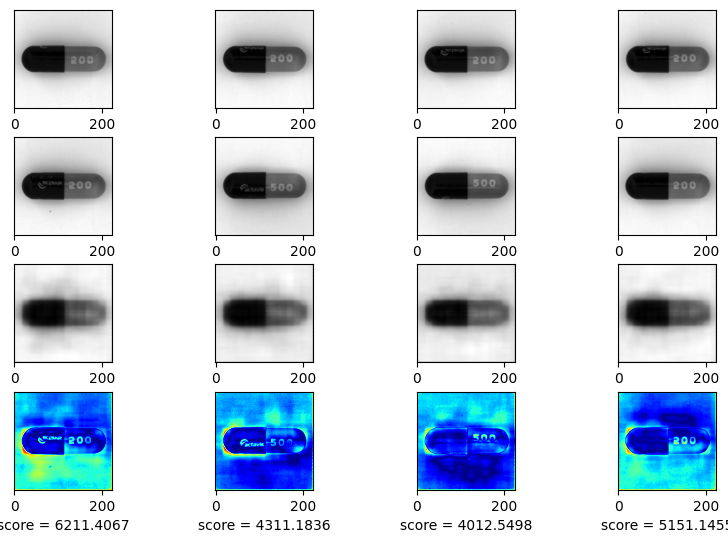

EPOCH 29/150
	 partial train loss (single batch): 3.820473
	 partial train loss (single batch): 6.137897
	 partial train loss (single batch): 2.514344
	 partial train loss (single batch): 3.647388
	 partial train loss (single batch): 3.094661
	 partial train loss (single batch): 2.014401
	 partial train loss (single batch): 3.359248
	 partial train loss (single batch): 1.615252
	 partial train loss (single batch): 3.168280
	 partial train loss (single batch): 2.658981
	 partial train loss (single batch): 2.492458
	 partial train loss (single batch): 2.477544
	 partial train loss (single batch): 1.705119
	 partial train loss (single batch): 3.335650
	 partial train loss (single batch): 3.023417
	 partial train loss (single batch): 1.764305
	 partial train loss (single batch): 4.868470
	 partial train loss (single batch): 1.727911
	 partial train loss (single batch): 6.305921
	 partial train loss (single batch): 9.539148
	 partial train loss (single batch): 5.160366
	 partial train loss 

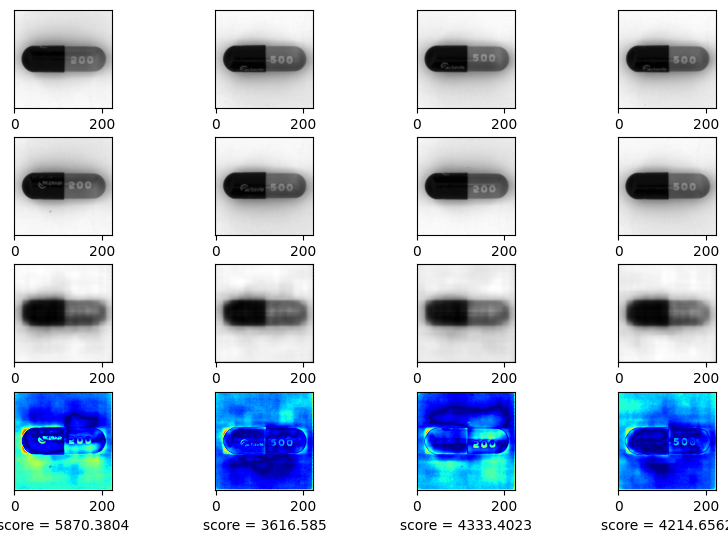

EPOCH 30/150
	 partial train loss (single batch): 1.860324
	 partial train loss (single batch): 5.499628
	 partial train loss (single batch): 6.964599
	 partial train loss (single batch): 3.629044
	 partial train loss (single batch): 4.451712
	 partial train loss (single batch): 3.497118
	 partial train loss (single batch): 3.719450
	 partial train loss (single batch): 4.565077
	 partial train loss (single batch): 2.377340
	 partial train loss (single batch): 2.131417
	 partial train loss (single batch): 2.558614
	 partial train loss (single batch): 1.708285
	 partial train loss (single batch): 3.250079
	 partial train loss (single batch): 4.417610
	 partial train loss (single batch): 1.735322
	 partial train loss (single batch): 4.849797
	 partial train loss (single batch): 7.776242
	 partial train loss (single batch): 3.777900
	 partial train loss (single batch): 3.266523
	 partial train loss (single batch): 2.706270
	 partial train loss (single batch): 3.440452
	 partial train loss 

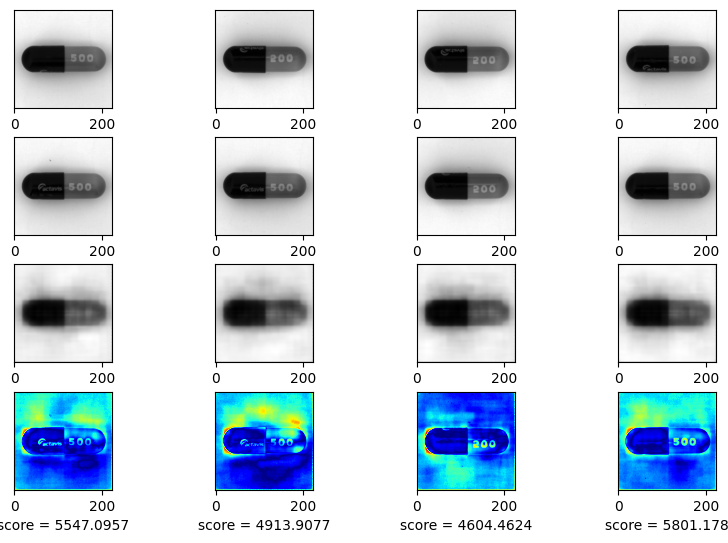

EPOCH 31/150
	 partial train loss (single batch): 2.124768
	 partial train loss (single batch): 3.440219
	 partial train loss (single batch): 2.311064
	 partial train loss (single batch): 3.637672
	 partial train loss (single batch): 3.228089
	 partial train loss (single batch): 3.026774
	 partial train loss (single batch): 8.886124
	 partial train loss (single batch): 10.100672
	 partial train loss (single batch): 6.829898
	 partial train loss (single batch): 5.262284
	 partial train loss (single batch): 4.595158
	 partial train loss (single batch): 6.421939
	 partial train loss (single batch): 3.942967
	 partial train loss (single batch): 1.812603
	 partial train loss (single batch): 4.485975
	 partial train loss (single batch): 2.550345
	 partial train loss (single batch): 3.091640
	 partial train loss (single batch): 3.299296
	 partial train loss (single batch): 3.425512
	 partial train loss (single batch): 3.837602
	 partial train loss (single batch): 2.062007
	 partial train loss

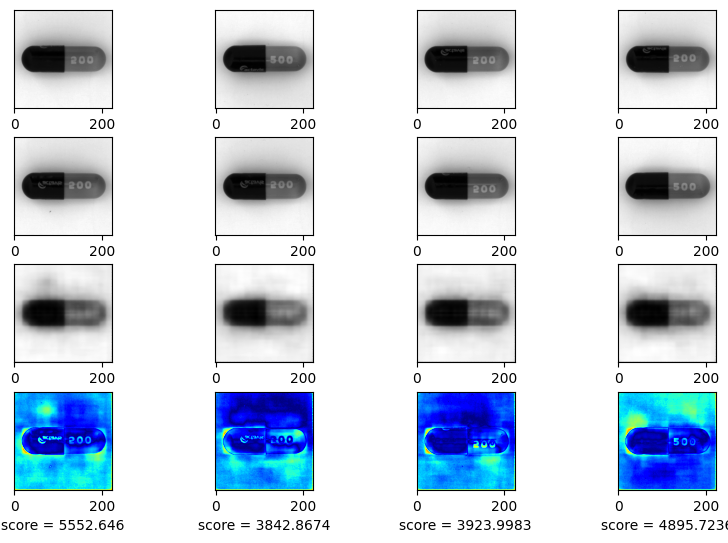

EPOCH 32/150
	 partial train loss (single batch): 4.117863
	 partial train loss (single batch): 2.114286
	 partial train loss (single batch): 2.321034
	 partial train loss (single batch): 2.396064
	 partial train loss (single batch): 1.664106
	 partial train loss (single batch): 3.597631
	 partial train loss (single batch): 4.850705
	 partial train loss (single batch): 3.324503
	 partial train loss (single batch): 1.507277
	 partial train loss (single batch): 3.450341
	 partial train loss (single batch): 4.634022
	 partial train loss (single batch): 2.201027
	 partial train loss (single batch): 3.370473
	 partial train loss (single batch): 9.493475
	 partial train loss (single batch): 9.046576
	 partial train loss (single batch): 3.174599
	 partial train loss (single batch): 4.161723
	 partial train loss (single batch): 8.327768
	 partial train loss (single batch): 7.925012
	 partial train loss (single batch): 2.684115
	 partial train loss (single batch): 5.173373
	 partial train loss 

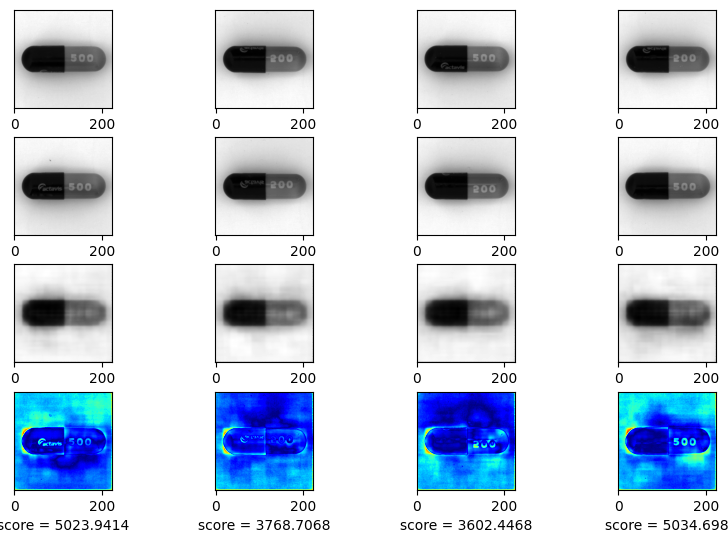

EPOCH 33/150
	 partial train loss (single batch): 5.617890
	 partial train loss (single batch): 4.292325
	 partial train loss (single batch): 7.558849
	 partial train loss (single batch): 4.893787
	 partial train loss (single batch): 2.179661
	 partial train loss (single batch): 3.969364
	 partial train loss (single batch): 9.709778
	 partial train loss (single batch): 12.037679
	 partial train loss (single batch): 4.916615
	 partial train loss (single batch): 2.270299
	 partial train loss (single batch): 8.193126
	 partial train loss (single batch): 10.861219
	 partial train loss (single batch): 5.109560
	 partial train loss (single batch): 2.253901
	 partial train loss (single batch): 8.784254
	 partial train loss (single batch): 11.516708
	 partial train loss (single batch): 4.526593
	 partial train loss (single batch): 2.939215
	 partial train loss (single batch): 14.697818
	 partial train loss (single batch): 18.382420
	 partial train loss (single batch): 10.752802
	 partial train

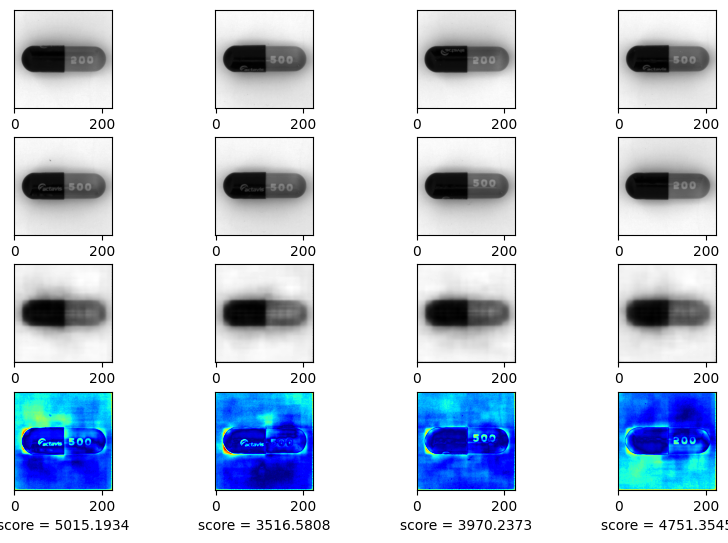

EPOCH 34/150
	 partial train loss (single batch): 6.298384
	 partial train loss (single batch): 13.989671
	 partial train loss (single batch): 8.175311
	 partial train loss (single batch): 3.537376
	 partial train loss (single batch): 5.554493
	 partial train loss (single batch): 9.649884
	 partial train loss (single batch): 9.272223
	 partial train loss (single batch): 2.008069
	 partial train loss (single batch): 4.496940
	 partial train loss (single batch): 8.025132
	 partial train loss (single batch): 3.379768
	 partial train loss (single batch): 3.257709
	 partial train loss (single batch): 11.104348
	 partial train loss (single batch): 10.983538
	 partial train loss (single batch): 5.104727
	 partial train loss (single batch): 3.114999
	 partial train loss (single batch): 7.552235
	 partial train loss (single batch): 6.258192
	 partial train loss (single batch): 2.453575
	 partial train loss (single batch): 2.724691
	 partial train loss (single batch): 3.779168
	 partial train lo

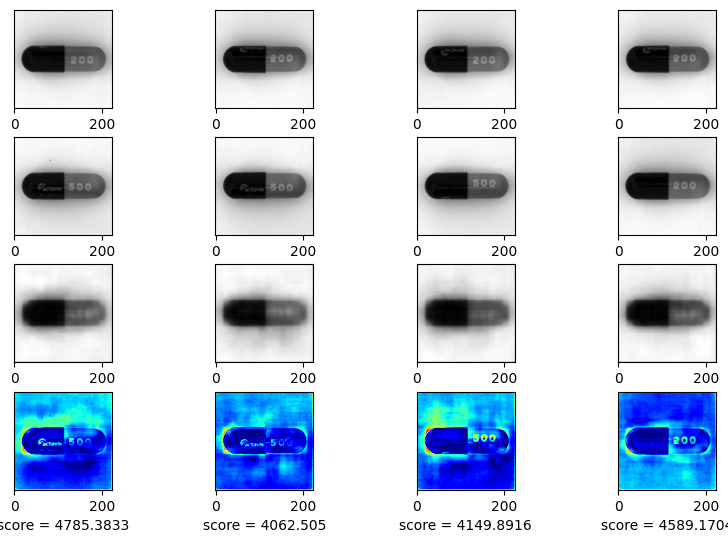

EPOCH 35/150
	 partial train loss (single batch): 4.450569
	 partial train loss (single batch): 4.899391
	 partial train loss (single batch): 3.281328
	 partial train loss (single batch): 1.820205
	 partial train loss (single batch): 2.552324
	 partial train loss (single batch): 4.404587
	 partial train loss (single batch): 2.824787
	 partial train loss (single batch): 3.036955
	 partial train loss (single batch): 5.159414
	 partial train loss (single batch): 8.079500
	 partial train loss (single batch): 10.692577
	 partial train loss (single batch): 4.972682
	 partial train loss (single batch): 2.455759
	 partial train loss (single batch): 11.035995
	 partial train loss (single batch): 14.712248
	 partial train loss (single batch): 10.057026
	 partial train loss (single batch): 4.034111
	 partial train loss (single batch): 3.622579
	 partial train loss (single batch): 12.594906
	 partial train loss (single batch): 16.327692
	 partial train loss (single batch): 6.919656
	 partial train

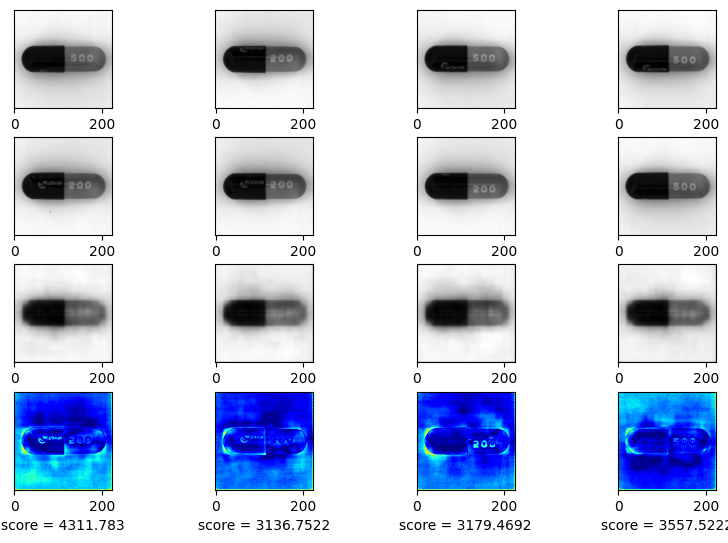

EPOCH 36/150
	 partial train loss (single batch): 16.607191
	 partial train loss (single batch): 25.926146
	 partial train loss (single batch): 19.673756
	 partial train loss (single batch): 4.950659
	 partial train loss (single batch): 3.043169
	 partial train loss (single batch): 6.797748
	 partial train loss (single batch): 4.627686
	 partial train loss (single batch): 4.808984
	 partial train loss (single batch): 4.567205
	 partial train loss (single batch): 3.189612
	 partial train loss (single batch): 3.295001
	 partial train loss (single batch): 3.357018
	 partial train loss (single batch): 4.563536
	 partial train loss (single batch): 3.180553
	 partial train loss (single batch): 5.282109
	 partial train loss (single batch): 8.696173
	 partial train loss (single batch): 7.666729
	 partial train loss (single batch): 1.985824
	 partial train loss (single batch): 2.722959
	 partial train loss (single batch): 5.278258
	 partial train loss (single batch): 3.314368
	 partial train lo

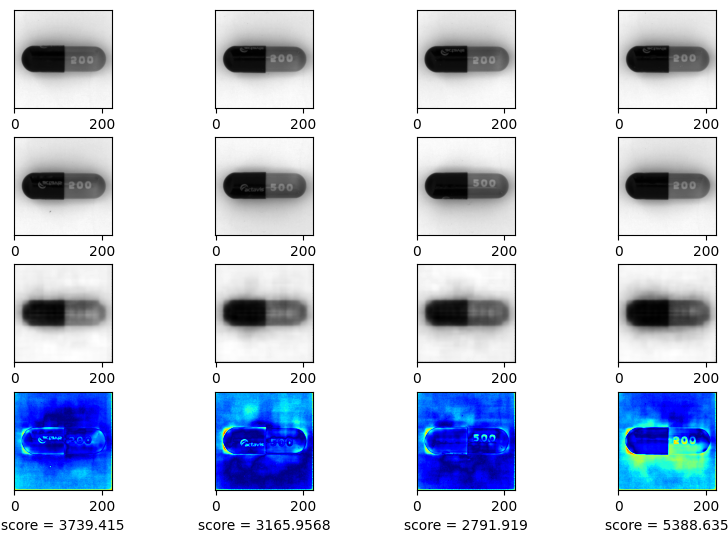

EPOCH 37/150
	 partial train loss (single batch): 4.619604
	 partial train loss (single batch): 5.570686
	 partial train loss (single batch): 3.458522
	 partial train loss (single batch): 2.630231
	 partial train loss (single batch): 5.973206
	 partial train loss (single batch): 6.468199
	 partial train loss (single batch): 1.890693
	 partial train loss (single batch): 3.026109
	 partial train loss (single batch): 3.307818
	 partial train loss (single batch): 1.672589
	 partial train loss (single batch): 3.760132
	 partial train loss (single batch): 1.810576
	 partial train loss (single batch): 4.981688
	 partial train loss (single batch): 10.532033
	 partial train loss (single batch): 3.677301
	 partial train loss (single batch): 9.835436
	 partial train loss (single batch): 23.095684
	 partial train loss (single batch): 22.816916
	 partial train loss (single batch): 13.472677
	 partial train loss (single batch): 5.261928
	 partial train loss (single batch): 4.633187
	 partial train l

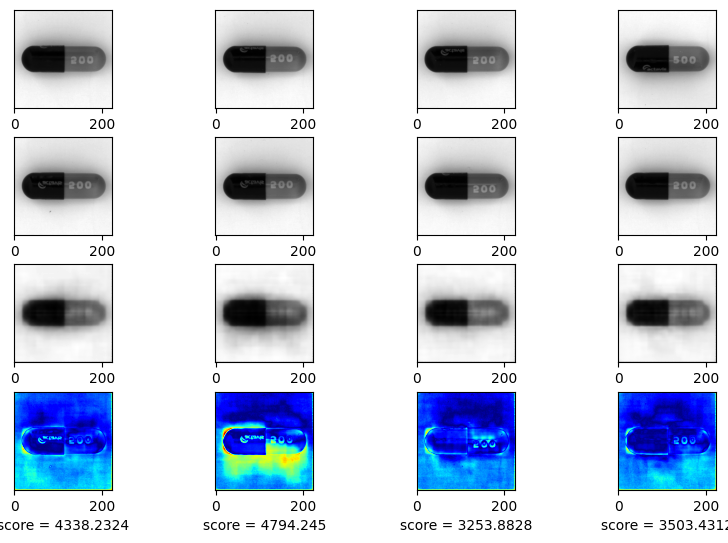

EPOCH 38/150
	 partial train loss (single batch): 5.437770
	 partial train loss (single batch): 2.389017
	 partial train loss (single batch): 8.895544
	 partial train loss (single batch): 9.721090
	 partial train loss (single batch): 5.851475
	 partial train loss (single batch): 2.899142
	 partial train loss (single batch): 2.379707
	 partial train loss (single batch): 5.266681
	 partial train loss (single batch): 4.400131
	 partial train loss (single batch): 1.782142
	 partial train loss (single batch): 3.799458
	 partial train loss (single batch): 3.664270
	 partial train loss (single batch): 1.412959
	 partial train loss (single batch): 3.012078
	 partial train loss (single batch): 2.487229
	 partial train loss (single batch): 1.668994
	 partial train loss (single batch): 4.243331
	 partial train loss (single batch): 3.571924
	 partial train loss (single batch): 2.996388
	 partial train loss (single batch): 2.224722
	 partial train loss (single batch): 2.655940
	 partial train loss 

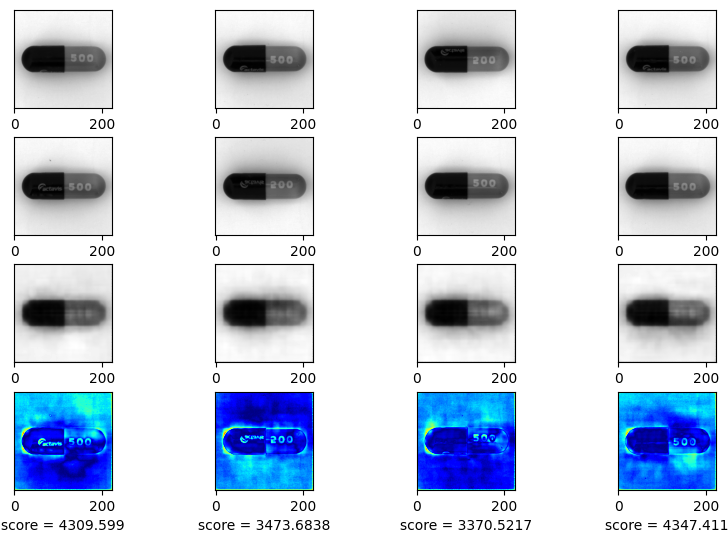

EPOCH 39/150
	 partial train loss (single batch): 3.348273
	 partial train loss (single batch): 3.731488
	 partial train loss (single batch): 5.827414
	 partial train loss (single batch): 8.160226
	 partial train loss (single batch): 8.166694
	 partial train loss (single batch): 5.666367
	 partial train loss (single batch): 7.543978
	 partial train loss (single batch): 4.344651
	 partial train loss (single batch): 1.583982
	 partial train loss (single batch): 6.116953
	 partial train loss (single batch): 5.920819
	 partial train loss (single batch): 4.170835
	 partial train loss (single batch): 2.761583
	 partial train loss (single batch): 2.536422
	 partial train loss (single batch): 2.349368
	 partial train loss (single batch): 2.019977
	 partial train loss (single batch): 3.224524
	 partial train loss (single batch): 2.910360
	 partial train loss (single batch): 1.617265
	 partial train loss (single batch): 4.077597
	 partial train loss (single batch): 8.253673
	 partial train loss 

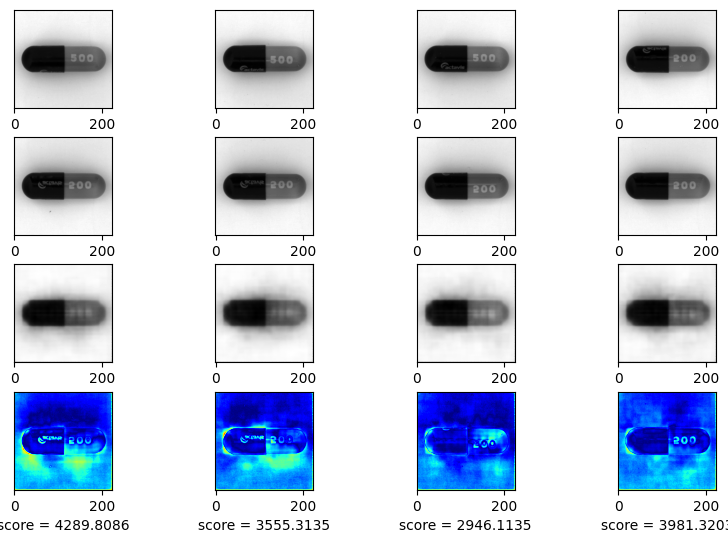

EPOCH 40/150
	 partial train loss (single batch): 1.774456
	 partial train loss (single batch): 7.363391
	 partial train loss (single batch): 11.038944
	 partial train loss (single batch): 7.894506
	 partial train loss (single batch): 3.079838
	 partial train loss (single batch): 1.894407
	 partial train loss (single batch): 2.808879
	 partial train loss (single batch): 4.729887
	 partial train loss (single batch): 8.343437
	 partial train loss (single batch): 6.696494
	 partial train loss (single batch): 2.591332
	 partial train loss (single batch): 18.394661
	 partial train loss (single batch): 47.233723
	 partial train loss (single batch): 36.073883
	 partial train loss (single batch): 11.673752
	 partial train loss (single batch): 5.009477
	 partial train loss (single batch): 23.414948
	 partial train loss (single batch): 38.112312
	 partial train loss (single batch): 18.858418
	 partial train loss (single batch): 2.327469
	 partial train loss (single batch): 8.661270
	 partial tra

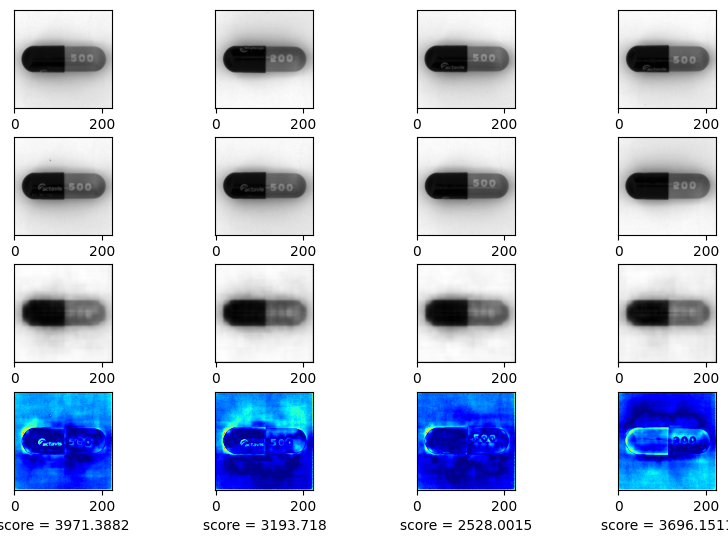

EPOCH 41/150
	 partial train loss (single batch): 11.784180
	 partial train loss (single batch): 1.938618
	 partial train loss (single batch): 12.236673
	 partial train loss (single batch): 28.710903
	 partial train loss (single batch): 15.831009
	 partial train loss (single batch): 5.197019
	 partial train loss (single batch): 6.311983
	 partial train loss (single batch): 14.797825
	 partial train loss (single batch): 19.671516
	 partial train loss (single batch): 9.178230
	 partial train loss (single batch): 2.152712
	 partial train loss (single batch): 10.041832
	 partial train loss (single batch): 19.573448
	 partial train loss (single batch): 16.642254
	 partial train loss (single batch): 5.424383
	 partial train loss (single batch): 3.824889
	 partial train loss (single batch): 7.534086
	 partial train loss (single batch): 6.466121
	 partial train loss (single batch): 2.883433
	 partial train loss (single batch): 3.805409
	 partial train loss (single batch): 8.249710
	 partial tr

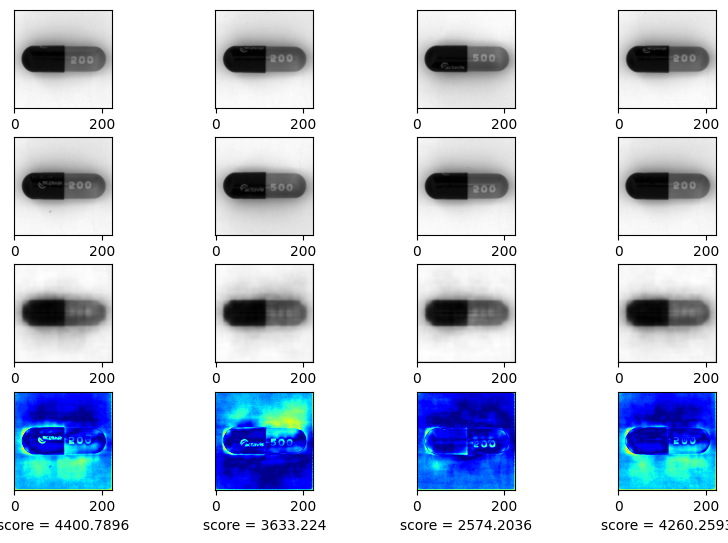

EPOCH 42/150
	 partial train loss (single batch): 4.765728
	 partial train loss (single batch): 1.965803
	 partial train loss (single batch): 2.356317
	 partial train loss (single batch): 2.984803
	 partial train loss (single batch): 1.701151
	 partial train loss (single batch): 2.290105
	 partial train loss (single batch): 4.236427
	 partial train loss (single batch): 5.386191
	 partial train loss (single batch): 3.965557
	 partial train loss (single batch): 2.158446
	 partial train loss (single batch): 2.087143
	 partial train loss (single batch): 2.750653
	 partial train loss (single batch): 3.944318
	 partial train loss (single batch): 2.808903
	 partial train loss (single batch): 2.922212
	 partial train loss (single batch): 2.599313
	 partial train loss (single batch): 2.346835
	 partial train loss (single batch): 4.643732
	 partial train loss (single batch): 4.114058
	 partial train loss (single batch): 4.360738
	 partial train loss (single batch): 7.154516
	 partial train loss 

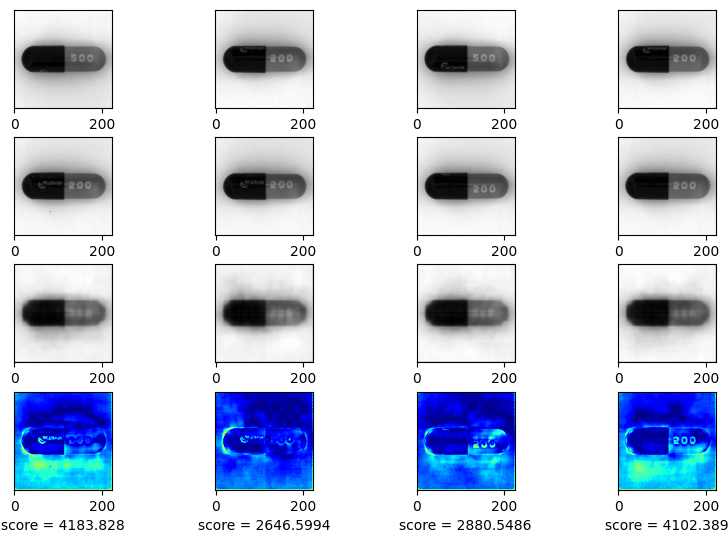

EPOCH 43/150
	 partial train loss (single batch): 3.130925
	 partial train loss (single batch): 7.750132
	 partial train loss (single batch): 5.283793
	 partial train loss (single batch): 2.584381
	 partial train loss (single batch): 6.291881
	 partial train loss (single batch): 4.530926
	 partial train loss (single batch): 4.815623
	 partial train loss (single batch): 11.729326
	 partial train loss (single batch): 5.897624
	 partial train loss (single batch): 6.522173
	 partial train loss (single batch): 8.090135
	 partial train loss (single batch): 2.794645
	 partial train loss (single batch): 3.923992
	 partial train loss (single batch): 5.155038
	 partial train loss (single batch): 2.367864
	 partial train loss (single batch): 5.542941
	 partial train loss (single batch): 4.159752
	 partial train loss (single batch): 2.118165
	 partial train loss (single batch): 3.821243
	 partial train loss (single batch): 4.094304
	 partial train loss (single batch): 2.747925
	 partial train loss

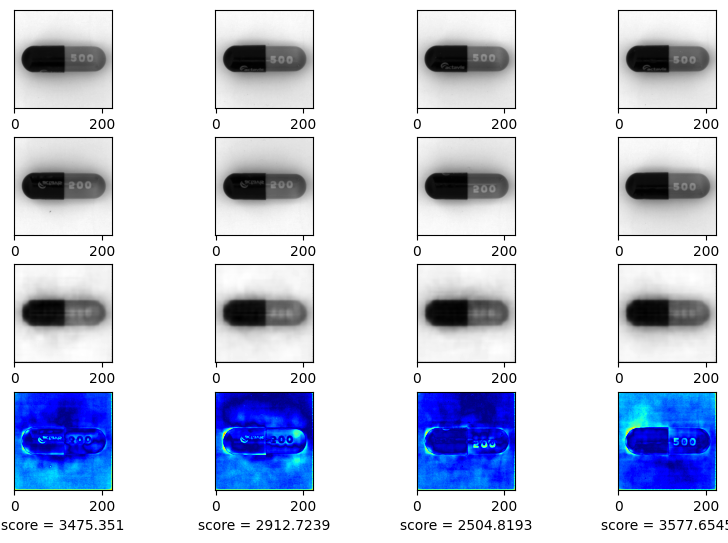

EPOCH 44/150
	 partial train loss (single batch): 2.378574
	 partial train loss (single batch): 2.381404
	 partial train loss (single batch): 3.403303
	 partial train loss (single batch): 2.961834
	 partial train loss (single batch): 3.740887
	 partial train loss (single batch): 4.438533
	 partial train loss (single batch): 1.874905
	 partial train loss (single batch): 3.608271
	 partial train loss (single batch): 3.680432
	 partial train loss (single batch): 1.427393
	 partial train loss (single batch): 2.124328
	 partial train loss (single batch): 1.803847
	 partial train loss (single batch): 1.735035
	 partial train loss (single batch): 1.610249
	 partial train loss (single batch): 1.269370
	 partial train loss (single batch): 2.092178
	 partial train loss (single batch): 1.887052
	 partial train loss (single batch): 1.624173
	 partial train loss (single batch): 2.786139
	 partial train loss (single batch): 2.848748
	 partial train loss (single batch): 1.293991
	 partial train loss 

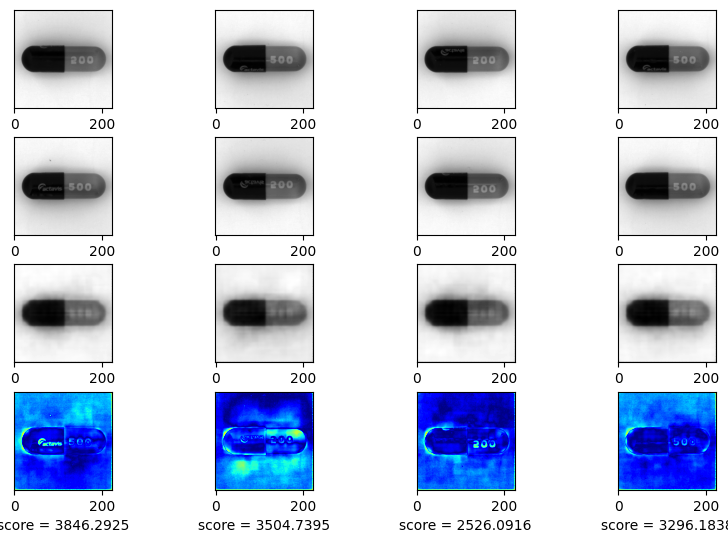

EPOCH 45/150
	 partial train loss (single batch): 2.128624
	 partial train loss (single batch): 1.957933
	 partial train loss (single batch): 2.580817
	 partial train loss (single batch): 3.118083
	 partial train loss (single batch): 2.580226
	 partial train loss (single batch): 1.678625
	 partial train loss (single batch): 1.634989
	 partial train loss (single batch): 2.686785
	 partial train loss (single batch): 3.033119
	 partial train loss (single batch): 1.457714
	 partial train loss (single batch): 1.466787
	 partial train loss (single batch): 3.833248
	 partial train loss (single batch): 6.012374
	 partial train loss (single batch): 5.730956
	 partial train loss (single batch): 2.244386
	 partial train loss (single batch): 1.391245
	 partial train loss (single batch): 2.108690
	 partial train loss (single batch): 2.151753
	 partial train loss (single batch): 2.056861
	 partial train loss (single batch): 7.779676
	 partial train loss (single batch): 12.788572
	 partial train loss

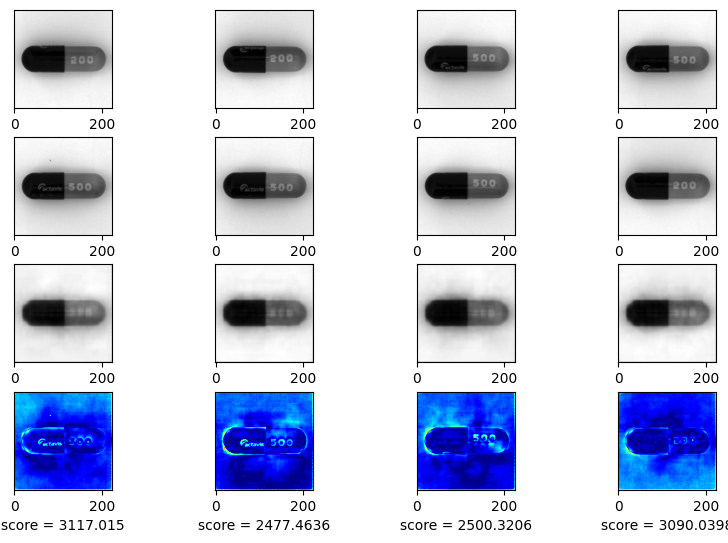

EPOCH 46/150
	 partial train loss (single batch): 1.722318
	 partial train loss (single batch): 13.930490
	 partial train loss (single batch): 31.093328
	 partial train loss (single batch): 26.214989
	 partial train loss (single batch): 11.794594
	 partial train loss (single batch): 2.049677
	 partial train loss (single batch): 16.884182
	 partial train loss (single batch): 44.483002
	 partial train loss (single batch): 37.944084
	 partial train loss (single batch): 14.046383
	 partial train loss (single batch): 1.870246
	 partial train loss (single batch): 10.175718
	 partial train loss (single batch): 18.006285
	 partial train loss (single batch): 12.531281
	 partial train loss (single batch): 4.131286
	 partial train loss (single batch): 2.587901
	 partial train loss (single batch): 11.038658
	 partial train loss (single batch): 15.555379
	 partial train loss (single batch): 7.976562
	 partial train loss (single batch): 3.594594
	 partial train loss (single batch): 7.161381
	 partia

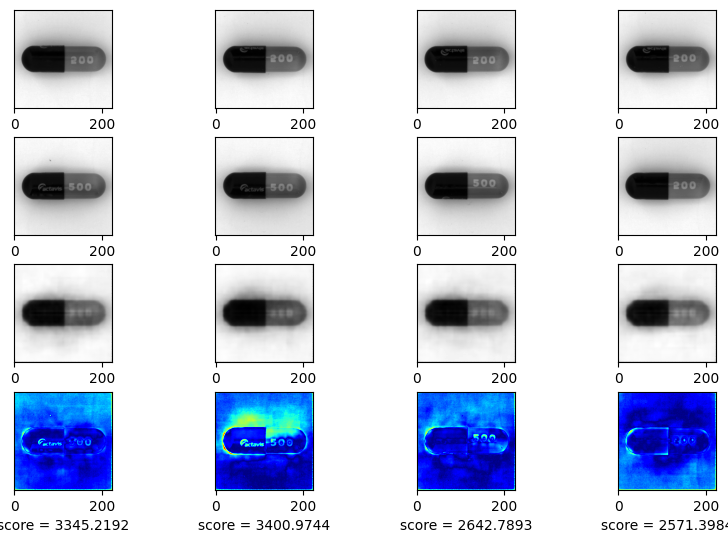

EPOCH 47/150
	 partial train loss (single batch): 3.376458
	 partial train loss (single batch): 3.164298
	 partial train loss (single batch): 3.506310
	 partial train loss (single batch): 4.132037
	 partial train loss (single batch): 4.439760
	 partial train loss (single batch): 2.145607
	 partial train loss (single batch): 2.085336
	 partial train loss (single batch): 7.023352
	 partial train loss (single batch): 10.894322
	 partial train loss (single batch): 9.422001
	 partial train loss (single batch): 6.307512
	 partial train loss (single batch): 1.950709
	 partial train loss (single batch): 2.951744
	 partial train loss (single batch): 7.490242
	 partial train loss (single batch): 7.803104
	 partial train loss (single batch): 5.646508
	 partial train loss (single batch): 3.879858
	 partial train loss (single batch): 3.401648
	 partial train loss (single batch): 10.330073
	 partial train loss (single batch): 9.467686
	 partial train loss (single batch): 2.543609
	 partial train los

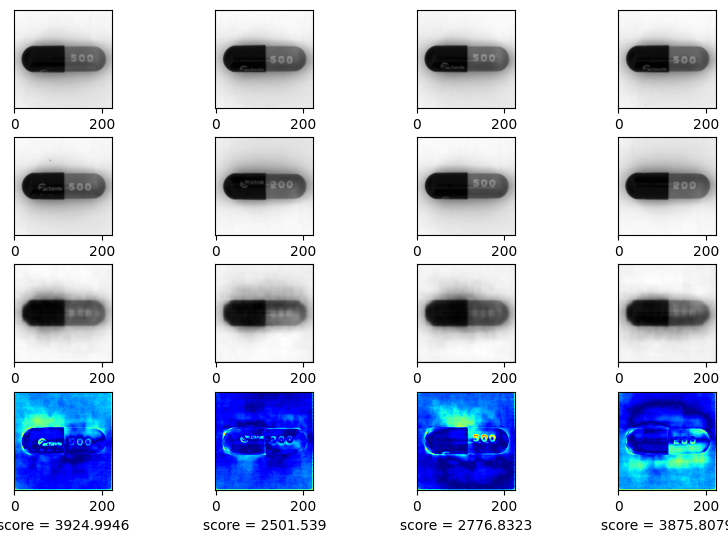

EPOCH 48/150
	 partial train loss (single batch): 6.989704
	 partial train loss (single batch): 6.218171
	 partial train loss (single batch): 6.677742
	 partial train loss (single batch): 4.181720
	 partial train loss (single batch): 4.792398
	 partial train loss (single batch): 11.820391
	 partial train loss (single batch): 11.340957
	 partial train loss (single batch): 9.994674
	 partial train loss (single batch): 13.486424
	 partial train loss (single batch): 9.143238
	 partial train loss (single batch): 2.178499
	 partial train loss (single batch): 11.764517
	 partial train loss (single batch): 16.969273
	 partial train loss (single batch): 3.317395
	 partial train loss (single batch): 7.199268
	 partial train loss (single batch): 19.061577
	 partial train loss (single batch): 10.179264
	 partial train loss (single batch): 6.021681
	 partial train loss (single batch): 5.200721
	 partial train loss (single batch): 12.216685
	 partial train loss (single batch): 22.978376
	 partial tr

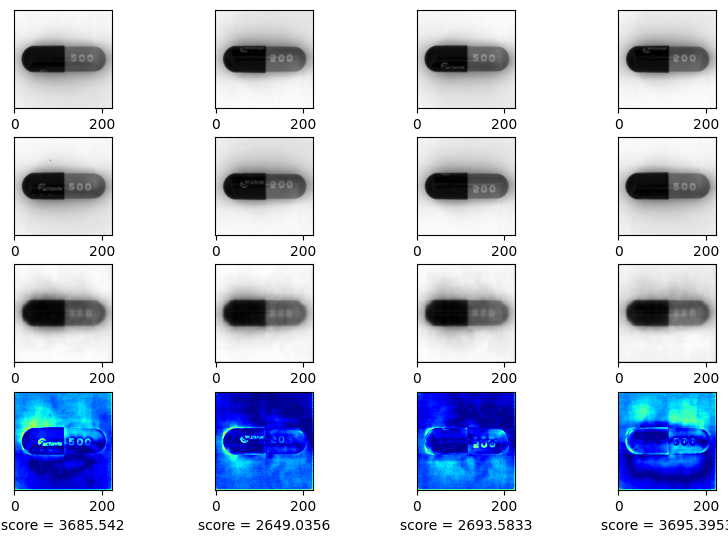

EPOCH 49/150
	 partial train loss (single batch): 1.270487
	 partial train loss (single batch): 12.300371
	 partial train loss (single batch): 24.090849
	 partial train loss (single batch): 23.121828
	 partial train loss (single batch): 6.799106
	 partial train loss (single batch): 3.921026
	 partial train loss (single batch): 14.753337
	 partial train loss (single batch): 15.005097
	 partial train loss (single batch): 8.555235
	 partial train loss (single batch): 2.038585
	 partial train loss (single batch): 2.224473
	 partial train loss (single batch): 6.361469
	 partial train loss (single batch): 6.894624
	 partial train loss (single batch): 2.842651
	 partial train loss (single batch): 1.377852
	 partial train loss (single batch): 6.406650
	 partial train loss (single batch): 10.614582
	 partial train loss (single batch): 5.937759
	 partial train loss (single batch): 1.337994
	 partial train loss (single batch): 3.234094
	 partial train loss (single batch): 5.039384
	 partial train

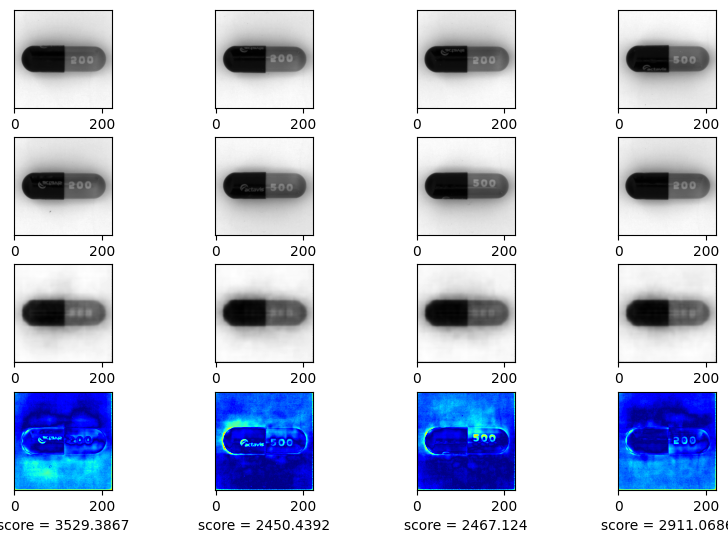

EPOCH 50/150
	 partial train loss (single batch): 1.609914
	 partial train loss (single batch): 3.440306
	 partial train loss (single batch): 2.881307
	 partial train loss (single batch): 2.117482
	 partial train loss (single batch): 6.840384
	 partial train loss (single batch): 5.862158
	 partial train loss (single batch): 2.124078
	 partial train loss (single batch): 8.035723
	 partial train loss (single batch): 20.981857
	 partial train loss (single batch): 20.334755
	 partial train loss (single batch): 6.835834
	 partial train loss (single batch): 2.927624
	 partial train loss (single batch): 23.913389
	 partial train loss (single batch): 43.123707
	 partial train loss (single batch): 14.431012
	 partial train loss (single batch): 1.665519
	 partial train loss (single batch): 12.542821
	 partial train loss (single batch): 20.981741
	 partial train loss (single batch): 22.163303
	 partial train loss (single batch): 9.091461
	 partial train loss (single batch): 1.830001
	 partial tra

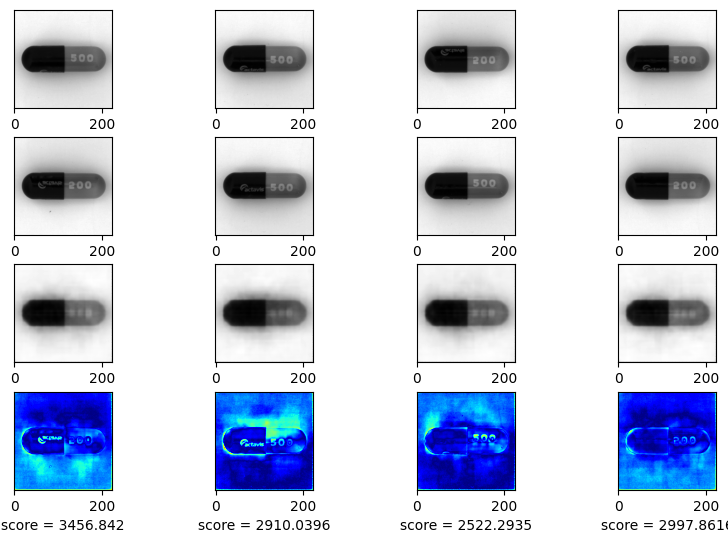

EPOCH 51/150
	 partial train loss (single batch): 1.848212
	 partial train loss (single batch): 3.084731
	 partial train loss (single batch): 5.525176
	 partial train loss (single batch): 5.841351
	 partial train loss (single batch): 3.455323
	 partial train loss (single batch): 1.624180
	 partial train loss (single batch): 1.229296
	 partial train loss (single batch): 1.057775
	 partial train loss (single batch): 1.293812
	 partial train loss (single batch): 1.457925
	 partial train loss (single batch): 1.346373
	 partial train loss (single batch): 1.276138
	 partial train loss (single batch): 1.743669
	 partial train loss (single batch): 2.116121
	 partial train loss (single batch): 2.222510
	 partial train loss (single batch): 1.804572
	 partial train loss (single batch): 1.417363
	 partial train loss (single batch): 2.603718
	 partial train loss (single batch): 2.118974
	 partial train loss (single batch): 1.402583
	 partial train loss (single batch): 3.181264
	 partial train loss 

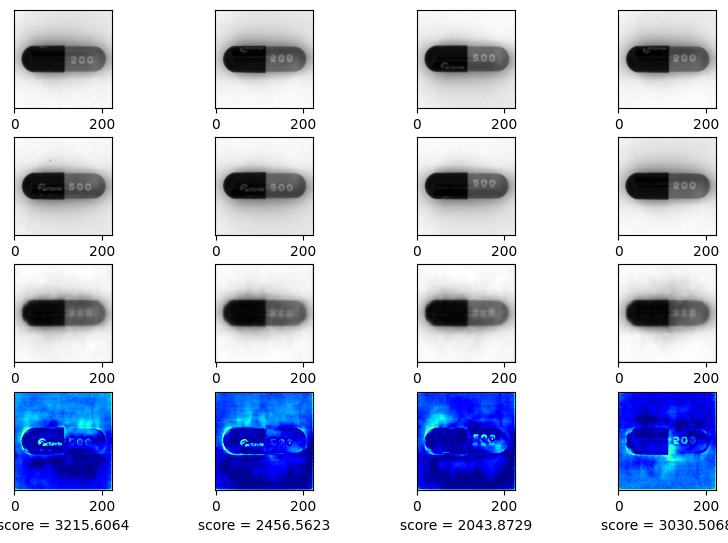

EPOCH 52/150
	 partial train loss (single batch): 1.892437
	 partial train loss (single batch): 1.217153
	 partial train loss (single batch): 3.686915
	 partial train loss (single batch): 5.695302
	 partial train loss (single batch): 4.570953
	 partial train loss (single batch): 2.892452
	 partial train loss (single batch): 2.071884
	 partial train loss (single batch): 1.861786
	 partial train loss (single batch): 1.673411
	 partial train loss (single batch): 1.758509
	 partial train loss (single batch): 1.647116
	 partial train loss (single batch): 1.494587
	 partial train loss (single batch): 1.959842
	 partial train loss (single batch): 2.046152
	 partial train loss (single batch): 0.856375
	 partial train loss (single batch): 1.957372
	 partial train loss (single batch): 2.167430
	 partial train loss (single batch): 1.039838
	 partial train loss (single batch): 1.815734
	 partial train loss (single batch): 2.211476
	 partial train loss (single batch): 1.071470
	 partial train loss 

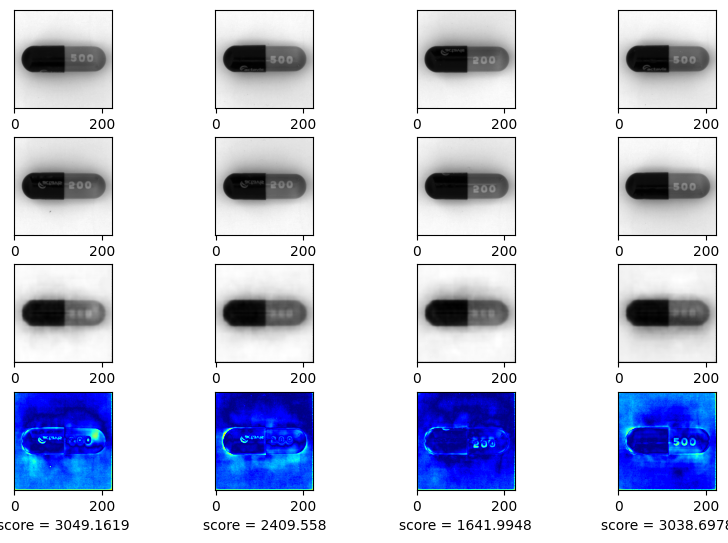

EPOCH 53/150
	 partial train loss (single batch): 2.051068
	 partial train loss (single batch): 1.438204
	 partial train loss (single batch): 1.581344
	 partial train loss (single batch): 2.312645
	 partial train loss (single batch): 2.032515
	 partial train loss (single batch): 2.227702
	 partial train loss (single batch): 1.544259
	 partial train loss (single batch): 2.513777
	 partial train loss (single batch): 4.109716
	 partial train loss (single batch): 1.808443
	 partial train loss (single batch): 1.778331
	 partial train loss (single batch): 2.995832
	 partial train loss (single batch): 1.734687
	 partial train loss (single batch): 1.164784
	 partial train loss (single batch): 1.532874
	 partial train loss (single batch): 1.266115
	 partial train loss (single batch): 1.313903
	 partial train loss (single batch): 1.918313
	 partial train loss (single batch): 2.180728
	 partial train loss (single batch): 1.006128
	 partial train loss (single batch): 1.077850
	 partial train loss 

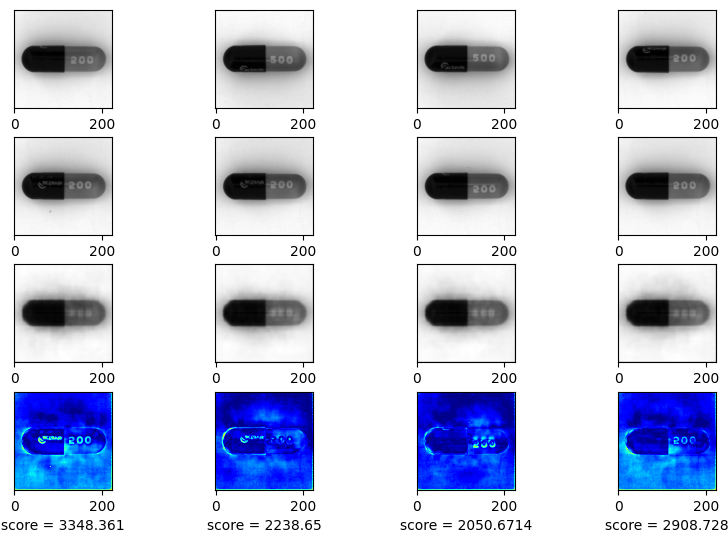

EPOCH 54/150
	 partial train loss (single batch): 1.357934
	 partial train loss (single batch): 1.384876
	 partial train loss (single batch): 1.795154
	 partial train loss (single batch): 1.536422
	 partial train loss (single batch): 1.415655
	 partial train loss (single batch): 0.936832
	 partial train loss (single batch): 1.051093
	 partial train loss (single batch): 2.055474
	 partial train loss (single batch): 2.391162
	 partial train loss (single batch): 1.682708
	 partial train loss (single batch): 1.000158
	 partial train loss (single batch): 1.803776
	 partial train loss (single batch): 4.167357
	 partial train loss (single batch): 6.294665
	 partial train loss (single batch): 4.105671
	 partial train loss (single batch): 1.563512
	 partial train loss (single batch): 2.237669
	 partial train loss (single batch): 2.037723
	 partial train loss (single batch): 0.945071
	 partial train loss (single batch): 1.885020
	 partial train loss (single batch): 2.272235
	 partial train loss 

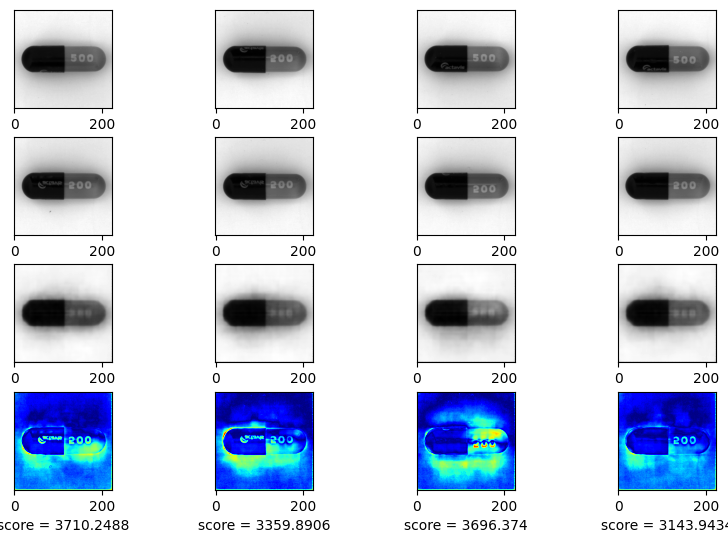

EPOCH 55/150
	 partial train loss (single batch): 2.522249
	 partial train loss (single batch): 3.313901
	 partial train loss (single batch): 2.283067
	 partial train loss (single batch): 1.594746
	 partial train loss (single batch): 2.144417
	 partial train loss (single batch): 4.323059
	 partial train loss (single batch): 3.377365
	 partial train loss (single batch): 1.276468
	 partial train loss (single batch): 1.596065
	 partial train loss (single batch): 3.240116
	 partial train loss (single batch): 3.557608
	 partial train loss (single batch): 2.518054
	 partial train loss (single batch): 1.586871
	 partial train loss (single batch): 1.189104
	 partial train loss (single batch): 1.216533
	 partial train loss (single batch): 1.123275
	 partial train loss (single batch): 1.427697
	 partial train loss (single batch): 1.649466
	 partial train loss (single batch): 1.322948
	 partial train loss (single batch): 1.841510
	 partial train loss (single batch): 2.363848
	 partial train loss 

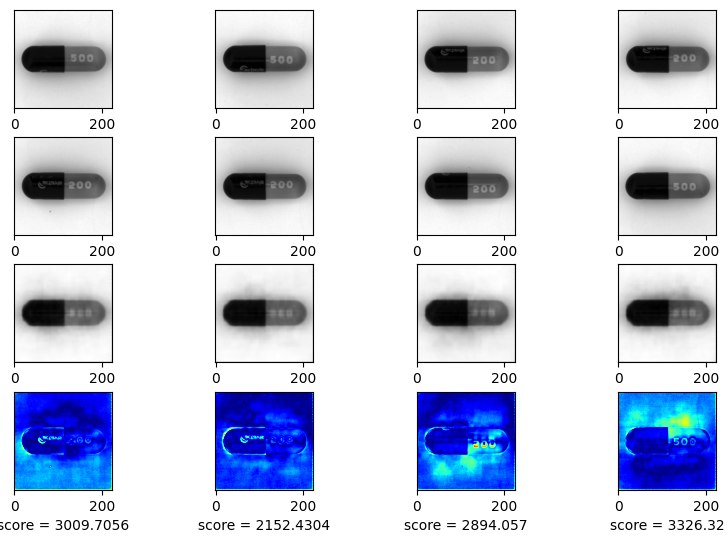

EPOCH 56/150
	 partial train loss (single batch): 1.934620
	 partial train loss (single batch): 5.201194
	 partial train loss (single batch): 7.223253
	 partial train loss (single batch): 6.420228
	 partial train loss (single batch): 3.129462
	 partial train loss (single batch): 1.067549
	 partial train loss (single batch): 4.000280
	 partial train loss (single batch): 7.716191
	 partial train loss (single batch): 6.882671
	 partial train loss (single batch): 3.073455
	 partial train loss (single batch): 1.173689
	 partial train loss (single batch): 1.530577
	 partial train loss (single batch): 2.616628
	 partial train loss (single batch): 3.062279
	 partial train loss (single batch): 2.373887
	 partial train loss (single batch): 1.663944
	 partial train loss (single batch): 1.438895
	 partial train loss (single batch): 1.358542
	 partial train loss (single batch): 1.306362
	 partial train loss (single batch): 1.977000
	 partial train loss (single batch): 1.979093
	 partial train loss 

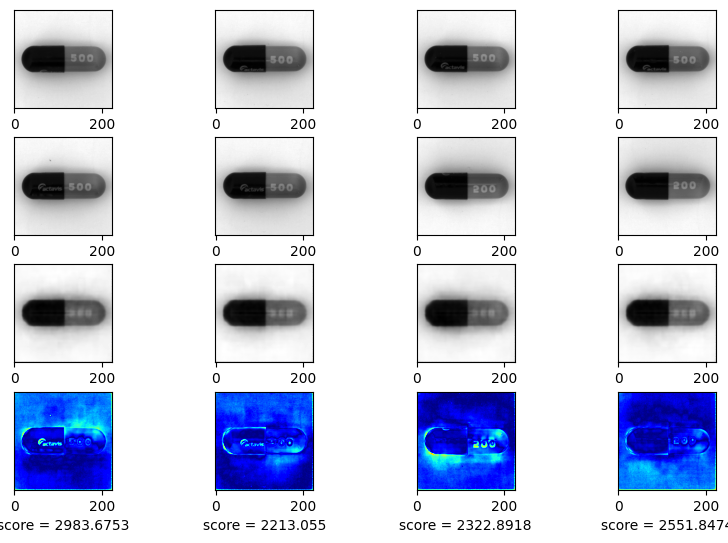

EPOCH 57/150
	 partial train loss (single batch): 1.369824
	 partial train loss (single batch): 1.586363
	 partial train loss (single batch): 1.307438
	 partial train loss (single batch): 1.936170
	 partial train loss (single batch): 3.234044
	 partial train loss (single batch): 3.510070
	 partial train loss (single batch): 3.133905
	 partial train loss (single batch): 4.217597
	 partial train loss (single batch): 2.852856
	 partial train loss (single batch): 1.125026
	 partial train loss (single batch): 2.455330
	 partial train loss (single batch): 4.311756
	 partial train loss (single batch): 4.482165
	 partial train loss (single batch): 3.614799
	 partial train loss (single batch): 2.394170
	 partial train loss (single batch): 1.425593
	 partial train loss (single batch): 1.675055
	 partial train loss (single batch): 3.554238
	 partial train loss (single batch): 5.062042
	 partial train loss (single batch): 8.683870
	 partial train loss (single batch): 9.781118
	 partial train loss 

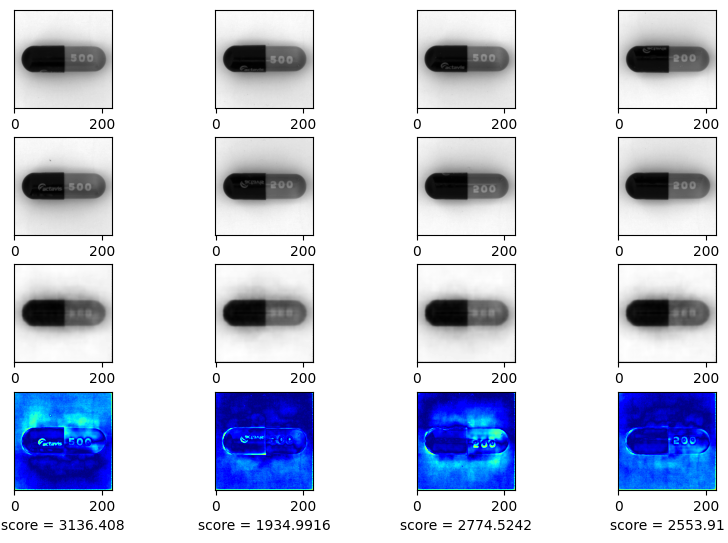

EPOCH 58/150
	 partial train loss (single batch): 1.902775
	 partial train loss (single batch): 2.317155
	 partial train loss (single batch): 6.740660
	 partial train loss (single batch): 8.196711
	 partial train loss (single batch): 6.165879
	 partial train loss (single batch): 2.414290
	 partial train loss (single batch): 3.128057
	 partial train loss (single batch): 6.413784
	 partial train loss (single batch): 6.000676
	 partial train loss (single batch): 4.150947
	 partial train loss (single batch): 2.322073
	 partial train loss (single batch): 2.468752
	 partial train loss (single batch): 4.324352
	 partial train loss (single batch): 3.856876
	 partial train loss (single batch): 1.910749
	 partial train loss (single batch): 1.211350
	 partial train loss (single batch): 1.804808
	 partial train loss (single batch): 2.221281
	 partial train loss (single batch): 2.165525
	 partial train loss (single batch): 1.592949
	 partial train loss (single batch): 1.650883
	 partial train loss 

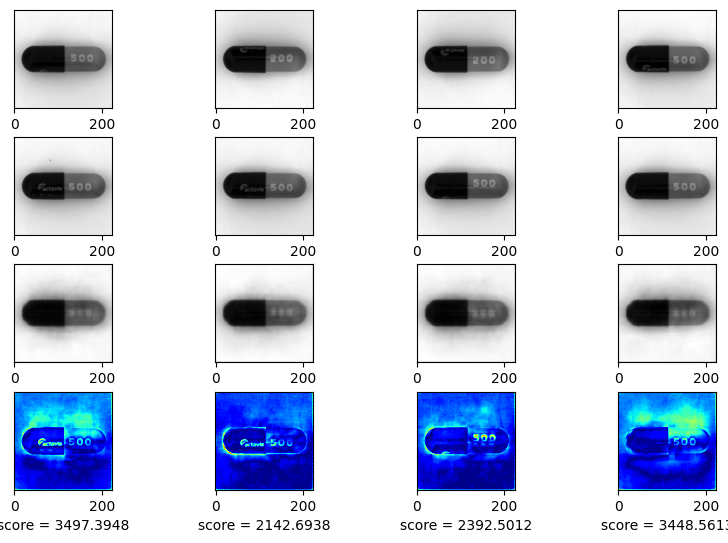

EPOCH 59/150
	 partial train loss (single batch): 2.560634
	 partial train loss (single batch): 1.894527
	 partial train loss (single batch): 1.192568
	 partial train loss (single batch): 1.443026
	 partial train loss (single batch): 2.732646
	 partial train loss (single batch): 1.893052
	 partial train loss (single batch): 1.571311
	 partial train loss (single batch): 8.186334
	 partial train loss (single batch): 23.684818
	 partial train loss (single batch): 40.982040
	 partial train loss (single batch): 30.030699
	 partial train loss (single batch): 14.583399
	 partial train loss (single batch): 3.704023
	 partial train loss (single batch): 10.282685
	 partial train loss (single batch): 25.325680
	 partial train loss (single batch): 31.873705
	 partial train loss (single batch): 35.860714
	 partial train loss (single batch): 15.822993
	 partial train loss (single batch): 2.980264
	 partial train loss (single batch): 2.744189
	 partial train loss (single batch): 8.117790
	 partial tr

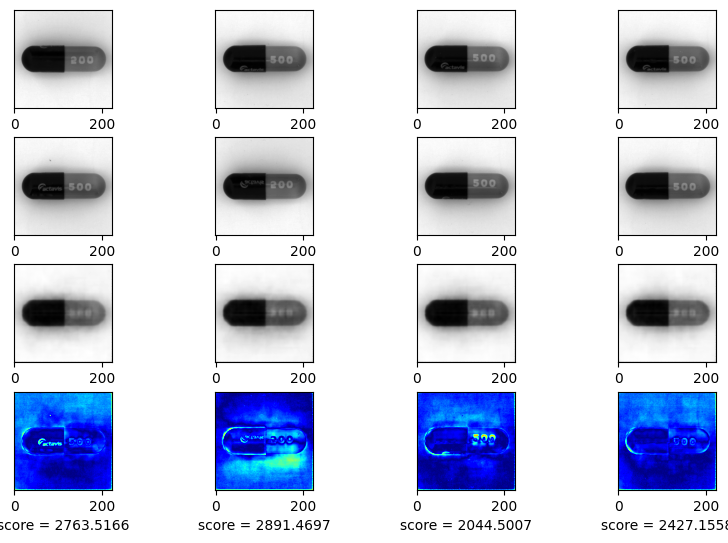

EPOCH 60/150
	 partial train loss (single batch): 1.239393
	 partial train loss (single batch): 11.300331
	 partial train loss (single batch): 22.048010
	 partial train loss (single batch): 6.693710
	 partial train loss (single batch): 4.468976
	 partial train loss (single batch): 27.561317
	 partial train loss (single batch): 37.243881
	 partial train loss (single batch): 38.016796
	 partial train loss (single batch): 15.461097
	 partial train loss (single batch): 2.954277
	 partial train loss (single batch): 5.845197
	 partial train loss (single batch): 12.651017
	 partial train loss (single batch): 13.860653
	 partial train loss (single batch): 7.434431
	 partial train loss (single batch): 2.633408
	 partial train loss (single batch): 1.459860
	 partial train loss (single batch): 3.811171
	 partial train loss (single batch): 5.086889
	 partial train loss (single batch): 3.722473
	 partial train loss (single batch): 2.770065
	 partial train loss (single batch): 2.628488
	 partial tra

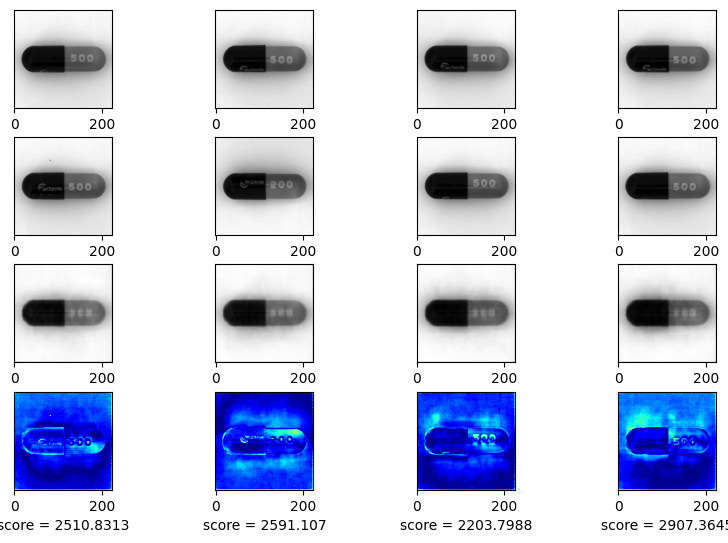

EPOCH 61/150
	 partial train loss (single batch): 5.509978
	 partial train loss (single batch): 3.807312
	 partial train loss (single batch): 6.998292
	 partial train loss (single batch): 13.061558
	 partial train loss (single batch): 6.375114
	 partial train loss (single batch): 5.084943
	 partial train loss (single batch): 20.346926
	 partial train loss (single batch): 22.022366
	 partial train loss (single batch): 9.793755
	 partial train loss (single batch): 7.255134
	 partial train loss (single batch): 55.146698
	 partial train loss (single batch): 131.860947
	 partial train loss (single batch): 33.844486
	 partial train loss (single batch): 4.781915
	 partial train loss (single batch): 46.678928
	 partial train loss (single batch): 44.402149
	 partial train loss (single batch): 14.573660
	 partial train loss (single batch): 12.319452
	 partial train loss (single batch): 53.614681
	 partial train loss (single batch): 76.323334
	 partial train loss (single batch): 25.177511
	 parti

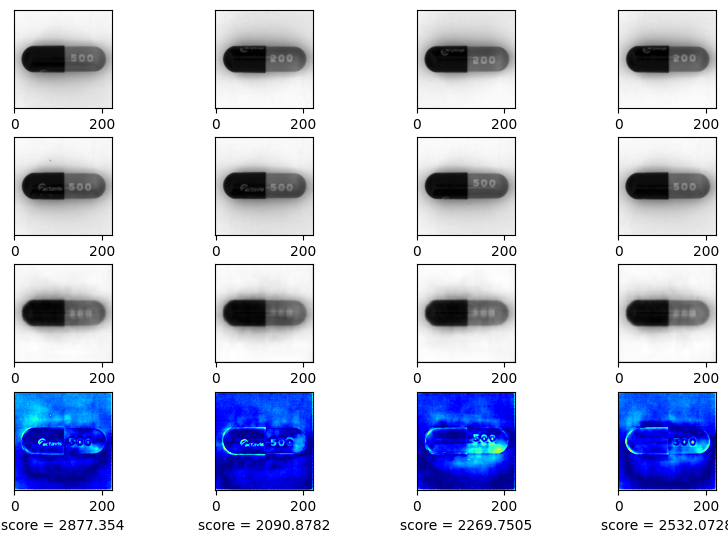

EPOCH 62/150
	 partial train loss (single batch): 28.825857
	 partial train loss (single batch): 39.360104
	 partial train loss (single batch): 16.707848
	 partial train loss (single batch): 3.281788
	 partial train loss (single batch): 20.024948
	 partial train loss (single batch): 22.343384
	 partial train loss (single batch): 3.931108
	 partial train loss (single batch): 19.512590
	 partial train loss (single batch): 24.162474
	 partial train loss (single batch): 4.503784
	 partial train loss (single batch): 26.301327
	 partial train loss (single batch): 50.905624
	 partial train loss (single batch): 22.733690
	 partial train loss (single batch): 1.602545
	 partial train loss (single batch): 14.336728
	 partial train loss (single batch): 23.577000
	 partial train loss (single batch): 10.073299
	 partial train loss (single batch): 3.428513
	 partial train loss (single batch): 6.509744
	 partial train loss (single batch): 5.820075
	 partial train loss (single batch): 2.451138
	 partia

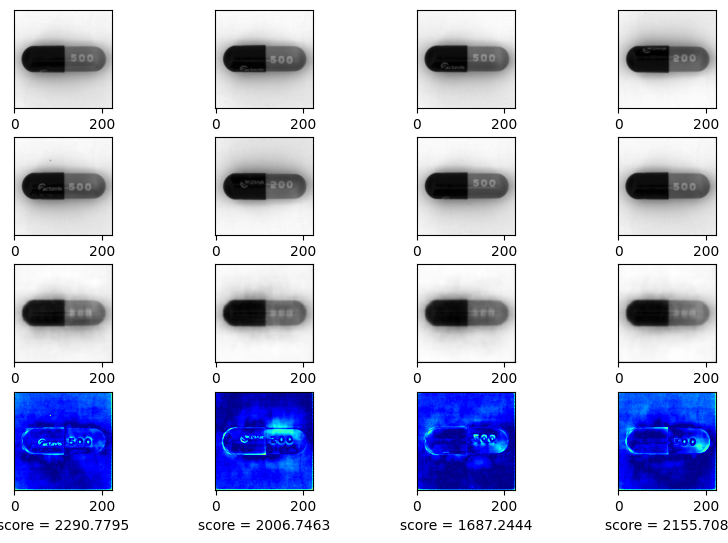

EPOCH 63/150
	 partial train loss (single batch): 6.034386
	 partial train loss (single batch): 4.839149
	 partial train loss (single batch): 2.171614
	 partial train loss (single batch): 2.902294
	 partial train loss (single batch): 3.357879
	 partial train loss (single batch): 2.653784
	 partial train loss (single batch): 3.226758
	 partial train loss (single batch): 4.496423
	 partial train loss (single batch): 4.892707
	 partial train loss (single batch): 4.543898
	 partial train loss (single batch): 3.736190
	 partial train loss (single batch): 0.985134
	 partial train loss (single batch): 4.540667
	 partial train loss (single batch): 5.615641
	 partial train loss (single batch): 1.958810
	 partial train loss (single batch): 2.146757
	 partial train loss (single batch): 3.535141
	 partial train loss (single batch): 5.874223
	 partial train loss (single batch): 5.690166
	 partial train loss (single batch): 2.963554
	 partial train loss (single batch): 5.962752
	 partial train loss 

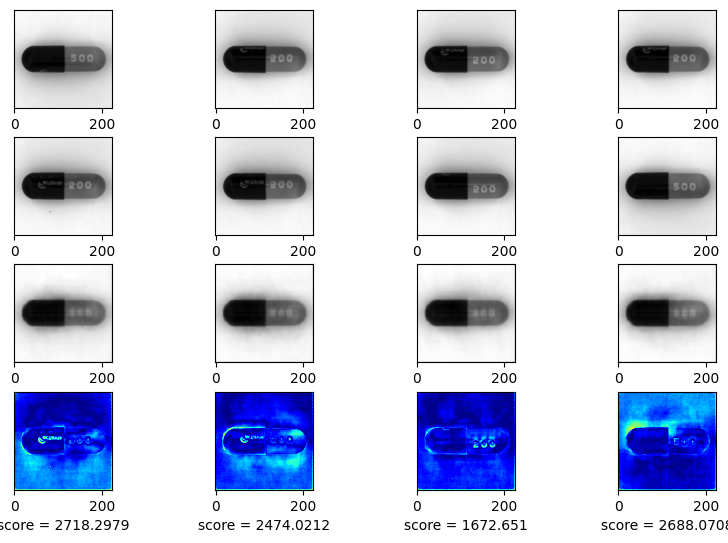

EPOCH 64/150
	 partial train loss (single batch): 2.175657
	 partial train loss (single batch): 7.741267
	 partial train loss (single batch): 6.666225
	 partial train loss (single batch): 1.471165
	 partial train loss (single batch): 3.503542
	 partial train loss (single batch): 6.753773
	 partial train loss (single batch): 4.602044
	 partial train loss (single batch): 1.316268
	 partial train loss (single batch): 3.335439
	 partial train loss (single batch): 2.897675
	 partial train loss (single batch): 1.138935
	 partial train loss (single batch): 2.001405
	 partial train loss (single batch): 3.286890
	 partial train loss (single batch): 2.998507
	 partial train loss (single batch): 1.691796
	 partial train loss (single batch): 1.856997
	 partial train loss (single batch): 1.845033
	 partial train loss (single batch): 1.418713
	 partial train loss (single batch): 1.197271
	 partial train loss (single batch): 0.923584
	 partial train loss (single batch): 1.429719
	 partial train loss 

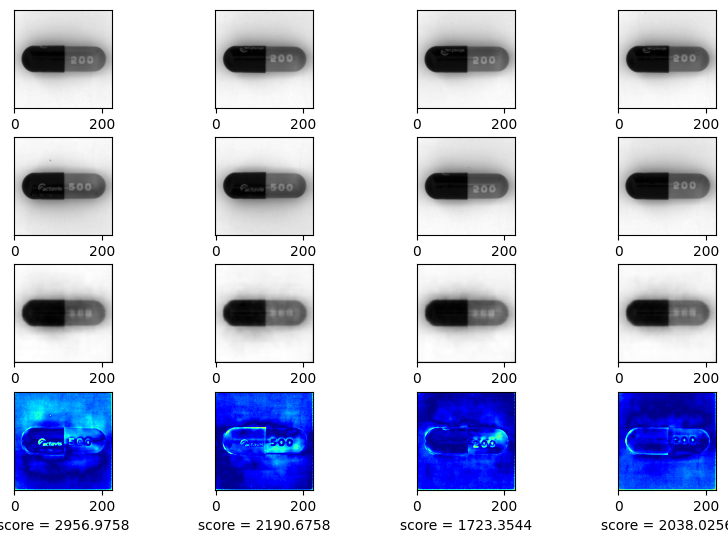

EPOCH 65/150
	 partial train loss (single batch): 1.411833
	 partial train loss (single batch): 1.120760
	 partial train loss (single batch): 0.791489
	 partial train loss (single batch): 1.363129
	 partial train loss (single batch): 1.399927
	 partial train loss (single batch): 1.041981
	 partial train loss (single batch): 1.432329
	 partial train loss (single batch): 1.781374
	 partial train loss (single batch): 1.080730
	 partial train loss (single batch): 1.113420
	 partial train loss (single batch): 1.187963
	 partial train loss (single batch): 0.907394
	 partial train loss (single batch): 1.181587
	 partial train loss (single batch): 1.070408
	 partial train loss (single batch): 0.938074
	 partial train loss (single batch): 1.098619
	 partial train loss (single batch): 1.052348
	 partial train loss (single batch): 1.481284
	 partial train loss (single batch): 2.027959
	 partial train loss (single batch): 1.607853
	 partial train loss (single batch): 1.016909
	 partial train loss 

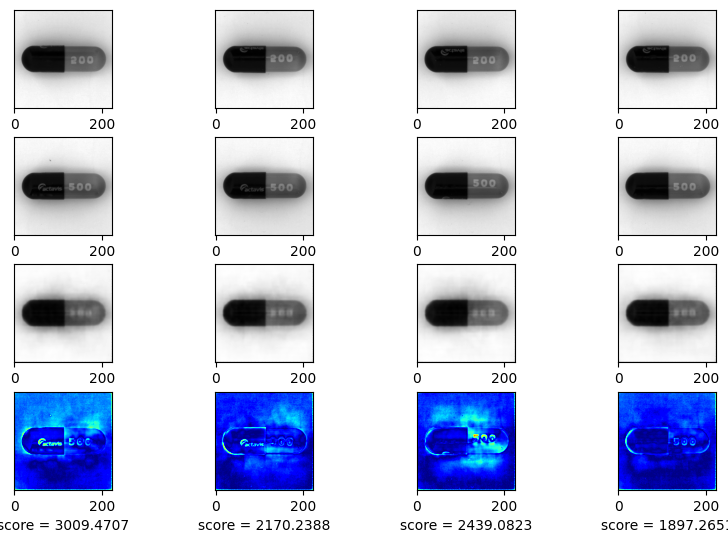

EPOCH 66/150
	 partial train loss (single batch): 1.447056
	 partial train loss (single batch): 0.868267
	 partial train loss (single batch): 1.016916
	 partial train loss (single batch): 1.446441
	 partial train loss (single batch): 1.115436
	 partial train loss (single batch): 0.927870
	 partial train loss (single batch): 1.932979
	 partial train loss (single batch): 1.636270
	 partial train loss (single batch): 1.349512
	 partial train loss (single batch): 1.500005
	 partial train loss (single batch): 1.863995
	 partial train loss (single batch): 1.180058
	 partial train loss (single batch): 2.113218
	 partial train loss (single batch): 4.690772
	 partial train loss (single batch): 2.748306
	 partial train loss (single batch): 0.904997
	 partial train loss (single batch): 1.352315
	 partial train loss (single batch): 1.847600
	 partial train loss (single batch): 0.838346
	 partial train loss (single batch): 1.706027
	 partial train loss (single batch): 1.986811
	 partial train loss 

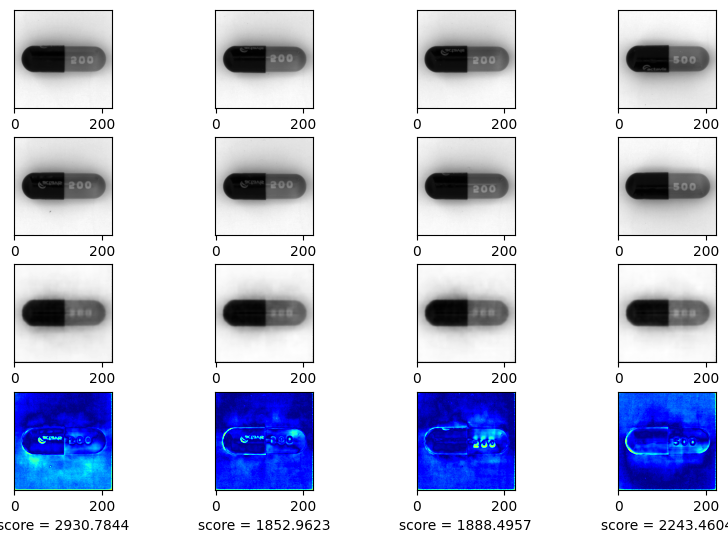

EPOCH 67/150
	 partial train loss (single batch): 1.079652
	 partial train loss (single batch): 2.928210
	 partial train loss (single batch): 2.486093
	 partial train loss (single batch): 0.710899
	 partial train loss (single batch): 1.400023
	 partial train loss (single batch): 1.809110
	 partial train loss (single batch): 0.765158
	 partial train loss (single batch): 1.124303
	 partial train loss (single batch): 1.670847
	 partial train loss (single batch): 1.159095
	 partial train loss (single batch): 0.810038
	 partial train loss (single batch): 1.601043
	 partial train loss (single batch): 1.072599
	 partial train loss (single batch): 0.867710
	 partial train loss (single batch): 0.833883
	 partial train loss (single batch): 0.838173
	 partial train loss (single batch): 0.795608
	 partial train loss (single batch): 1.000189
	 partial train loss (single batch): 1.229875
	 partial train loss (single batch): 1.263805
	 partial train loss (single batch): 1.020074
	 partial train loss 

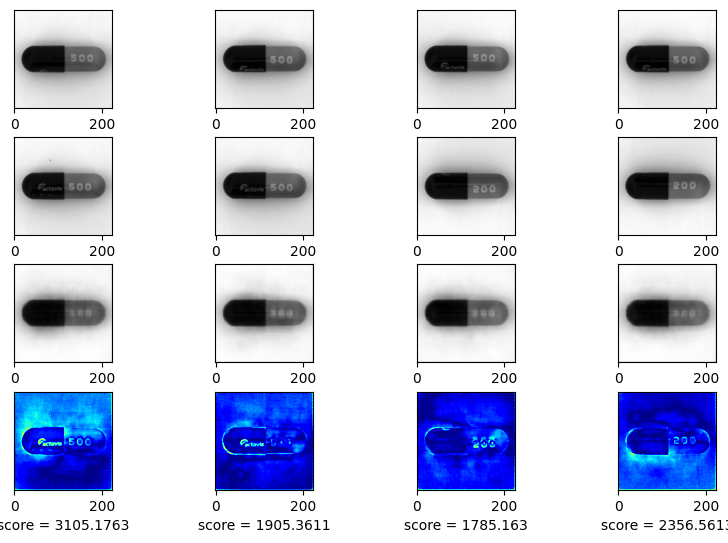

EPOCH 68/150
	 partial train loss (single batch): 0.661437
	 partial train loss (single batch): 0.892618
	 partial train loss (single batch): 1.031242
	 partial train loss (single batch): 0.821649
	 partial train loss (single batch): 0.926088
	 partial train loss (single batch): 0.925580
	 partial train loss (single batch): 1.224838
	 partial train loss (single batch): 1.842448
	 partial train loss (single batch): 1.505446
	 partial train loss (single batch): 1.584928
	 partial train loss (single batch): 2.673341
	 partial train loss (single batch): 3.390644
	 partial train loss (single batch): 2.215466
	 partial train loss (single batch): 1.505222
	 partial train loss (single batch): 2.822085
	 partial train loss (single batch): 2.896501
	 partial train loss (single batch): 2.165634
	 partial train loss (single batch): 1.895627
	 partial train loss (single batch): 2.925580
	 partial train loss (single batch): 4.022030
	 partial train loss (single batch): 1.372619
	 partial train loss 

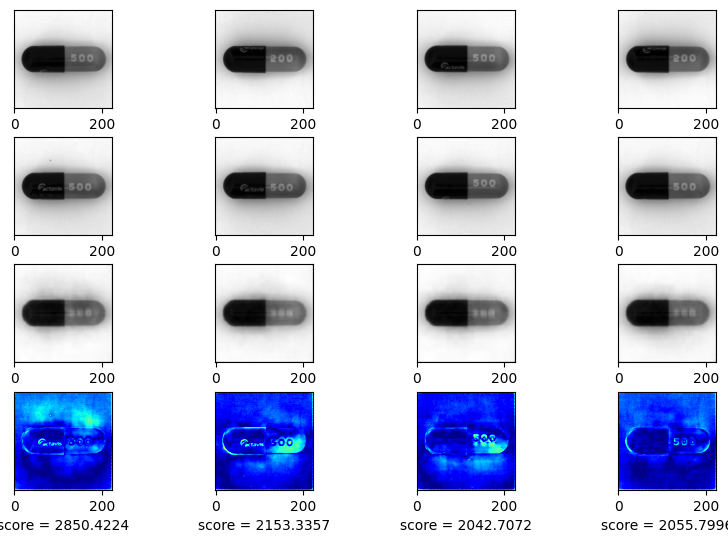

EPOCH 69/150
	 partial train loss (single batch): 2.893886
	 partial train loss (single batch): 1.757750
	 partial train loss (single batch): 0.666855
	 partial train loss (single batch): 0.895795
	 partial train loss (single batch): 0.829883
	 partial train loss (single batch): 0.807023
	 partial train loss (single batch): 0.949786
	 partial train loss (single batch): 1.235186
	 partial train loss (single batch): 0.885568
	 partial train loss (single batch): 0.874515
	 partial train loss (single batch): 1.345814
	 partial train loss (single batch): 1.154387
	 partial train loss (single batch): 0.783489
	 partial train loss (single batch): 0.949247
	 partial train loss (single batch): 1.111485
	 partial train loss (single batch): 0.654084
	 partial train loss (single batch): 0.811547
	 partial train loss (single batch): 1.054346
	 partial train loss (single batch): 1.922023
	 partial train loss (single batch): 2.666374
	 partial train loss (single batch): 1.270429
	 partial train loss 

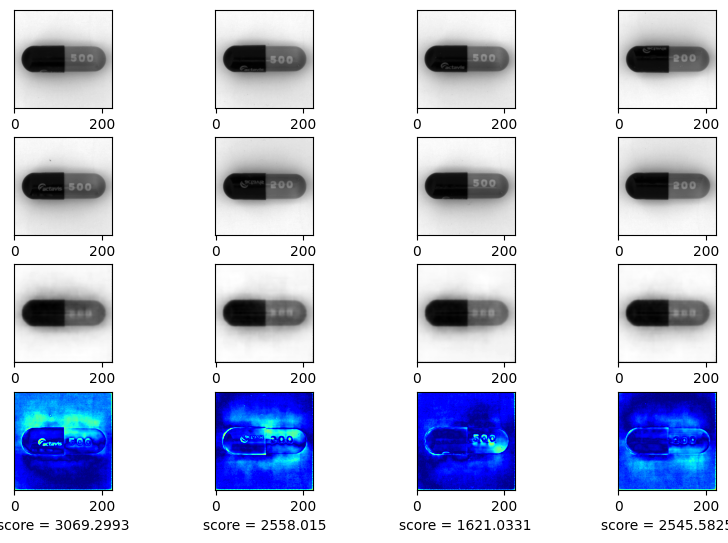

EPOCH 70/150
	 partial train loss (single batch): 1.302402
	 partial train loss (single batch): 0.875365
	 partial train loss (single batch): 1.109015
	 partial train loss (single batch): 1.350860
	 partial train loss (single batch): 1.146414
	 partial train loss (single batch): 2.496340
	 partial train loss (single batch): 4.965647
	 partial train loss (single batch): 4.049045
	 partial train loss (single batch): 1.324569
	 partial train loss (single batch): 1.615905
	 partial train loss (single batch): 3.369997
	 partial train loss (single batch): 3.332067
	 partial train loss (single batch): 1.211929
	 partial train loss (single batch): 1.352189
	 partial train loss (single batch): 2.294097
	 partial train loss (single batch): 1.837050
	 partial train loss (single batch): 1.312169
	 partial train loss (single batch): 1.873446
	 partial train loss (single batch): 2.169476
	 partial train loss (single batch): 1.664316
	 partial train loss (single batch): 0.948417
	 partial train loss 

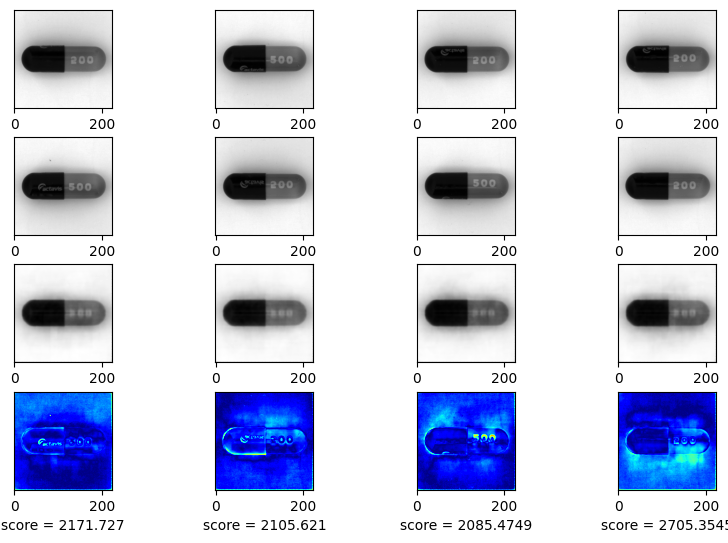

EPOCH 71/150
	 partial train loss (single batch): 1.364331
	 partial train loss (single batch): 1.455195
	 partial train loss (single batch): 3.132954
	 partial train loss (single batch): 3.484232
	 partial train loss (single batch): 1.968103
	 partial train loss (single batch): 0.988460
	 partial train loss (single batch): 1.127651
	 partial train loss (single batch): 1.437762
	 partial train loss (single batch): 0.837709
	 partial train loss (single batch): 1.977284
	 partial train loss (single batch): 3.939453
	 partial train loss (single batch): 3.008425
	 partial train loss (single batch): 1.210071
	 partial train loss (single batch): 1.236411
	 partial train loss (single batch): 1.446059
	 partial train loss (single batch): 1.700329
	 partial train loss (single batch): 2.302289
	 partial train loss (single batch): 2.199464
	 partial train loss (single batch): 1.116650
	 partial train loss (single batch): 0.954720
	 partial train loss (single batch): 2.701608
	 partial train loss 

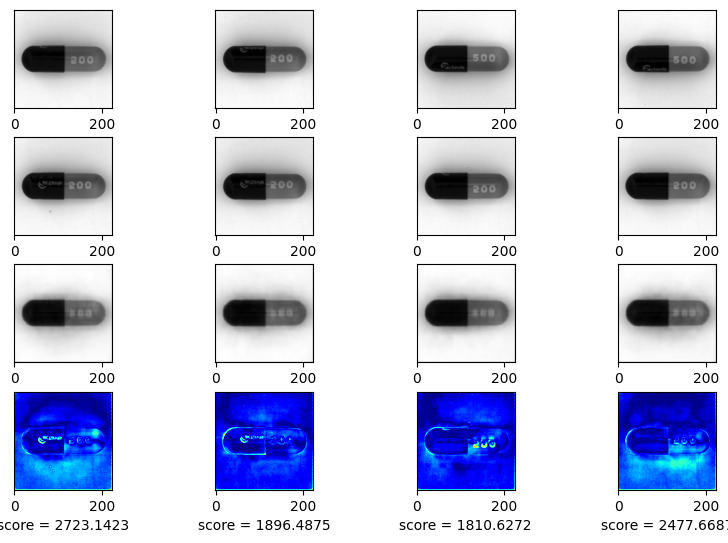

EPOCH 72/150
	 partial train loss (single batch): 0.846838
	 partial train loss (single batch): 5.191021
	 partial train loss (single batch): 9.194380
	 partial train loss (single batch): 4.865659
	 partial train loss (single batch): 0.845917
	 partial train loss (single batch): 2.382185
	 partial train loss (single batch): 5.402061
	 partial train loss (single batch): 4.812817
	 partial train loss (single batch): 1.387774
	 partial train loss (single batch): 2.433403
	 partial train loss (single batch): 5.451873
	 partial train loss (single batch): 4.285261
	 partial train loss (single batch): 1.441273
	 partial train loss (single batch): 1.481058
	 partial train loss (single batch): 4.986228
	 partial train loss (single batch): 5.474757
	 partial train loss (single batch): 2.242402
	 partial train loss (single batch): 1.109832
	 partial train loss (single batch): 2.063797
	 partial train loss (single batch): 3.296983
	 partial train loss (single batch): 3.123612
	 partial train loss 

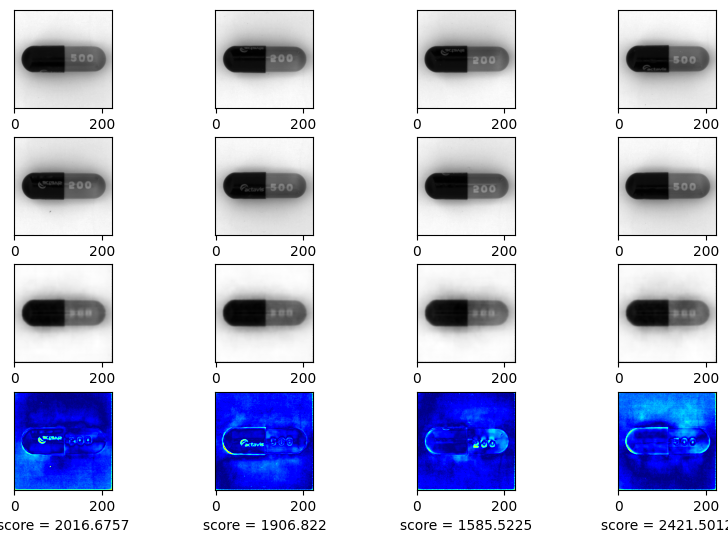

EPOCH 73/150
	 partial train loss (single batch): 0.885096
	 partial train loss (single batch): 3.295965
	 partial train loss (single batch): 4.156778
	 partial train loss (single batch): 2.366735
	 partial train loss (single batch): 0.681138
	 partial train loss (single batch): 2.002178
	 partial train loss (single batch): 2.221863
	 partial train loss (single batch): 0.862410
	 partial train loss (single batch): 1.367817
	 partial train loss (single batch): 2.807342
	 partial train loss (single batch): 1.149298
	 partial train loss (single batch): 2.862863
	 partial train loss (single batch): 4.707311
	 partial train loss (single batch): 1.668726
	 partial train loss (single batch): 2.057920
	 partial train loss (single batch): 3.547937
	 partial train loss (single batch): 2.450143
	 partial train loss (single batch): 0.894458
	 partial train loss (single batch): 2.903101
	 partial train loss (single batch): 5.560418
	 partial train loss (single batch): 5.153998
	 partial train loss 

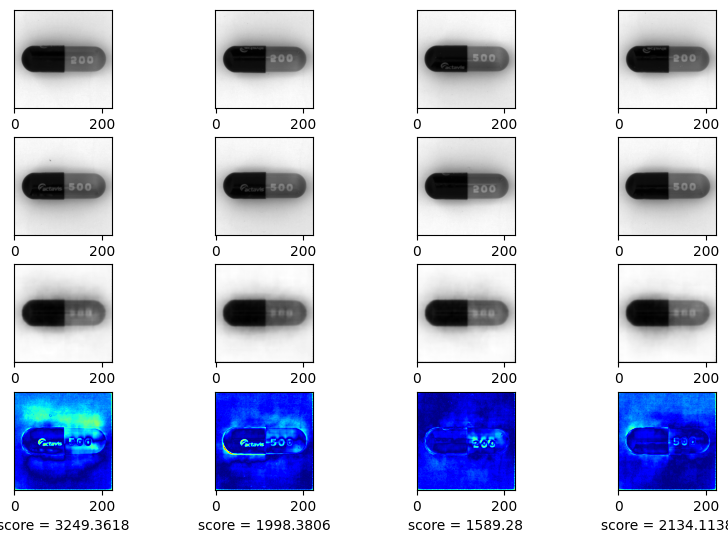

EPOCH 74/150
	 partial train loss (single batch): 1.706005
	 partial train loss (single batch): 6.025155
	 partial train loss (single batch): 5.411933
	 partial train loss (single batch): 1.938758
	 partial train loss (single batch): 2.092502
	 partial train loss (single batch): 5.880967
	 partial train loss (single batch): 5.431798
	 partial train loss (single batch): 1.495693
	 partial train loss (single batch): 1.660420
	 partial train loss (single batch): 5.783844
	 partial train loss (single batch): 5.480658
	 partial train loss (single batch): 1.682933
	 partial train loss (single batch): 1.200714
	 partial train loss (single batch): 3.305383
	 partial train loss (single batch): 3.513621
	 partial train loss (single batch): 1.007070
	 partial train loss (single batch): 1.820695
	 partial train loss (single batch): 6.449871
	 partial train loss (single batch): 5.726487
	 partial train loss (single batch): 2.866316
	 partial train loss (single batch): 0.765819
	 partial train loss 

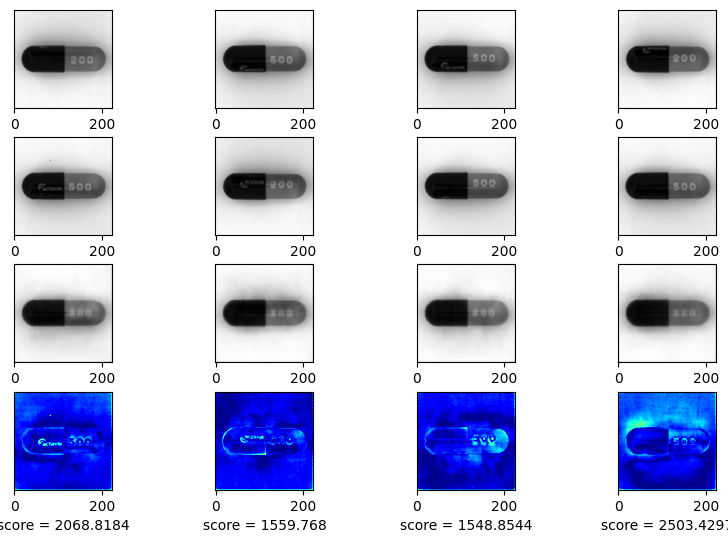

EPOCH 75/150
	 partial train loss (single batch): 1.080523
	 partial train loss (single batch): 0.664167
	 partial train loss (single batch): 1.734786
	 partial train loss (single batch): 3.561430
	 partial train loss (single batch): 3.415629
	 partial train loss (single batch): 1.869542
	 partial train loss (single batch): 0.832802
	 partial train loss (single batch): 1.954710
	 partial train loss (single batch): 1.862256
	 partial train loss (single batch): 0.649609
	 partial train loss (single batch): 1.601024
	 partial train loss (single batch): 3.256751
	 partial train loss (single batch): 2.068175
	 partial train loss (single batch): 0.790974
	 partial train loss (single batch): 2.663000
	 partial train loss (single batch): 5.232476
	 partial train loss (single batch): 5.117306
	 partial train loss (single batch): 1.388002
	 partial train loss (single batch): 0.979024
	 partial train loss (single batch): 2.834016
	 partial train loss (single batch): 2.913690
	 partial train loss 

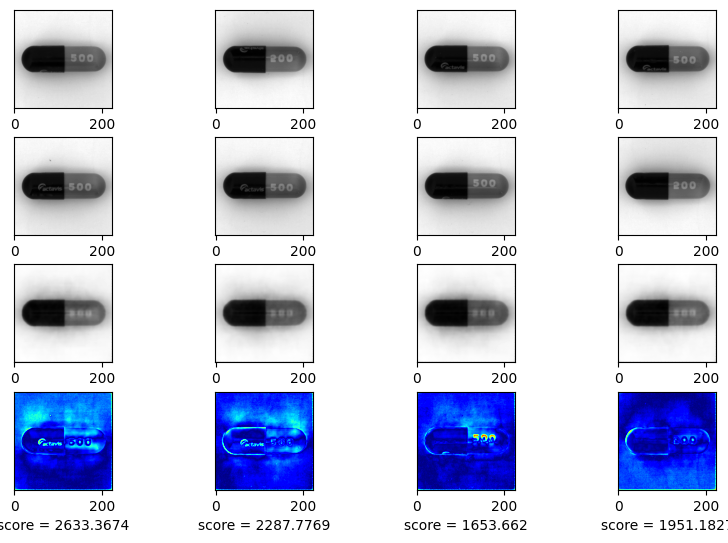

EPOCH 76/150
	 partial train loss (single batch): 1.167489
	 partial train loss (single batch): 3.254176
	 partial train loss (single batch): 2.484465
	 partial train loss (single batch): 1.050529
	 partial train loss (single batch): 3.680031
	 partial train loss (single batch): 8.452462
	 partial train loss (single batch): 7.955571
	 partial train loss (single batch): 3.482042
	 partial train loss (single batch): 1.306712
	 partial train loss (single batch): 4.835866
	 partial train loss (single batch): 8.411180
	 partial train loss (single batch): 5.455479
	 partial train loss (single batch): 1.404682
	 partial train loss (single batch): 1.450945
	 partial train loss (single batch): 4.890379
	 partial train loss (single batch): 5.844012
	 partial train loss (single batch): 3.039234
	 partial train loss (single batch): 1.878276
	 partial train loss (single batch): 2.549231
	 partial train loss (single batch): 2.839746
	 partial train loss (single batch): 2.340241
	 partial train loss 

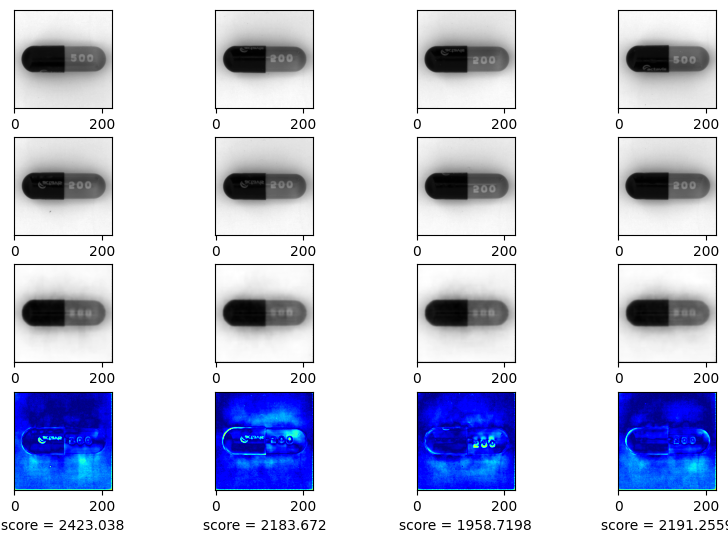

EPOCH 77/150
	 partial train loss (single batch): 1.407292
	 partial train loss (single batch): 1.946385
	 partial train loss (single batch): 2.657483
	 partial train loss (single batch): 1.683779
	 partial train loss (single batch): 1.108137
	 partial train loss (single batch): 2.884477
	 partial train loss (single batch): 3.593480
	 partial train loss (single batch): 2.632682
	 partial train loss (single batch): 1.555954
	 partial train loss (single batch): 0.904213
	 partial train loss (single batch): 1.370697
	 partial train loss (single batch): 2.168654
	 partial train loss (single batch): 2.179170
	 partial train loss (single batch): 1.163384
	 partial train loss (single batch): 0.885674
	 partial train loss (single batch): 2.122191
	 partial train loss (single batch): 2.951800
	 partial train loss (single batch): 2.564335
	 partial train loss (single batch): 1.616065
	 partial train loss (single batch): 1.413640
	 partial train loss (single batch): 2.570024
	 partial train loss 

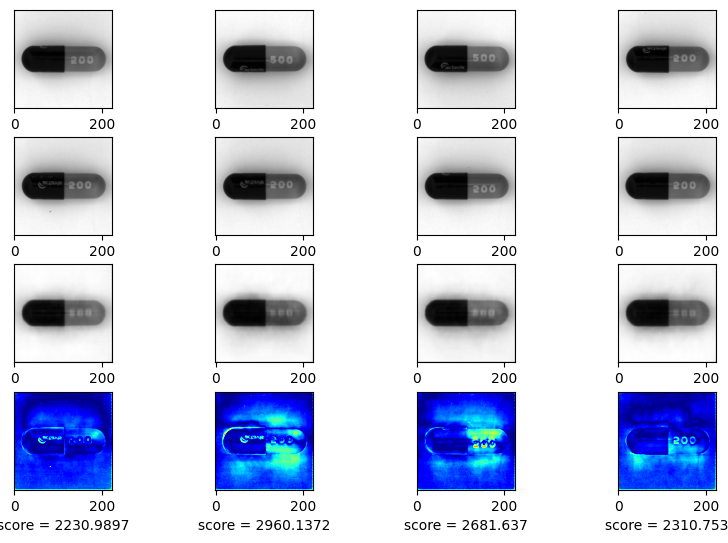

EPOCH 78/150
	 partial train loss (single batch): 1.148054
	 partial train loss (single batch): 1.709605
	 partial train loss (single batch): 3.327235
	 partial train loss (single batch): 2.427235
	 partial train loss (single batch): 1.220694
	 partial train loss (single batch): 2.029884
	 partial train loss (single batch): 3.637696
	 partial train loss (single batch): 2.541705
	 partial train loss (single batch): 0.714610
	 partial train loss (single batch): 2.024197
	 partial train loss (single batch): 3.223135
	 partial train loss (single batch): 1.876837
	 partial train loss (single batch): 0.662806
	 partial train loss (single batch): 2.287387
	 partial train loss (single batch): 3.240900
	 partial train loss (single batch): 1.482355
	 partial train loss (single batch): 1.227989
	 partial train loss (single batch): 2.990447
	 partial train loss (single batch): 3.354437
	 partial train loss (single batch): 1.983562
	 partial train loss (single batch): 1.137912
	 partial train loss 

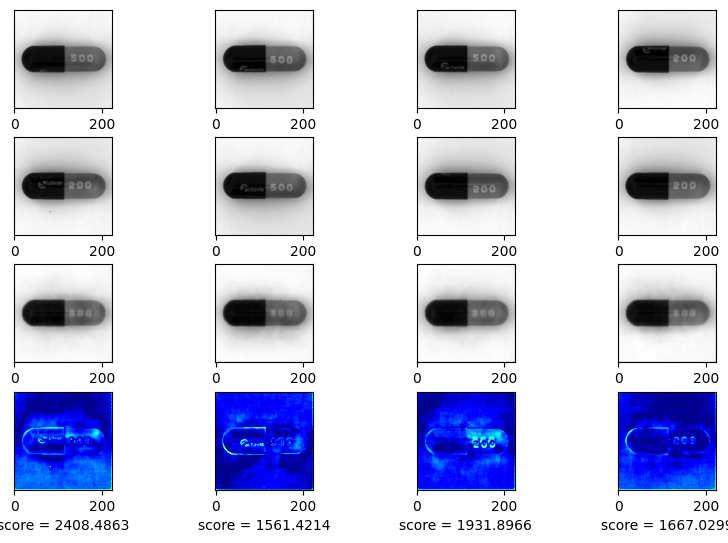

EPOCH 79/150
	 partial train loss (single batch): 1.000784
	 partial train loss (single batch): 2.046280
	 partial train loss (single batch): 2.258185
	 partial train loss (single batch): 1.434401
	 partial train loss (single batch): 1.207134
	 partial train loss (single batch): 1.730413
	 partial train loss (single batch): 2.443391
	 partial train loss (single batch): 2.031688
	 partial train loss (single batch): 1.398809
	 partial train loss (single batch): 1.049283
	 partial train loss (single batch): 2.055752
	 partial train loss (single batch): 3.068202
	 partial train loss (single batch): 2.352242
	 partial train loss (single batch): 1.247391
	 partial train loss (single batch): 0.947890
	 partial train loss (single batch): 1.131334
	 partial train loss (single batch): 1.123925
	 partial train loss (single batch): 0.798019
	 partial train loss (single batch): 0.990415
	 partial train loss (single batch): 1.197894
	 partial train loss (single batch): 1.910830
	 partial train loss 

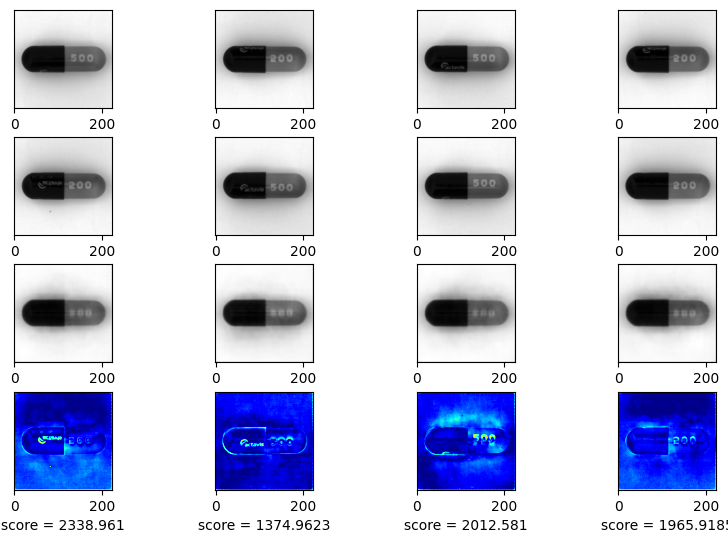

EPOCH 80/150
	 partial train loss (single batch): 0.857302
	 partial train loss (single batch): 3.357112
	 partial train loss (single batch): 8.685021
	 partial train loss (single batch): 5.788908
	 partial train loss (single batch): 0.959357
	 partial train loss (single batch): 2.521931
	 partial train loss (single batch): 7.583124
	 partial train loss (single batch): 12.015573
	 partial train loss (single batch): 8.094397
	 partial train loss (single batch): 3.505456
	 partial train loss (single batch): 0.669532
	 partial train loss (single batch): 2.065790
	 partial train loss (single batch): 4.124104
	 partial train loss (single batch): 3.248688
	 partial train loss (single batch): 1.342219
	 partial train loss (single batch): 1.556061
	 partial train loss (single batch): 5.140655
	 partial train loss (single batch): 6.418266
	 partial train loss (single batch): 2.236739
	 partial train loss (single batch): 1.093150
	 partial train loss (single batch): 3.261532
	 partial train loss

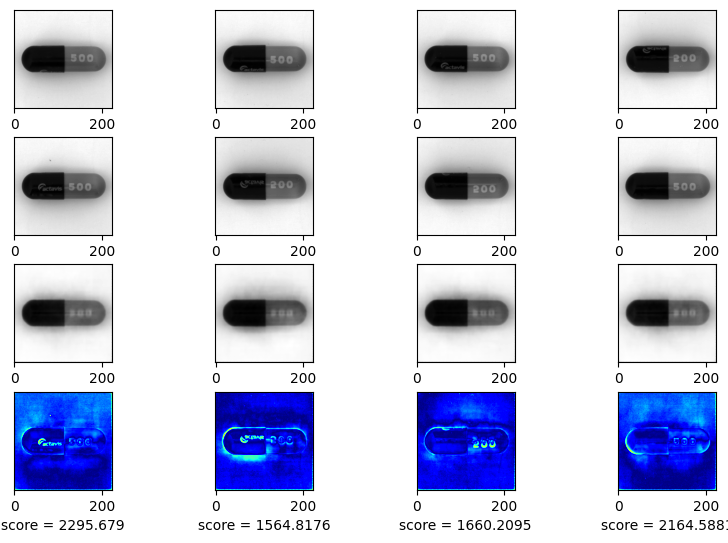

EPOCH 81/150
	 partial train loss (single batch): 1.975495
	 partial train loss (single batch): 1.107404
	 partial train loss (single batch): 3.090802
	 partial train loss (single batch): 4.561167
	 partial train loss (single batch): 2.461232
	 partial train loss (single batch): 1.393831
	 partial train loss (single batch): 2.491016
	 partial train loss (single batch): 1.383682
	 partial train loss (single batch): 1.274211
	 partial train loss (single batch): 3.917372
	 partial train loss (single batch): 4.646719
	 partial train loss (single batch): 4.163846
	 partial train loss (single batch): 2.567801
	 partial train loss (single batch): 0.918918
	 partial train loss (single batch): 2.430304
	 partial train loss (single batch): 8.641884
	 partial train loss (single batch): 15.683551
	 partial train loss (single batch): 10.112550
	 partial train loss (single batch): 2.934916
	 partial train loss (single batch): 1.218223
	 partial train loss (single batch): 5.612969
	 partial train los

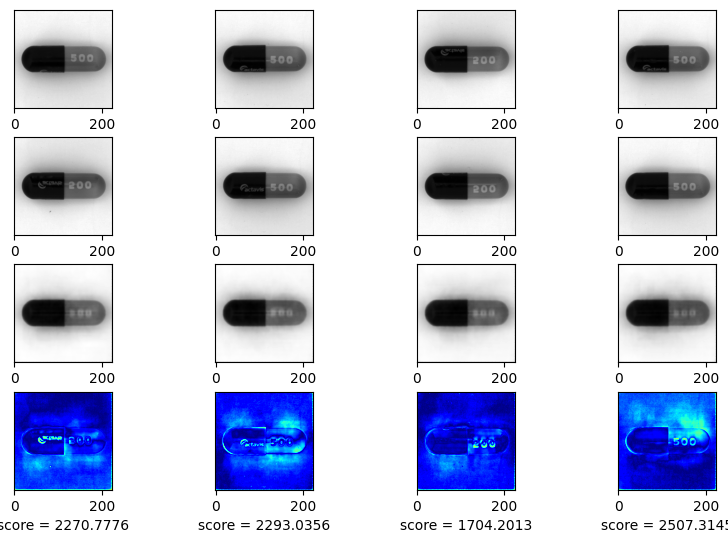

EPOCH 82/150
	 partial train loss (single batch): 1.296727
	 partial train loss (single batch): 2.715846
	 partial train loss (single batch): 10.311767
	 partial train loss (single batch): 11.787930
	 partial train loss (single batch): 9.355316
	 partial train loss (single batch): 2.856257
	 partial train loss (single batch): 1.717593
	 partial train loss (single batch): 8.510598
	 partial train loss (single batch): 10.212611
	 partial train loss (single batch): 5.595973
	 partial train loss (single batch): 1.229704
	 partial train loss (single batch): 8.361217
	 partial train loss (single batch): 19.322268
	 partial train loss (single batch): 12.282748
	 partial train loss (single batch): 5.926775
	 partial train loss (single batch): 3.413006
	 partial train loss (single batch): 4.486452
	 partial train loss (single batch): 5.750210
	 partial train loss (single batch): 3.746063
	 partial train loss (single batch): 2.955560
	 partial train loss (single batch): 3.055358
	 partial train 

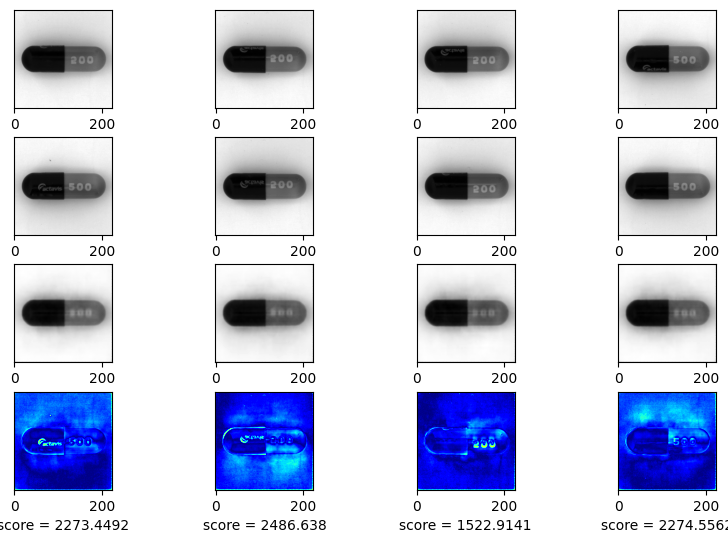

EPOCH 83/150
	 partial train loss (single batch): 2.808974
	 partial train loss (single batch): 4.201053
	 partial train loss (single batch): 4.501894
	 partial train loss (single batch): 2.732210
	 partial train loss (single batch): 1.130695
	 partial train loss (single batch): 1.937915
	 partial train loss (single batch): 3.975222
	 partial train loss (single batch): 4.921550
	 partial train loss (single batch): 2.982935
	 partial train loss (single batch): 1.112367
	 partial train loss (single batch): 0.934880
	 partial train loss (single batch): 2.550328
	 partial train loss (single batch): 3.416388
	 partial train loss (single batch): 2.717640
	 partial train loss (single batch): 2.349942
	 partial train loss (single batch): 1.735469
	 partial train loss (single batch): 2.126608
	 partial train loss (single batch): 3.193256
	 partial train loss (single batch): 2.774101
	 partial train loss (single batch): 2.517986
	 partial train loss (single batch): 3.047667
	 partial train loss 

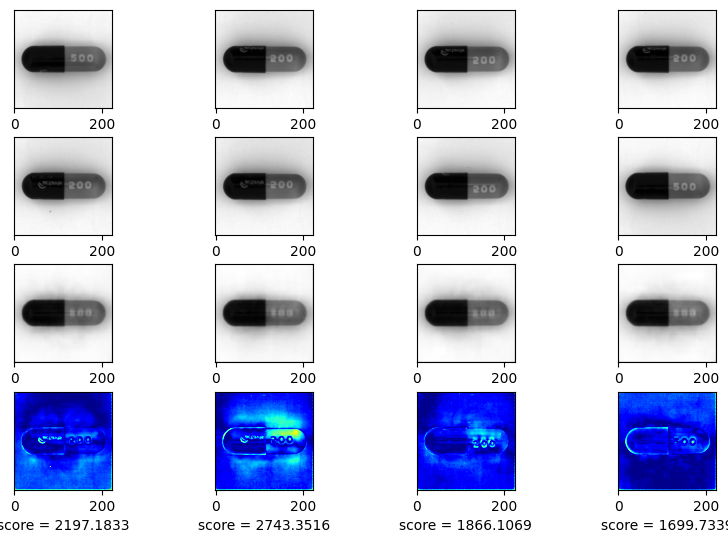

EPOCH 84/150
	 partial train loss (single batch): 2.321862
	 partial train loss (single batch): 1.097893
	 partial train loss (single batch): 1.259142
	 partial train loss (single batch): 2.464129
	 partial train loss (single batch): 3.043749
	 partial train loss (single batch): 1.741605
	 partial train loss (single batch): 0.868686
	 partial train loss (single batch): 2.277781
	 partial train loss (single batch): 3.053874
	 partial train loss (single batch): 2.232907
	 partial train loss (single batch): 0.913255
	 partial train loss (single batch): 1.026845
	 partial train loss (single batch): 2.613741
	 partial train loss (single batch): 3.711390
	 partial train loss (single batch): 2.053146
	 partial train loss (single batch): 1.364040
	 partial train loss (single batch): 3.019022
	 partial train loss (single batch): 3.118125
	 partial train loss (single batch): 1.520220
	 partial train loss (single batch): 1.335470
	 partial train loss (single batch): 1.925997
	 partial train loss 

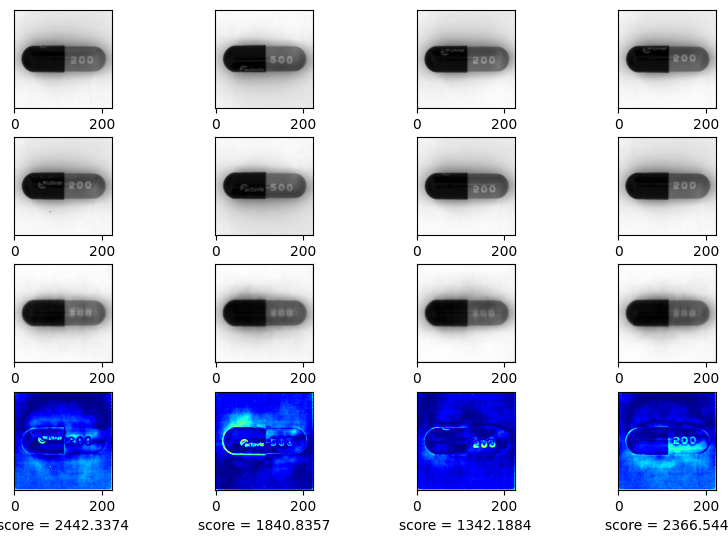

EPOCH 85/150
	 partial train loss (single batch): 1.160024
	 partial train loss (single batch): 0.951773
	 partial train loss (single batch): 1.040359
	 partial train loss (single batch): 1.182688
	 partial train loss (single batch): 1.015581
	 partial train loss (single batch): 1.289363
	 partial train loss (single batch): 1.899875
	 partial train loss (single batch): 2.484248
	 partial train loss (single batch): 1.884155
	 partial train loss (single batch): 1.825444
	 partial train loss (single batch): 1.868388
	 partial train loss (single batch): 0.888510
	 partial train loss (single batch): 0.732016
	 partial train loss (single batch): 1.601109
	 partial train loss (single batch): 2.323605
	 partial train loss (single batch): 1.353601
	 partial train loss (single batch): 0.695669
	 partial train loss (single batch): 2.485118
	 partial train loss (single batch): 4.226439
	 partial train loss (single batch): 2.994215
	 partial train loss (single batch): 0.983731
	 partial train loss 

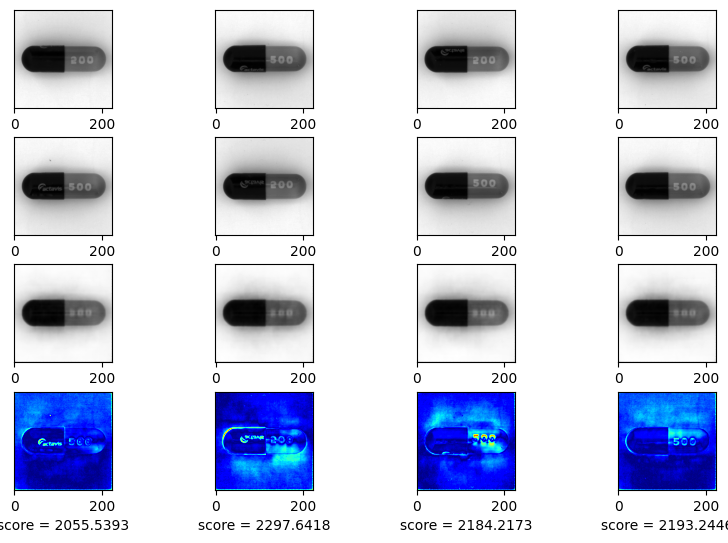

EPOCH 86/150
	 partial train loss (single batch): 2.530018
	 partial train loss (single batch): 1.474487
	 partial train loss (single batch): 0.630911
	 partial train loss (single batch): 2.043281
	 partial train loss (single batch): 4.003222
	 partial train loss (single batch): 3.575317
	 partial train loss (single batch): 1.034157
	 partial train loss (single batch): 1.995720
	 partial train loss (single batch): 8.333304
	 partial train loss (single batch): 13.740872
	 partial train loss (single batch): 8.285646
	 partial train loss (single batch): 2.448790
	 partial train loss (single batch): 0.789559
	 partial train loss (single batch): 1.696618
	 partial train loss (single batch): 2.383357
	 partial train loss (single batch): 1.320994
	 partial train loss (single batch): 1.005681
	 partial train loss (single batch): 1.722111
	 partial train loss (single batch): 1.232374
	 partial train loss (single batch): 1.083387
	 partial train loss (single batch): 0.776825
	 partial train loss

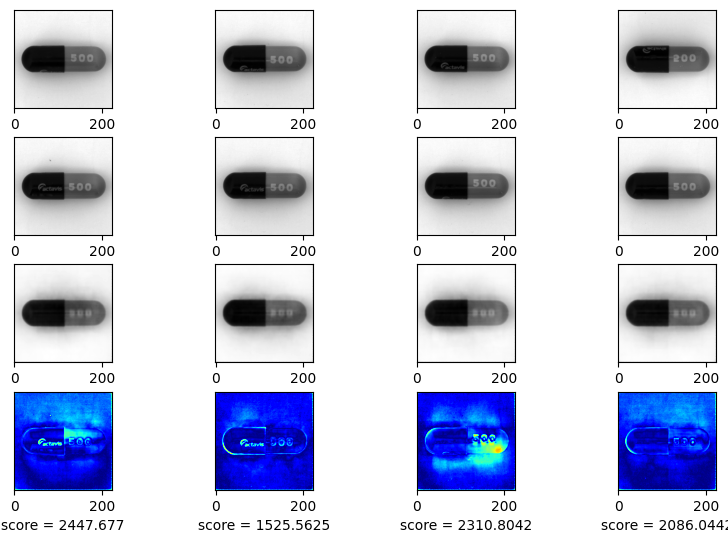

EPOCH 87/150
	 partial train loss (single batch): 1.002911
	 partial train loss (single batch): 1.968343
	 partial train loss (single batch): 2.453229
	 partial train loss (single batch): 1.347416
	 partial train loss (single batch): 0.739595
	 partial train loss (single batch): 2.726341
	 partial train loss (single batch): 3.629121
	 partial train loss (single batch): 2.547677
	 partial train loss (single batch): 0.887035
	 partial train loss (single batch): 0.971120
	 partial train loss (single batch): 2.778932
	 partial train loss (single batch): 3.445278
	 partial train loss (single batch): 2.746656
	 partial train loss (single batch): 1.721197
	 partial train loss (single batch): 0.977388
	 partial train loss (single batch): 0.721881
	 partial train loss (single batch): 2.580805
	 partial train loss (single batch): 4.861130
	 partial train loss (single batch): 3.276621
	 partial train loss (single batch): 1.124382
	 partial train loss (single batch): 0.921732
	 partial train loss 

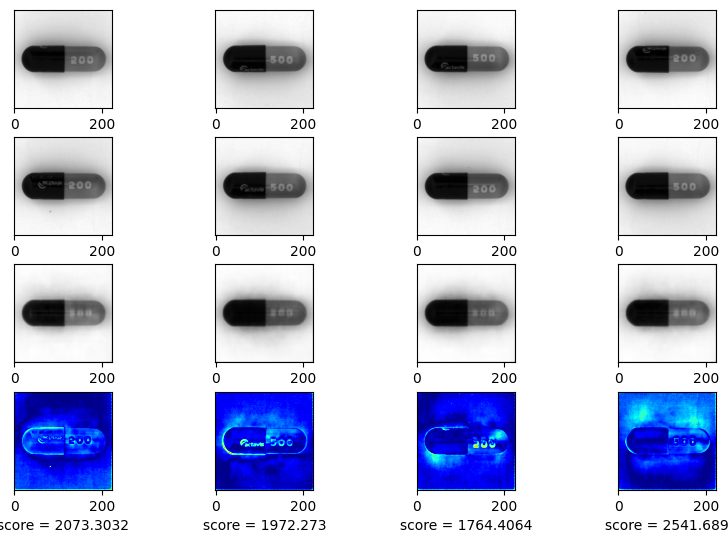

EPOCH 88/150
	 partial train loss (single batch): 0.857209
	 partial train loss (single batch): 0.959389
	 partial train loss (single batch): 1.275795
	 partial train loss (single batch): 1.610727
	 partial train loss (single batch): 1.128884
	 partial train loss (single batch): 0.667113
	 partial train loss (single batch): 1.043502
	 partial train loss (single batch): 1.672703
	 partial train loss (single batch): 1.685021
	 partial train loss (single batch): 0.872313
	 partial train loss (single batch): 0.675212
	 partial train loss (single batch): 0.967559
	 partial train loss (single batch): 1.889252
	 partial train loss (single batch): 2.155484
	 partial train loss (single batch): 1.571667
	 partial train loss (single batch): 0.705947
	 partial train loss (single batch): 1.138663
	 partial train loss (single batch): 1.560173
	 partial train loss (single batch): 1.368767
	 partial train loss (single batch): 1.272152
	 partial train loss (single batch): 0.971036
	 partial train loss 

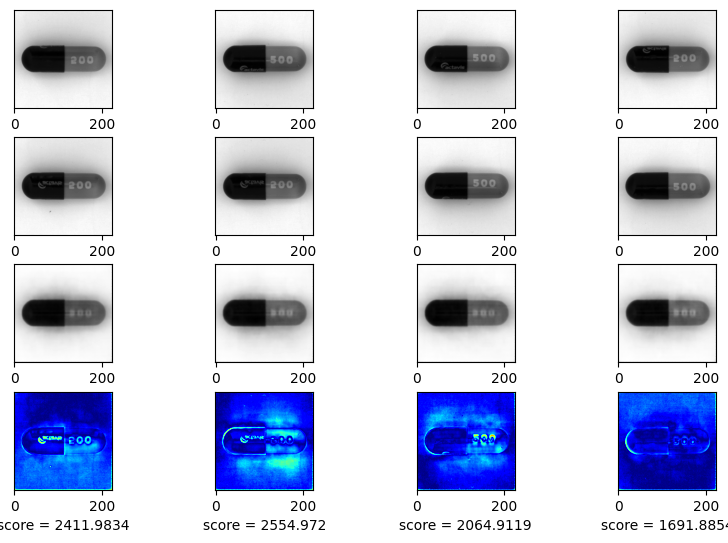

EPOCH 89/150
	 partial train loss (single batch): 0.662521
	 partial train loss (single batch): 1.278290
	 partial train loss (single batch): 1.687842
	 partial train loss (single batch): 2.340806
	 partial train loss (single batch): 4.357950
	 partial train loss (single batch): 4.841541
	 partial train loss (single batch): 4.034864
	 partial train loss (single batch): 1.562671
	 partial train loss (single batch): 0.904741
	 partial train loss (single batch): 4.480987
	 partial train loss (single batch): 7.508756
	 partial train loss (single batch): 9.363439
	 partial train loss (single batch): 5.740903
	 partial train loss (single batch): 1.986877
	 partial train loss (single batch): 1.848345
	 partial train loss (single batch): 6.758937
	 partial train loss (single batch): 8.852544
	 partial train loss (single batch): 2.623012
	 partial train loss (single batch): 4.621645
	 partial train loss (single batch): 27.322453
	 partial train loss (single batch): 39.382523
	 partial train los

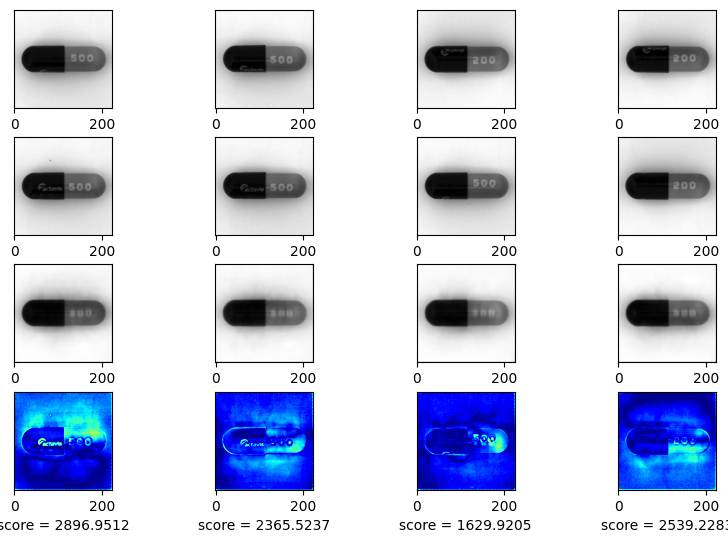

EPOCH 90/150
	 partial train loss (single batch): 2.322088
	 partial train loss (single batch): 29.629377
	 partial train loss (single batch): 91.291473
	 partial train loss (single batch): 30.560202
	 partial train loss (single batch): 2.770203
	 partial train loss (single batch): 22.224995
	 partial train loss (single batch): 37.693962
	 partial train loss (single batch): 36.165703
	 partial train loss (single batch): 2.301492
	 partial train loss (single batch): 28.468534
	 partial train loss (single batch): 61.240250
	 partial train loss (single batch): 15.883165
	 partial train loss (single batch): 2.560040
	 partial train loss (single batch): 24.686117
	 partial train loss (single batch): 19.681480
	 partial train loss (single batch): 3.633297
	 partial train loss (single batch): 8.906620
	 partial train loss (single batch): 27.251844
	 partial train loss (single batch): 28.462360
	 partial train loss (single batch): 2.992711
	 partial train loss (single batch): 29.677092
	 parti

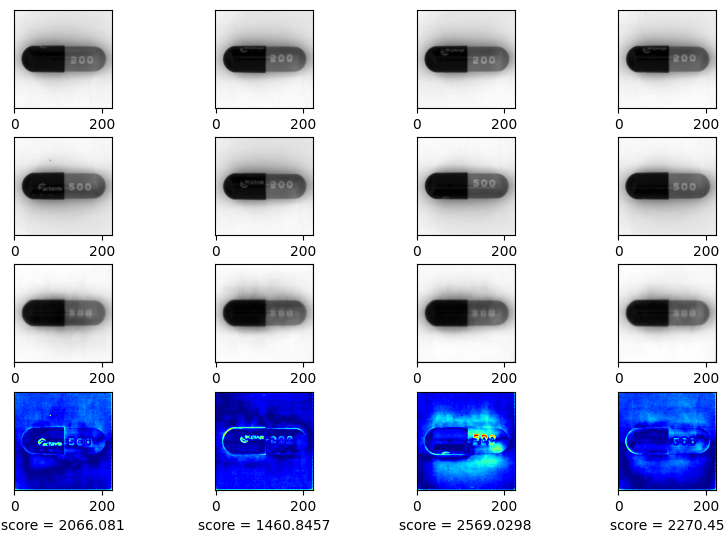

EPOCH 91/150
	 partial train loss (single batch): 0.942236
	 partial train loss (single batch): 71.982185
	 partial train loss (single batch): 143.711548
	 partial train loss (single batch): 3.619648
	 partial train loss (single batch): 130.195297
	 partial train loss (single batch): 256.016510
	 partial train loss (single batch): 29.010262
	 partial train loss (single batch): 450.448456
	 partial train loss (single batch): 794.143555
	 partial train loss (single batch): 485.072052
	 partial train loss (single batch): 656.427429
	 partial train loss (single batch): 194.723938
	 partial train loss (single batch): 386.121094
	 partial train loss (single batch): 58.830559
	 partial train loss (single batch): 319.581360
	 partial train loss (single batch): 179.612885
	 partial train loss (single batch): 311.006287
	 partial train loss (single batch): 36.435272
	 partial train loss (single batch): 321.356598
	 partial train loss (single batch): 108.586777
	 partial train loss (single batch)

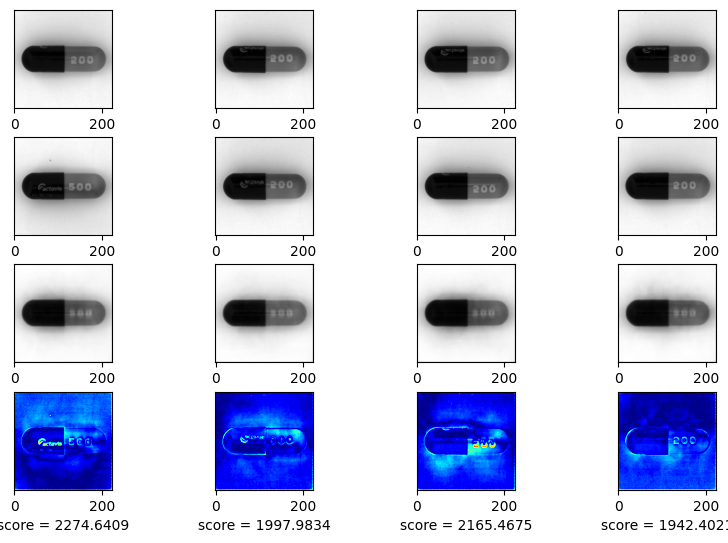

EPOCH 92/150
	 partial train loss (single batch): 104.293129
	 partial train loss (single batch): 94.228561
	 partial train loss (single batch): 76.209427
	 partial train loss (single batch): 57.984329
	 partial train loss (single batch): 95.879028
	 partial train loss (single batch): 41.440605
	 partial train loss (single batch): 48.754333
	 partial train loss (single batch): 65.992424
	 partial train loss (single batch): 27.723480
	 partial train loss (single batch): 38.678341
	 partial train loss (single batch): 58.979908
	 partial train loss (single batch): 14.506365
	 partial train loss (single batch): 33.695950
	 partial train loss (single batch): 36.644665
	 partial train loss (single batch): 12.252110
	 partial train loss (single batch): 22.521177
	 partial train loss (single batch): 25.931637
	 partial train loss (single batch): 12.580059
	 partial train loss (single batch): 11.011702
	 partial train loss (single batch): 24.509979
	 partial train loss (single batch): 7.150102


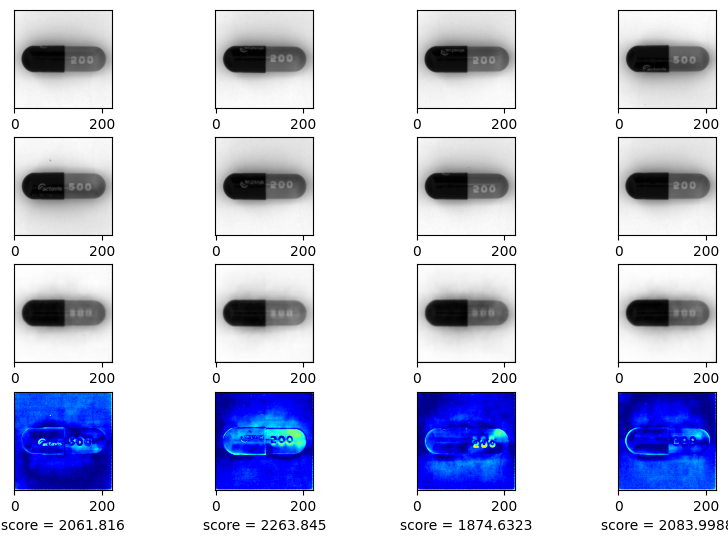

EPOCH 93/150
	 partial train loss (single batch): 15.590347
	 partial train loss (single batch): 8.741599
	 partial train loss (single batch): 3.478105
	 partial train loss (single batch): 9.602093
	 partial train loss (single batch): 9.179410
	 partial train loss (single batch): 2.407895
	 partial train loss (single batch): 5.798781
	 partial train loss (single batch): 5.687779
	 partial train loss (single batch): 4.049290
	 partial train loss (single batch): 2.677499
	 partial train loss (single batch): 5.629020
	 partial train loss (single batch): 4.470618
	 partial train loss (single batch): 1.629026
	 partial train loss (single batch): 4.062418
	 partial train loss (single batch): 2.542692
	 partial train loss (single batch): 1.859835
	 partial train loss (single batch): 1.773194
	 partial train loss (single batch): 2.498648
	 partial train loss (single batch): 1.245409
	 partial train loss (single batch): 0.983099
	 partial train loss (single batch): 1.758054
	 partial train loss

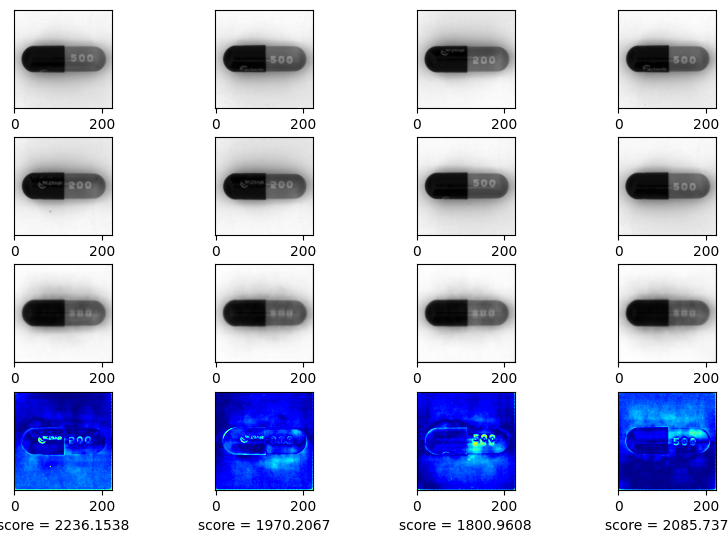

EPOCH 94/150
	 partial train loss (single batch): 1.020234
	 partial train loss (single batch): 0.858925
	 partial train loss (single batch): 1.224037
	 partial train loss (single batch): 1.538391
	 partial train loss (single batch): 0.757901
	 partial train loss (single batch): 1.299537
	 partial train loss (single batch): 1.801897
	 partial train loss (single batch): 0.995933
	 partial train loss (single batch): 1.276927
	 partial train loss (single batch): 1.754506
	 partial train loss (single batch): 0.921635
	 partial train loss (single batch): 1.167406
	 partial train loss (single batch): 1.409858
	 partial train loss (single batch): 0.944367
	 partial train loss (single batch): 1.046116
	 partial train loss (single batch): 0.885716
	 partial train loss (single batch): 0.894587
	 partial train loss (single batch): 0.940993
	 partial train loss (single batch): 0.800166
	 partial train loss (single batch): 1.390958
	 partial train loss (single batch): 1.301862
	 partial train loss 

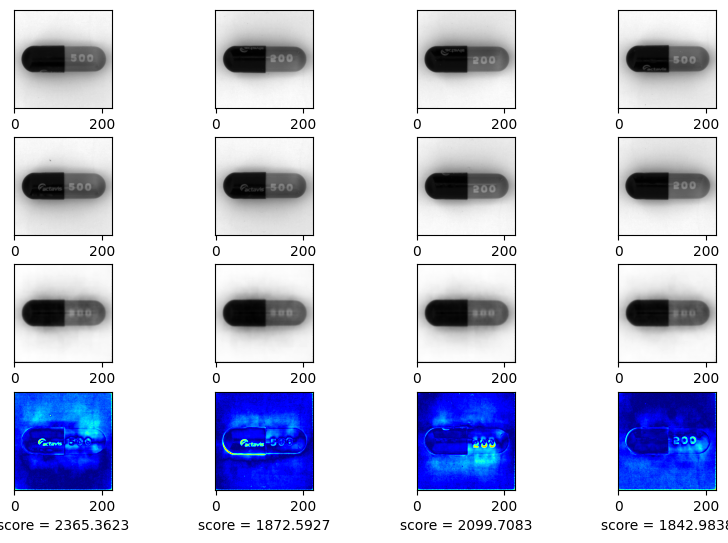

EPOCH 95/150
	 partial train loss (single batch): 0.923735
	 partial train loss (single batch): 1.634624
	 partial train loss (single batch): 0.723691
	 partial train loss (single batch): 0.809506
	 partial train loss (single batch): 0.978358
	 partial train loss (single batch): 1.022281
	 partial train loss (single batch): 0.539898
	 partial train loss (single batch): 0.813724
	 partial train loss (single batch): 0.670942
	 partial train loss (single batch): 0.877499
	 partial train loss (single batch): 0.633504
	 partial train loss (single batch): 0.978619
	 partial train loss (single batch): 0.887999
	 partial train loss (single batch): 0.741695
	 partial train loss (single batch): 0.556947
	 partial train loss (single batch): 0.565490
	 partial train loss (single batch): 0.855148
	 partial train loss (single batch): 0.445861
	 partial train loss (single batch): 0.811068
	 partial train loss (single batch): 0.414491
	 partial train loss (single batch): 0.900716
	 partial train loss 

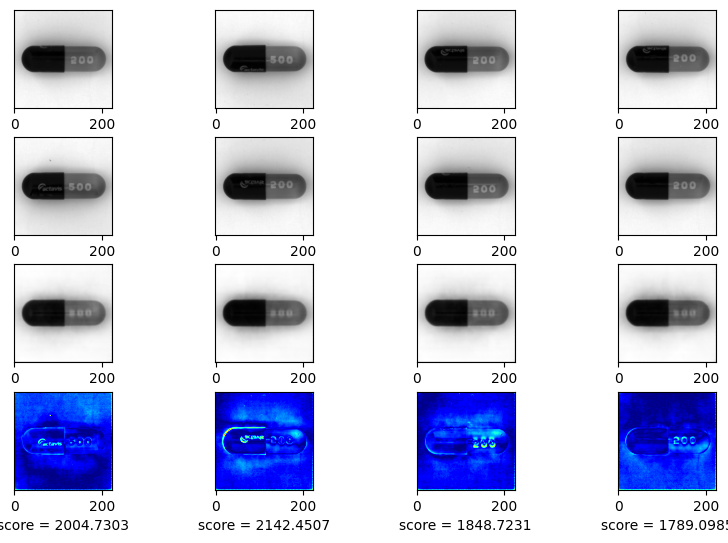

EPOCH 96/150
	 partial train loss (single batch): 0.600840
	 partial train loss (single batch): 0.584484
	 partial train loss (single batch): 0.546524
	 partial train loss (single batch): 0.656443
	 partial train loss (single batch): 0.433399
	 partial train loss (single batch): 0.477497
	 partial train loss (single batch): 0.562368
	 partial train loss (single batch): 0.815829
	 partial train loss (single batch): 0.435624
	 partial train loss (single batch): 0.605998
	 partial train loss (single batch): 0.480027
	 partial train loss (single batch): 0.713420
	 partial train loss (single batch): 0.678670
	 partial train loss (single batch): 0.396313
	 partial train loss (single batch): 0.736749
	 partial train loss (single batch): 0.838517
	 partial train loss (single batch): 0.601075
	 partial train loss (single batch): 0.548603
	 partial train loss (single batch): 0.544025
	 partial train loss (single batch): 0.387675
	 partial train loss (single batch): 0.528790
	 partial train loss 

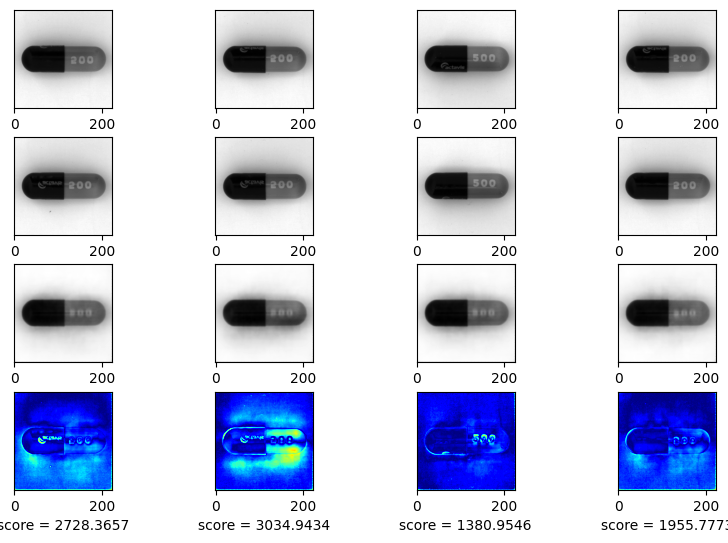

EPOCH 97/150
	 partial train loss (single batch): 0.744585
	 partial train loss (single batch): 0.430520
	 partial train loss (single batch): 0.497478
	 partial train loss (single batch): 0.671280
	 partial train loss (single batch): 0.338046
	 partial train loss (single batch): 0.549007
	 partial train loss (single batch): 0.408087
	 partial train loss (single batch): 0.432117
	 partial train loss (single batch): 0.377624
	 partial train loss (single batch): 0.391511
	 partial train loss (single batch): 0.627401
	 partial train loss (single batch): 0.557973
	 partial train loss (single batch): 0.379920
	 partial train loss (single batch): 0.828252
	 partial train loss (single batch): 0.364019
	 partial train loss (single batch): 0.576963
	 partial train loss (single batch): 0.552687
	 partial train loss (single batch): 0.515585
	 partial train loss (single batch): 0.565690
	 partial train loss (single batch): 0.517840
	 partial train loss (single batch): 0.653138
	 partial train loss 

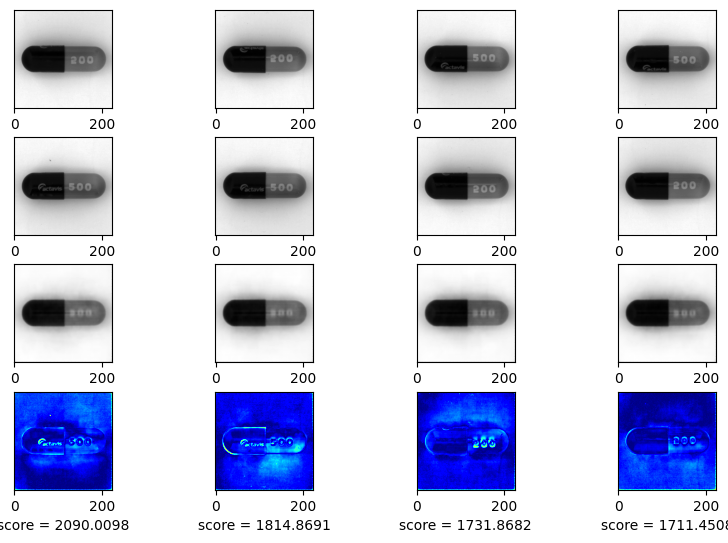

EPOCH 98/150
	 partial train loss (single batch): 0.483655
	 partial train loss (single batch): 0.473275
	 partial train loss (single batch): 0.718306
	 partial train loss (single batch): 0.471218
	 partial train loss (single batch): 0.521532
	 partial train loss (single batch): 0.758927
	 partial train loss (single batch): 0.635722
	 partial train loss (single batch): 0.505445
	 partial train loss (single batch): 0.674618
	 partial train loss (single batch): 0.414237
	 partial train loss (single batch): 0.381176
	 partial train loss (single batch): 0.592959
	 partial train loss (single batch): 0.556844
	 partial train loss (single batch): 0.430305
	 partial train loss (single batch): 0.403413
	 partial train loss (single batch): 0.640062
	 partial train loss (single batch): 0.457513
	 partial train loss (single batch): 0.695688
	 partial train loss (single batch): 0.458023
	 partial train loss (single batch): 0.652652
	 partial train loss (single batch): 0.419482
	 partial train loss 

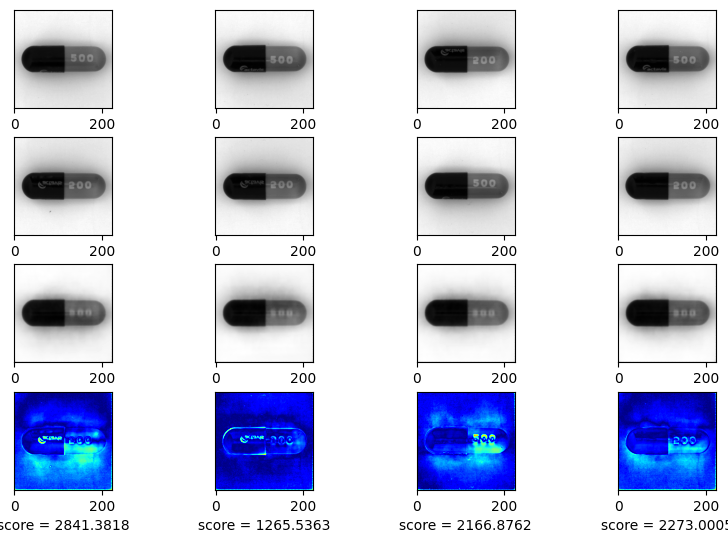

EPOCH 99/150
	 partial train loss (single batch): 0.575629
	 partial train loss (single batch): 0.317383
	 partial train loss (single batch): 0.651227
	 partial train loss (single batch): 0.555174
	 partial train loss (single batch): 0.362786
	 partial train loss (single batch): 0.522436
	 partial train loss (single batch): 0.394720
	 partial train loss (single batch): 0.549409
	 partial train loss (single batch): 0.308762
	 partial train loss (single batch): 0.622356
	 partial train loss (single batch): 0.405470
	 partial train loss (single batch): 0.461306
	 partial train loss (single batch): 0.604016
	 partial train loss (single batch): 0.388838
	 partial train loss (single batch): 0.534924
	 partial train loss (single batch): 0.443351
	 partial train loss (single batch): 0.466138
	 partial train loss (single batch): 0.457865
	 partial train loss (single batch): 0.408786
	 partial train loss (single batch): 0.460957
	 partial train loss (single batch): 0.440729
	 partial train loss 

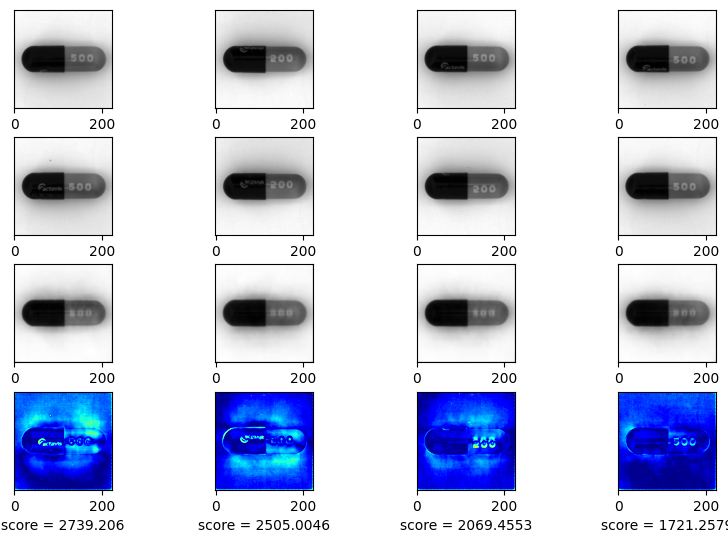

EPOCH 100/150
	 partial train loss (single batch): 0.439228
	 partial train loss (single batch): 0.337240
	 partial train loss (single batch): 0.380615
	 partial train loss (single batch): 0.358213
	 partial train loss (single batch): 0.336338
	 partial train loss (single batch): 0.502346
	 partial train loss (single batch): 0.458289
	 partial train loss (single batch): 0.546298
	 partial train loss (single batch): 0.265255
	 partial train loss (single batch): 0.468335
	 partial train loss (single batch): 0.427896
	 partial train loss (single batch): 0.459103
	 partial train loss (single batch): 0.676924
	 partial train loss (single batch): 0.397635
	 partial train loss (single batch): 0.472244
	 partial train loss (single batch): 0.399486
	 partial train loss (single batch): 0.477662
	 partial train loss (single batch): 0.468804
	 partial train loss (single batch): 0.451596
	 partial train loss (single batch): 0.559427
	 partial train loss (single batch): 0.433538
	 partial train loss

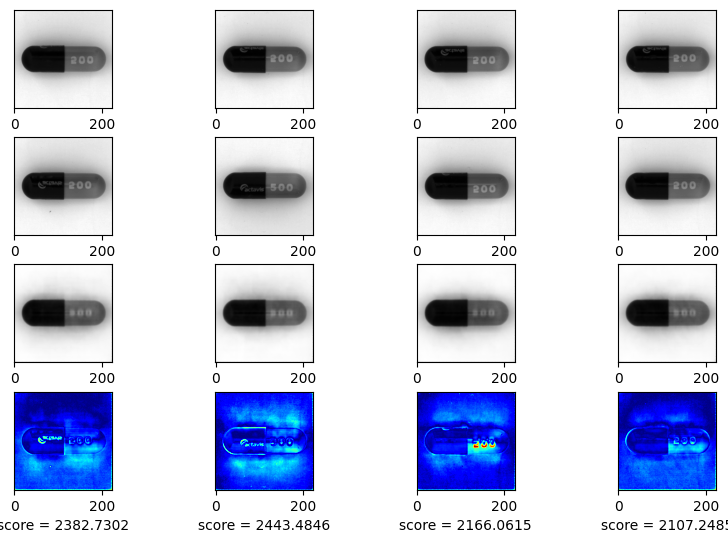

EPOCH 101/150
	 partial train loss (single batch): 0.498911
	 partial train loss (single batch): 0.285402
	 partial train loss (single batch): 0.651851
	 partial train loss (single batch): 0.528307
	 partial train loss (single batch): 0.447141
	 partial train loss (single batch): 0.352003
	 partial train loss (single batch): 0.318996
	 partial train loss (single batch): 0.379385
	 partial train loss (single batch): 0.557488
	 partial train loss (single batch): 0.348891
	 partial train loss (single batch): 0.327688
	 partial train loss (single batch): 0.374129
	 partial train loss (single batch): 0.273098
	 partial train loss (single batch): 0.328586
	 partial train loss (single batch): 0.505778
	 partial train loss (single batch): 0.346965
	 partial train loss (single batch): 0.497746
	 partial train loss (single batch): 0.403469
	 partial train loss (single batch): 0.429028
	 partial train loss (single batch): 0.301641
	 partial train loss (single batch): 0.372482
	 partial train loss

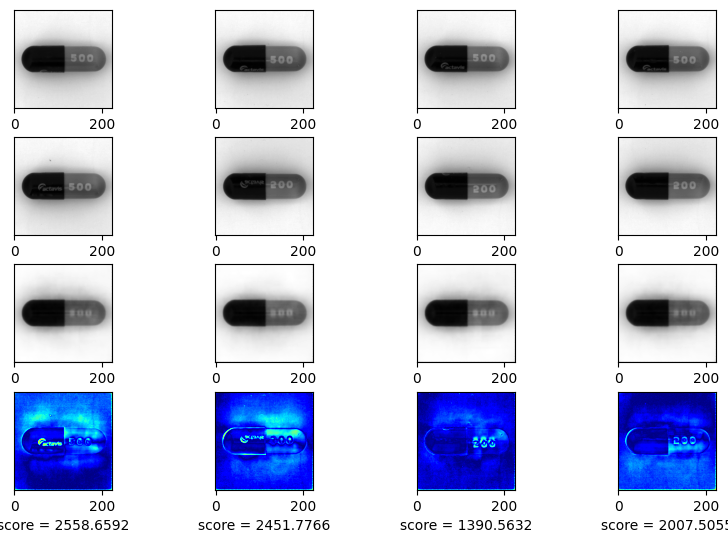

EPOCH 102/150
	 partial train loss (single batch): 0.337655
	 partial train loss (single batch): 0.269720
	 partial train loss (single batch): 0.456822
	 partial train loss (single batch): 0.275787
	 partial train loss (single batch): 0.415548
	 partial train loss (single batch): 0.448521
	 partial train loss (single batch): 0.282836
	 partial train loss (single batch): 0.320390
	 partial train loss (single batch): 0.377977
	 partial train loss (single batch): 0.324242
	 partial train loss (single batch): 0.517811
	 partial train loss (single batch): 0.422877
	 partial train loss (single batch): 0.362713
	 partial train loss (single batch): 0.441243
	 partial train loss (single batch): 0.435337
	 partial train loss (single batch): 0.492730
	 partial train loss (single batch): 0.548629
	 partial train loss (single batch): 0.385759
	 partial train loss (single batch): 0.415692
	 partial train loss (single batch): 0.434485
	 partial train loss (single batch): 0.395705
	 partial train loss

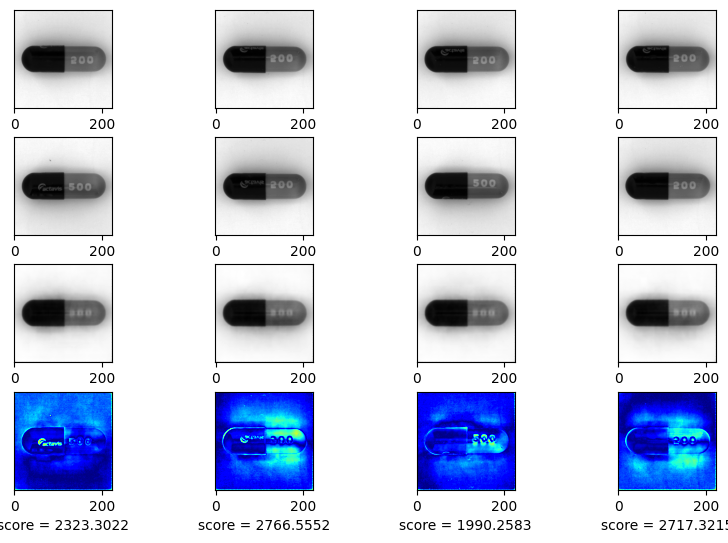

EPOCH 103/150
	 partial train loss (single batch): 0.544261
	 partial train loss (single batch): 0.370633
	 partial train loss (single batch): 0.831770
	 partial train loss (single batch): 0.477727
	 partial train loss (single batch): 0.456669
	 partial train loss (single batch): 0.362607
	 partial train loss (single batch): 0.569710
	 partial train loss (single batch): 0.316892
	 partial train loss (single batch): 0.431900
	 partial train loss (single batch): 0.325617
	 partial train loss (single batch): 0.437602
	 partial train loss (single batch): 0.377150
	 partial train loss (single batch): 0.499849
	 partial train loss (single batch): 0.268604
	 partial train loss (single batch): 0.400372
	 partial train loss (single batch): 0.320933
	 partial train loss (single batch): 0.727615
	 partial train loss (single batch): 0.320371
	 partial train loss (single batch): 0.464224
	 partial train loss (single batch): 0.356484
	 partial train loss (single batch): 0.351909
	 partial train loss

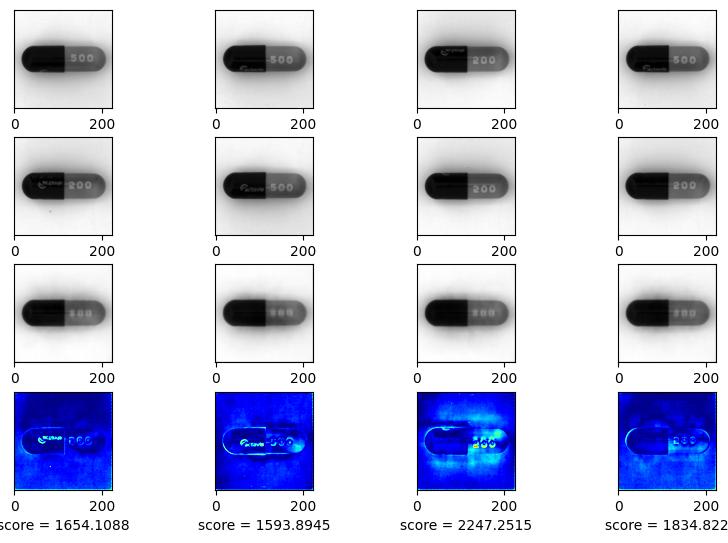

EPOCH 104/150
	 partial train loss (single batch): 0.277042
	 partial train loss (single batch): 0.322423
	 partial train loss (single batch): 0.280644
	 partial train loss (single batch): 0.337544
	 partial train loss (single batch): 0.252022
	 partial train loss (single batch): 0.258539
	 partial train loss (single batch): 0.368640
	 partial train loss (single batch): 0.337159
	 partial train loss (single batch): 0.258260
	 partial train loss (single batch): 0.279399
	 partial train loss (single batch): 0.271244
	 partial train loss (single batch): 0.467360
	 partial train loss (single batch): 0.484561
	 partial train loss (single batch): 0.652908
	 partial train loss (single batch): 0.441281
	 partial train loss (single batch): 0.539650
	 partial train loss (single batch): 0.499225
	 partial train loss (single batch): 0.633778
	 partial train loss (single batch): 0.310849
	 partial train loss (single batch): 0.673583
	 partial train loss (single batch): 0.451169
	 partial train loss

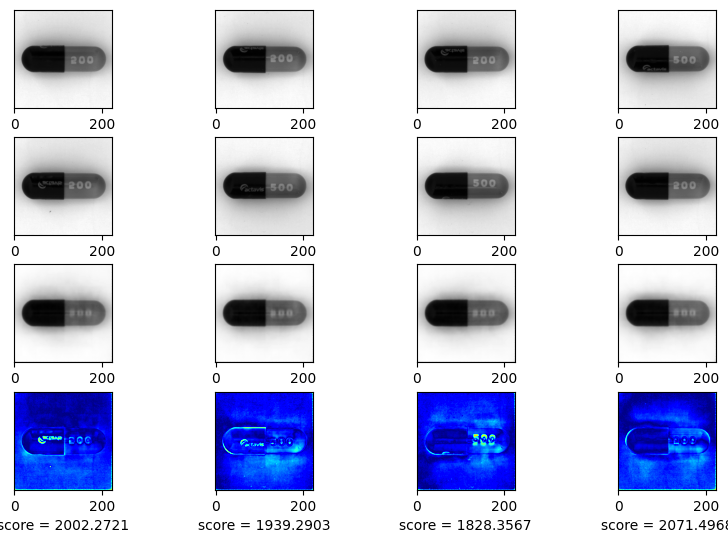

EPOCH 105/150
	 partial train loss (single batch): 0.557819
	 partial train loss (single batch): 0.540617
	 partial train loss (single batch): 0.385386
	 partial train loss (single batch): 0.370496
	 partial train loss (single batch): 0.381232
	 partial train loss (single batch): 0.550471
	 partial train loss (single batch): 0.320857
	 partial train loss (single batch): 0.443629
	 partial train loss (single batch): 0.359542
	 partial train loss (single batch): 0.386242
	 partial train loss (single batch): 0.253818
	 partial train loss (single batch): 0.369450
	 partial train loss (single batch): 0.341329
	 partial train loss (single batch): 0.451900
	 partial train loss (single batch): 0.312920
	 partial train loss (single batch): 0.295237
	 partial train loss (single batch): 0.465660
	 partial train loss (single batch): 0.281682
	 partial train loss (single batch): 0.316444
	 partial train loss (single batch): 0.369021
	 partial train loss (single batch): 0.335664
	 partial train loss

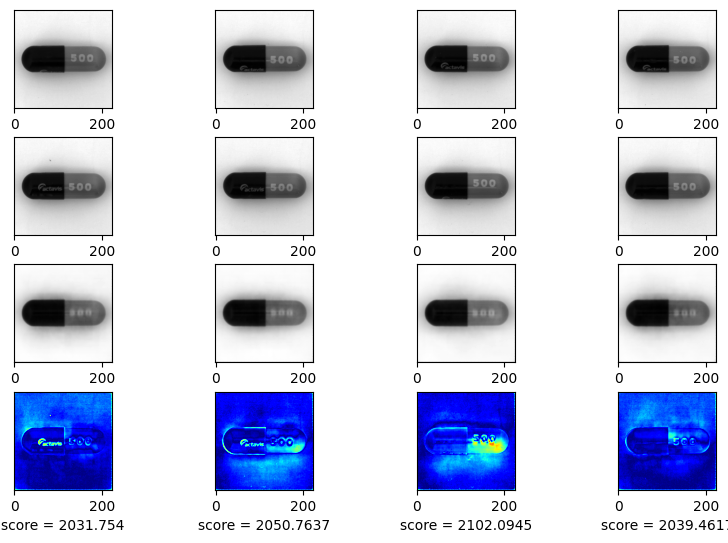

EPOCH 106/150
	 partial train loss (single batch): 0.303907
	 partial train loss (single batch): 0.317487
	 partial train loss (single batch): 0.296697
	 partial train loss (single batch): 0.382556
	 partial train loss (single batch): 0.392645
	 partial train loss (single batch): 0.379022
	 partial train loss (single batch): 0.271693
	 partial train loss (single batch): 0.351466
	 partial train loss (single batch): 0.220704
	 partial train loss (single batch): 0.326140
	 partial train loss (single batch): 0.265271
	 partial train loss (single batch): 0.237090
	 partial train loss (single batch): 0.324394
	 partial train loss (single batch): 0.275541
	 partial train loss (single batch): 0.307866
	 partial train loss (single batch): 0.658529
	 partial train loss (single batch): 0.434083
	 partial train loss (single batch): 0.311086
	 partial train loss (single batch): 0.467350
	 partial train loss (single batch): 0.312820
	 partial train loss (single batch): 0.346389
	 partial train loss

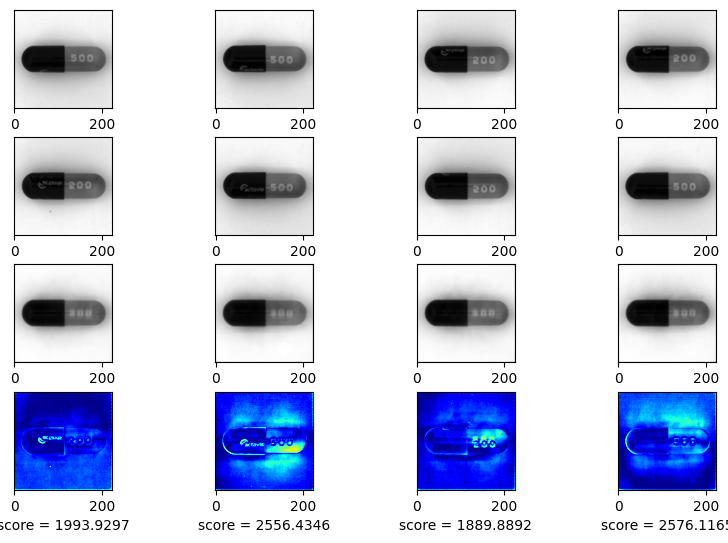

EPOCH 107/150
	 partial train loss (single batch): 0.317695
	 partial train loss (single batch): 0.377558
	 partial train loss (single batch): 0.268986
	 partial train loss (single batch): 0.358879
	 partial train loss (single batch): 0.290624
	 partial train loss (single batch): 0.267977
	 partial train loss (single batch): 0.377649
	 partial train loss (single batch): 0.418002
	 partial train loss (single batch): 0.561975
	 partial train loss (single batch): 0.497768
	 partial train loss (single batch): 0.427570
	 partial train loss (single batch): 0.488513
	 partial train loss (single batch): 0.643332
	 partial train loss (single batch): 0.273095
	 partial train loss (single batch): 0.460856
	 partial train loss (single batch): 0.303906
	 partial train loss (single batch): 0.374335
	 partial train loss (single batch): 0.281836
	 partial train loss (single batch): 0.385640
	 partial train loss (single batch): 0.568178
	 partial train loss (single batch): 0.251187
	 partial train loss

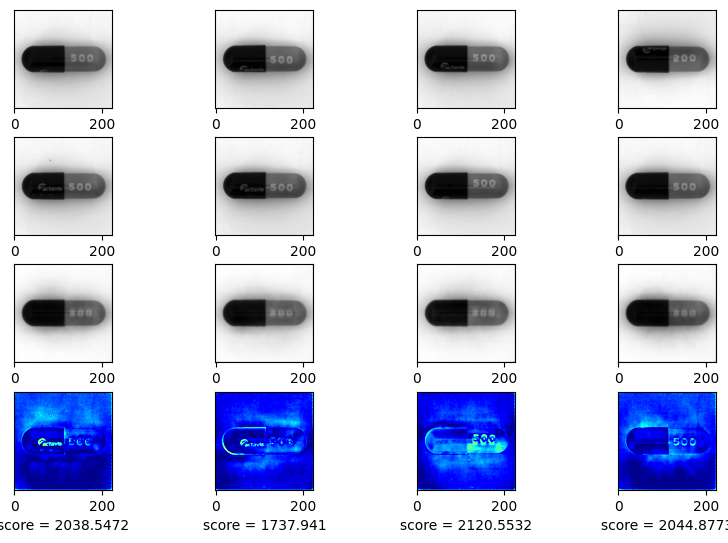

EPOCH 108/150
	 partial train loss (single batch): 0.508694
	 partial train loss (single batch): 0.257244
	 partial train loss (single batch): 0.311450
	 partial train loss (single batch): 0.352445
	 partial train loss (single batch): 0.314969
	 partial train loss (single batch): 0.363931
	 partial train loss (single batch): 0.224909
	 partial train loss (single batch): 0.449531
	 partial train loss (single batch): 0.376710
	 partial train loss (single batch): 0.349597
	 partial train loss (single batch): 0.704382
	 partial train loss (single batch): 0.426012
	 partial train loss (single batch): 0.435561
	 partial train loss (single batch): 0.507230
	 partial train loss (single batch): 0.299986
	 partial train loss (single batch): 0.616641
	 partial train loss (single batch): 0.453788
	 partial train loss (single batch): 0.374686
	 partial train loss (single batch): 0.707979
	 partial train loss (single batch): 0.328601
	 partial train loss (single batch): 0.483377
	 partial train loss

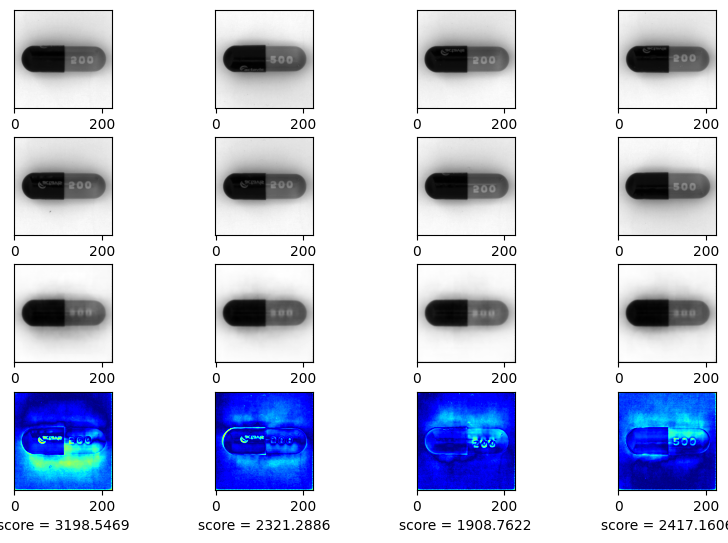

EPOCH 109/150
	 partial train loss (single batch): 0.330520
	 partial train loss (single batch): 0.614337
	 partial train loss (single batch): 0.627165
	 partial train loss (single batch): 0.324102
	 partial train loss (single batch): 0.610013
	 partial train loss (single batch): 0.366891
	 partial train loss (single batch): 0.537594
	 partial train loss (single batch): 0.500664
	 partial train loss (single batch): 0.497570
	 partial train loss (single batch): 0.526618
	 partial train loss (single batch): 0.610075
	 partial train loss (single batch): 0.410198
	 partial train loss (single batch): 0.701636
	 partial train loss (single batch): 0.481647
	 partial train loss (single batch): 0.544950
	 partial train loss (single batch): 0.528308
	 partial train loss (single batch): 0.588907
	 partial train loss (single batch): 0.511133
	 partial train loss (single batch): 0.484518
	 partial train loss (single batch): 0.390733
	 partial train loss (single batch): 0.416348
	 partial train loss

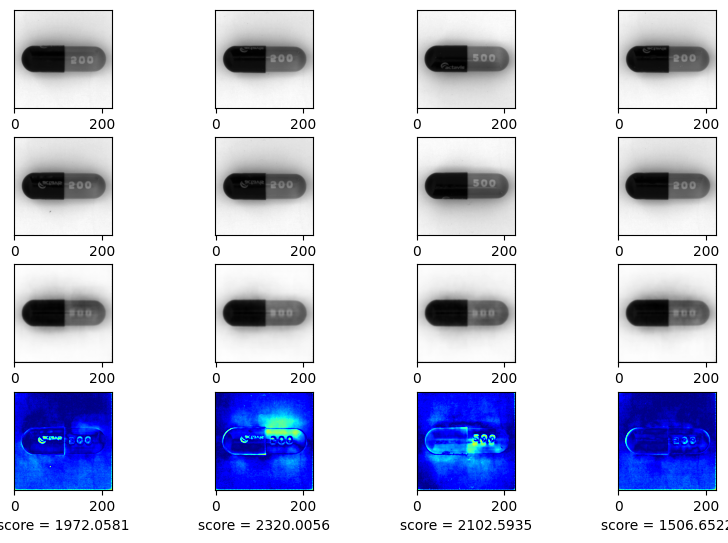

EPOCH 110/150
	 partial train loss (single batch): 0.414272
	 partial train loss (single batch): 0.323745
	 partial train loss (single batch): 0.526542
	 partial train loss (single batch): 0.302074
	 partial train loss (single batch): 0.298690
	 partial train loss (single batch): 0.580438
	 partial train loss (single batch): 0.540210
	 partial train loss (single batch): 0.285933
	 partial train loss (single batch): 0.400937
	 partial train loss (single batch): 0.323463
	 partial train loss (single batch): 0.486790
	 partial train loss (single batch): 0.387980
	 partial train loss (single batch): 0.322135
	 partial train loss (single batch): 0.402515
	 partial train loss (single batch): 0.706657
	 partial train loss (single batch): 0.338293
	 partial train loss (single batch): 0.384692
	 partial train loss (single batch): 0.508691
	 partial train loss (single batch): 0.288424
	 partial train loss (single batch): 0.383049
	 partial train loss (single batch): 0.408498
	 partial train loss

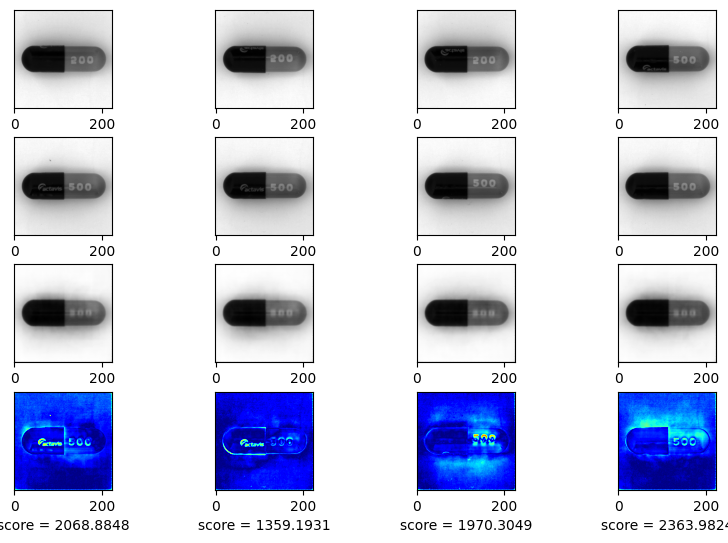

EPOCH 111/150
	 partial train loss (single batch): 0.401992
	 partial train loss (single batch): 0.485720
	 partial train loss (single batch): 0.255046
	 partial train loss (single batch): 0.447392
	 partial train loss (single batch): 0.346882
	 partial train loss (single batch): 0.280044
	 partial train loss (single batch): 0.402230
	 partial train loss (single batch): 0.344552
	 partial train loss (single batch): 0.271378
	 partial train loss (single batch): 0.267502
	 partial train loss (single batch): 0.278344
	 partial train loss (single batch): 0.251349
	 partial train loss (single batch): 0.269746
	 partial train loss (single batch): 0.251014
	 partial train loss (single batch): 0.309946
	 partial train loss (single batch): 0.258464
	 partial train loss (single batch): 0.276001
	 partial train loss (single batch): 0.308626
	 partial train loss (single batch): 0.305877
	 partial train loss (single batch): 0.298650
	 partial train loss (single batch): 0.257854
	 partial train loss

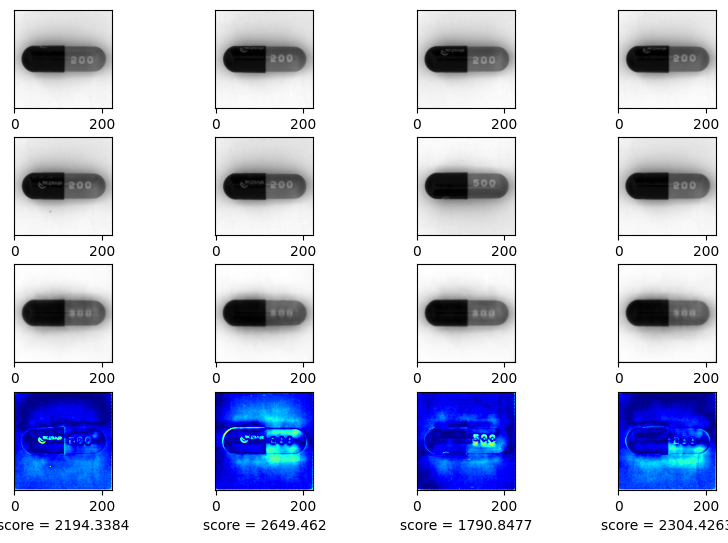

EPOCH 112/150
	 partial train loss (single batch): 0.296033
	 partial train loss (single batch): 0.289257
	 partial train loss (single batch): 0.346658
	 partial train loss (single batch): 0.309092
	 partial train loss (single batch): 0.281029
	 partial train loss (single batch): 0.282882
	 partial train loss (single batch): 0.284988
	 partial train loss (single batch): 0.382453
	 partial train loss (single batch): 0.273742
	 partial train loss (single batch): 0.316871
	 partial train loss (single batch): 0.493417
	 partial train loss (single batch): 0.336730
	 partial train loss (single batch): 0.397069
	 partial train loss (single batch): 0.653475
	 partial train loss (single batch): 0.719382
	 partial train loss (single batch): 0.252109
	 partial train loss (single batch): 0.586832
	 partial train loss (single batch): 0.369558
	 partial train loss (single batch): 0.308881
	 partial train loss (single batch): 0.278332
	 partial train loss (single batch): 0.240932
	 partial train loss

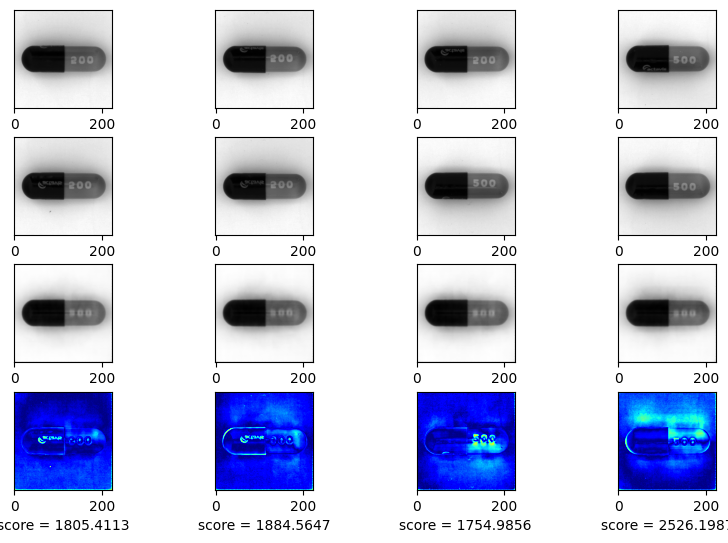

EPOCH 113/150
	 partial train loss (single batch): 0.290856
	 partial train loss (single batch): 0.392096
	 partial train loss (single batch): 0.627739
	 partial train loss (single batch): 0.420557
	 partial train loss (single batch): 0.386130
	 partial train loss (single batch): 0.495753
	 partial train loss (single batch): 0.410950
	 partial train loss (single batch): 0.266969
	 partial train loss (single batch): 0.501296
	 partial train loss (single batch): 0.407633
	 partial train loss (single batch): 0.257925
	 partial train loss (single batch): 0.469570
	 partial train loss (single batch): 0.318630
	 partial train loss (single batch): 0.306191
	 partial train loss (single batch): 0.354796
	 partial train loss (single batch): 0.246337
	 partial train loss (single batch): 0.300230
	 partial train loss (single batch): 0.271196
	 partial train loss (single batch): 0.309720
	 partial train loss (single batch): 0.294439
	 partial train loss (single batch): 0.253952
	 partial train loss

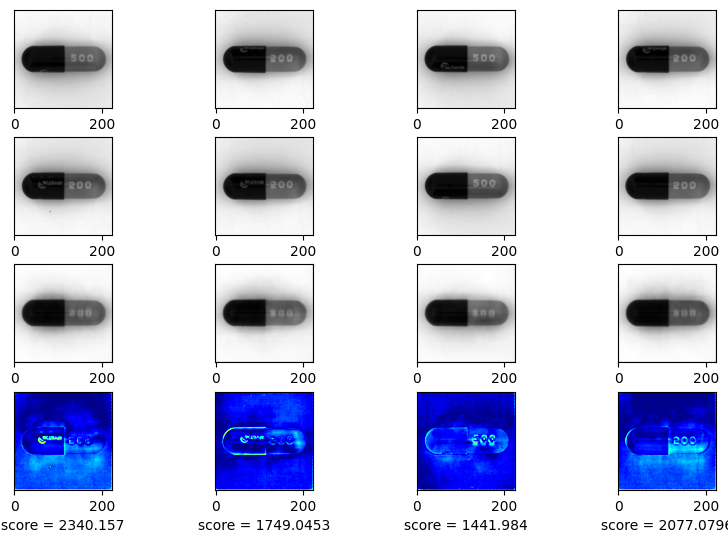

EPOCH 114/150
	 partial train loss (single batch): 0.325183
	 partial train loss (single batch): 0.391096
	 partial train loss (single batch): 0.409499
	 partial train loss (single batch): 0.276620
	 partial train loss (single batch): 0.452285
	 partial train loss (single batch): 0.351340
	 partial train loss (single batch): 0.305225
	 partial train loss (single batch): 0.304358
	 partial train loss (single batch): 0.394595
	 partial train loss (single batch): 0.316570
	 partial train loss (single batch): 0.368781
	 partial train loss (single batch): 0.372831
	 partial train loss (single batch): 0.322972
	 partial train loss (single batch): 0.301029
	 partial train loss (single batch): 0.387591
	 partial train loss (single batch): 0.292380
	 partial train loss (single batch): 0.411350
	 partial train loss (single batch): 0.257562
	 partial train loss (single batch): 0.458003
	 partial train loss (single batch): 0.272862
	 partial train loss (single batch): 0.326775
	 partial train loss

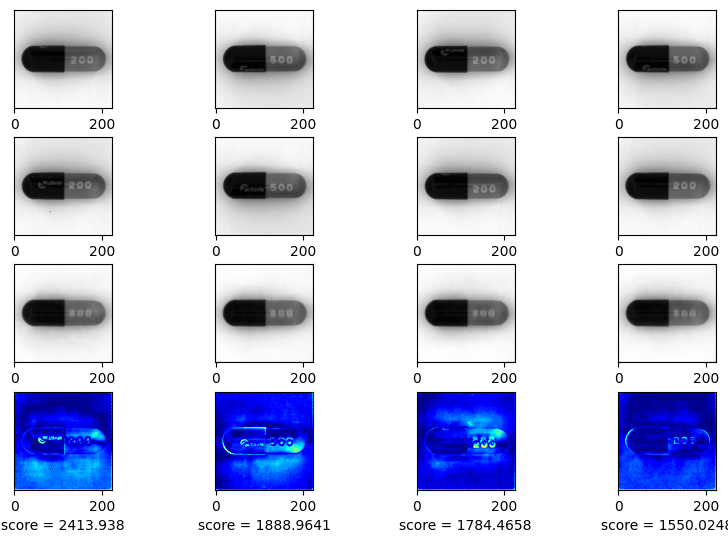

EPOCH 115/150
	 partial train loss (single batch): 0.354421
	 partial train loss (single batch): 0.227233
	 partial train loss (single batch): 0.320142
	 partial train loss (single batch): 0.245222
	 partial train loss (single batch): 0.400327
	 partial train loss (single batch): 0.276005
	 partial train loss (single batch): 0.292364
	 partial train loss (single batch): 0.291813
	 partial train loss (single batch): 0.251831
	 partial train loss (single batch): 0.337928
	 partial train loss (single batch): 0.337418
	 partial train loss (single batch): 0.210305
	 partial train loss (single batch): 0.325601
	 partial train loss (single batch): 0.244738
	 partial train loss (single batch): 0.290024
	 partial train loss (single batch): 0.223710
	 partial train loss (single batch): 0.513356
	 partial train loss (single batch): 0.218099
	 partial train loss (single batch): 0.297707
	 partial train loss (single batch): 0.223159
	 partial train loss (single batch): 0.298779
	 partial train loss

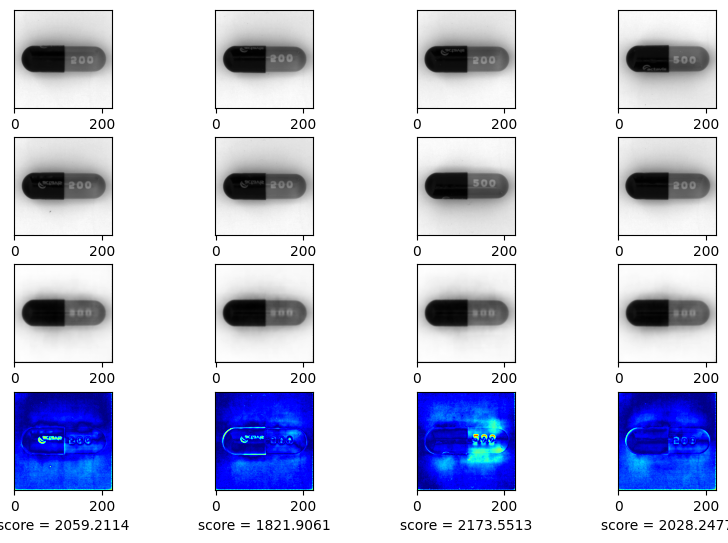

EPOCH 116/150
	 partial train loss (single batch): 0.284473
	 partial train loss (single batch): 0.304995
	 partial train loss (single batch): 0.297315
	 partial train loss (single batch): 0.254100
	 partial train loss (single batch): 0.277529
	 partial train loss (single batch): 0.257469
	 partial train loss (single batch): 0.413330
	 partial train loss (single batch): 0.722755
	 partial train loss (single batch): 0.422542
	 partial train loss (single batch): 0.289392
	 partial train loss (single batch): 0.733044
	 partial train loss (single batch): 0.424556
	 partial train loss (single batch): 0.288705
	 partial train loss (single batch): 0.591997
	 partial train loss (single batch): 0.388353
	 partial train loss (single batch): 0.274450
	 partial train loss (single batch): 0.597690
	 partial train loss (single batch): 0.327185
	 partial train loss (single batch): 0.449536
	 partial train loss (single batch): 0.526647
	 partial train loss (single batch): 0.304899
	 partial train loss

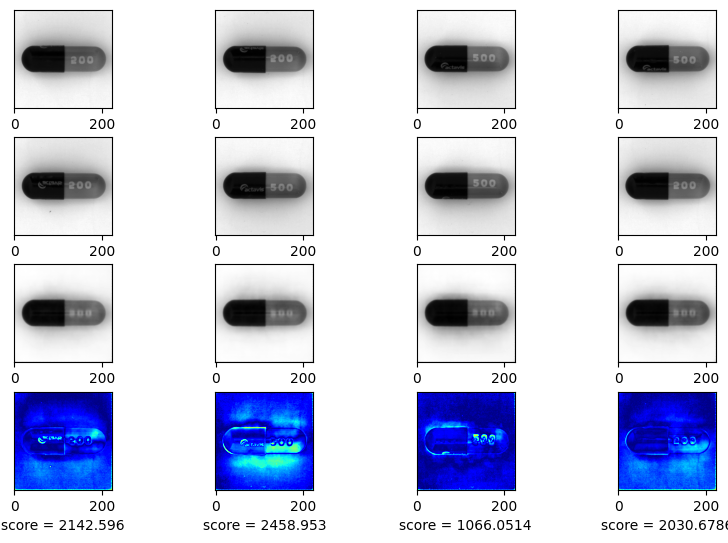

EPOCH 117/150
	 partial train loss (single batch): 0.295311
	 partial train loss (single batch): 0.297298
	 partial train loss (single batch): 0.391609
	 partial train loss (single batch): 0.254667
	 partial train loss (single batch): 0.365574
	 partial train loss (single batch): 0.353548
	 partial train loss (single batch): 0.210951
	 partial train loss (single batch): 0.406249
	 partial train loss (single batch): 0.507171
	 partial train loss (single batch): 0.313621
	 partial train loss (single batch): 0.200202
	 partial train loss (single batch): 0.447752
	 partial train loss (single batch): 0.428325
	 partial train loss (single batch): 0.309030
	 partial train loss (single batch): 0.318952
	 partial train loss (single batch): 0.548454
	 partial train loss (single batch): 0.377664
	 partial train loss (single batch): 0.277241
	 partial train loss (single batch): 0.302131
	 partial train loss (single batch): 0.216760
	 partial train loss (single batch): 0.295543
	 partial train loss

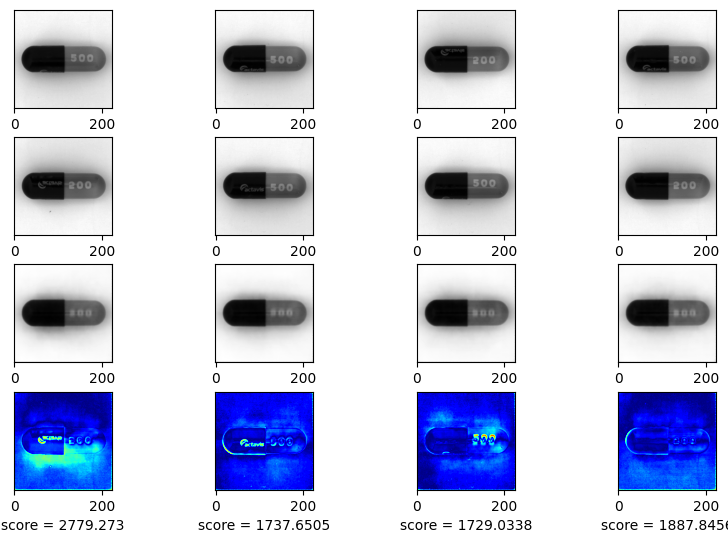

EPOCH 118/150
	 partial train loss (single batch): 0.274024
	 partial train loss (single batch): 0.315848
	 partial train loss (single batch): 0.391305
	 partial train loss (single batch): 0.445439
	 partial train loss (single batch): 0.267784
	 partial train loss (single batch): 0.225425
	 partial train loss (single batch): 0.370039
	 partial train loss (single batch): 0.465867
	 partial train loss (single batch): 0.355410
	 partial train loss (single batch): 0.369522
	 partial train loss (single batch): 0.771267
	 partial train loss (single batch): 0.425474
	 partial train loss (single batch): 0.403251
	 partial train loss (single batch): 0.618916
	 partial train loss (single batch): 0.427484
	 partial train loss (single batch): 0.255703
	 partial train loss (single batch): 0.595114
	 partial train loss (single batch): 0.576825
	 partial train loss (single batch): 0.208158
	 partial train loss (single batch): 0.460404
	 partial train loss (single batch): 0.380904
	 partial train loss

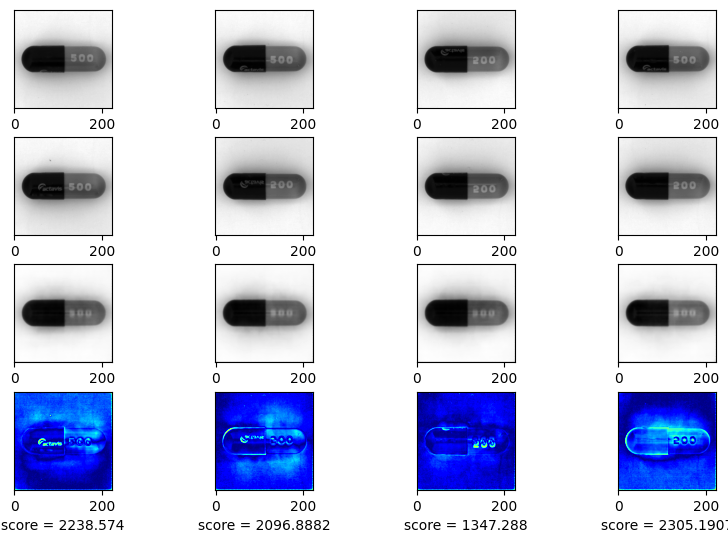

EPOCH 119/150
	 partial train loss (single batch): 0.520987
	 partial train loss (single batch): 0.413430
	 partial train loss (single batch): 0.312473
	 partial train loss (single batch): 0.334501
	 partial train loss (single batch): 0.369691
	 partial train loss (single batch): 0.219854
	 partial train loss (single batch): 0.318426
	 partial train loss (single batch): 0.296767
	 partial train loss (single batch): 0.198327
	 partial train loss (single batch): 0.343754
	 partial train loss (single batch): 0.270504
	 partial train loss (single batch): 0.253711
	 partial train loss (single batch): 0.382446
	 partial train loss (single batch): 0.312292
	 partial train loss (single batch): 0.332308
	 partial train loss (single batch): 0.239001
	 partial train loss (single batch): 0.350257
	 partial train loss (single batch): 0.232262
	 partial train loss (single batch): 0.337248
	 partial train loss (single batch): 0.338082
	 partial train loss (single batch): 0.277363
	 partial train loss

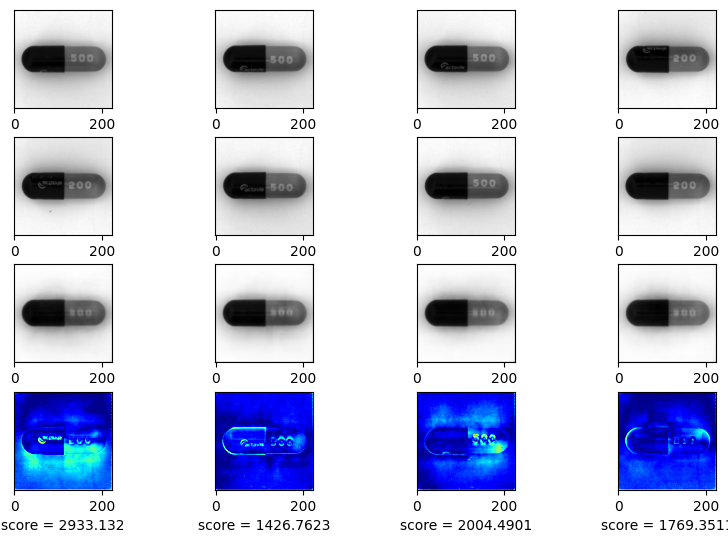

EPOCH 120/150
	 partial train loss (single batch): 0.294252
	 partial train loss (single batch): 0.329795
	 partial train loss (single batch): 0.265433
	 partial train loss (single batch): 0.362183
	 partial train loss (single batch): 0.278278
	 partial train loss (single batch): 0.363603
	 partial train loss (single batch): 0.315967
	 partial train loss (single batch): 0.441553
	 partial train loss (single batch): 0.279978
	 partial train loss (single batch): 0.494088
	 partial train loss (single batch): 0.383474
	 partial train loss (single batch): 0.337690
	 partial train loss (single batch): 0.448156
	 partial train loss (single batch): 0.270981
	 partial train loss (single batch): 0.400789
	 partial train loss (single batch): 0.277892
	 partial train loss (single batch): 0.352657
	 partial train loss (single batch): 0.314577
	 partial train loss (single batch): 0.252646
	 partial train loss (single batch): 0.380311
	 partial train loss (single batch): 0.259658
	 partial train loss

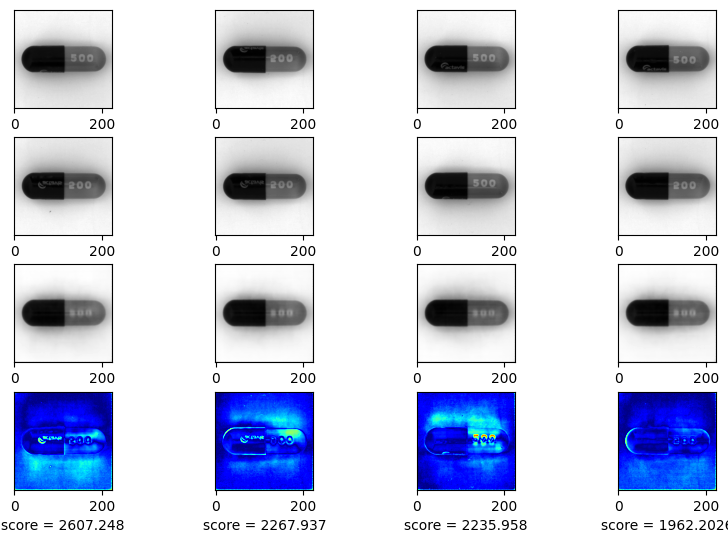

EPOCH 121/150
	 partial train loss (single batch): 0.318665
	 partial train loss (single batch): 0.219716
	 partial train loss (single batch): 0.377888
	 partial train loss (single batch): 0.598799
	 partial train loss (single batch): 0.428457
	 partial train loss (single batch): 0.256764
	 partial train loss (single batch): 0.598179
	 partial train loss (single batch): 0.386916
	 partial train loss (single batch): 0.423857
	 partial train loss (single batch): 0.749920
	 partial train loss (single batch): 0.463754
	 partial train loss (single batch): 0.611461
	 partial train loss (single batch): 0.247591
	 partial train loss (single batch): 0.492028
	 partial train loss (single batch): 0.300644
	 partial train loss (single batch): 0.622029
	 partial train loss (single batch): 0.445619
	 partial train loss (single batch): 0.287466
	 partial train loss (single batch): 0.290109
	 partial train loss (single batch): 0.346530
	 partial train loss (single batch): 0.252632
	 partial train loss

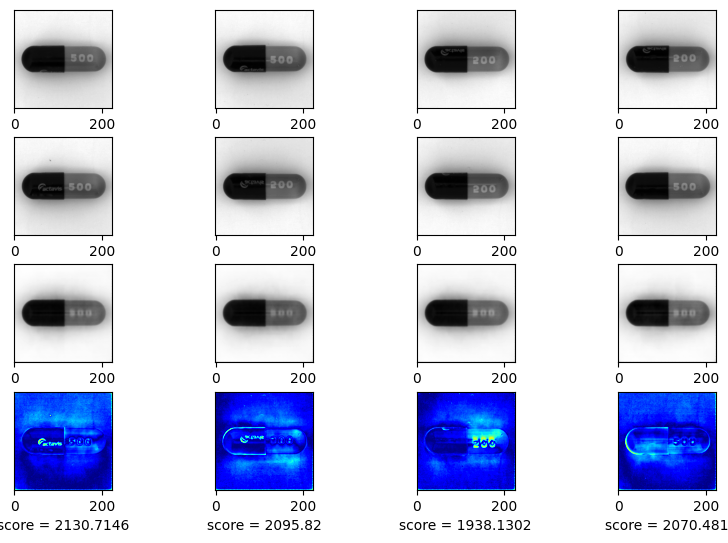

EPOCH 122/150
	 partial train loss (single batch): 0.329211
	 partial train loss (single batch): 0.359260
	 partial train loss (single batch): 0.714755
	 partial train loss (single batch): 0.709503
	 partial train loss (single batch): 0.333544
	 partial train loss (single batch): 0.498609
	 partial train loss (single batch): 0.584994
	 partial train loss (single batch): 0.408026
	 partial train loss (single batch): 0.299395
	 partial train loss (single batch): 0.571305
	 partial train loss (single batch): 0.544817
	 partial train loss (single batch): 0.281136
	 partial train loss (single batch): 0.316284
	 partial train loss (single batch): 0.384072
	 partial train loss (single batch): 0.242368
	 partial train loss (single batch): 0.487951
	 partial train loss (single batch): 0.595438
	 partial train loss (single batch): 0.385109
	 partial train loss (single batch): 0.328862
	 partial train loss (single batch): 0.605625
	 partial train loss (single batch): 0.380112
	 partial train loss

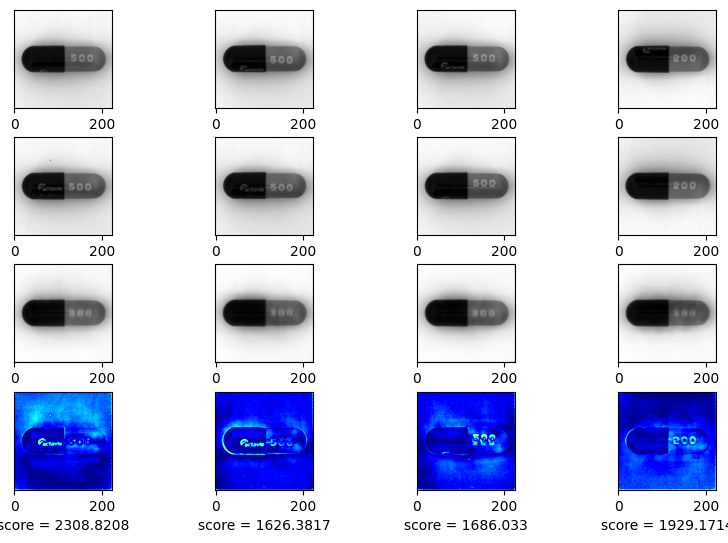

EPOCH 123/150
	 partial train loss (single batch): 0.407789
	 partial train loss (single batch): 0.325380
	 partial train loss (single batch): 0.329643
	 partial train loss (single batch): 0.707536
	 partial train loss (single batch): 0.476129
	 partial train loss (single batch): 0.248758
	 partial train loss (single batch): 0.589398
	 partial train loss (single batch): 0.621829
	 partial train loss (single batch): 0.239717
	 partial train loss (single batch): 0.370968
	 partial train loss (single batch): 0.648223
	 partial train loss (single batch): 0.339508
	 partial train loss (single batch): 0.318941
	 partial train loss (single batch): 0.299028
	 partial train loss (single batch): 0.386459
	 partial train loss (single batch): 0.272836
	 partial train loss (single batch): 0.339026
	 partial train loss (single batch): 0.574593
	 partial train loss (single batch): 0.560488
	 partial train loss (single batch): 0.220132
	 partial train loss (single batch): 0.635236
	 partial train loss

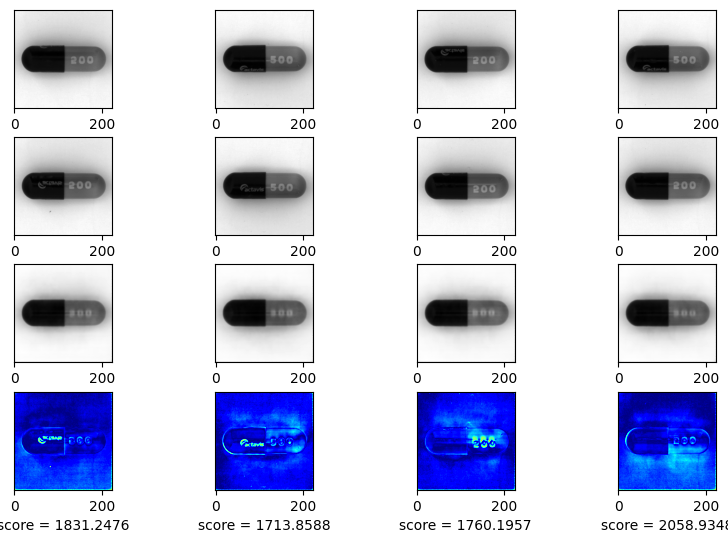

EPOCH 124/150
	 partial train loss (single batch): 0.424335
	 partial train loss (single batch): 0.863336
	 partial train loss (single batch): 0.689514
	 partial train loss (single batch): 0.510115
	 partial train loss (single batch): 0.371270
	 partial train loss (single batch): 0.659361
	 partial train loss (single batch): 0.256620
	 partial train loss (single batch): 0.566486
	 partial train loss (single batch): 0.299294
	 partial train loss (single batch): 0.556212
	 partial train loss (single batch): 0.767716
	 partial train loss (single batch): 0.734607
	 partial train loss (single batch): 0.342142
	 partial train loss (single batch): 0.463867
	 partial train loss (single batch): 0.809389
	 partial train loss (single batch): 0.432211
	 partial train loss (single batch): 0.507724
	 partial train loss (single batch): 0.333861
	 partial train loss (single batch): 0.622504
	 partial train loss (single batch): 0.610385
	 partial train loss (single batch): 0.324154
	 partial train loss

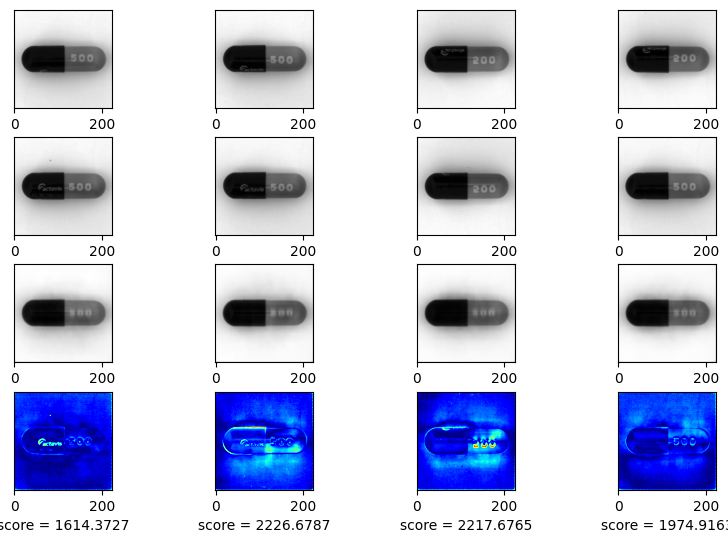

EPOCH 125/150
	 partial train loss (single batch): 0.605246
	 partial train loss (single batch): 0.450583
	 partial train loss (single batch): 0.242782
	 partial train loss (single batch): 0.474733
	 partial train loss (single batch): 0.394862
	 partial train loss (single batch): 0.281705
	 partial train loss (single batch): 0.332464
	 partial train loss (single batch): 0.474278
	 partial train loss (single batch): 0.258333
	 partial train loss (single batch): 0.311300
	 partial train loss (single batch): 0.240034
	 partial train loss (single batch): 0.328143
	 partial train loss (single batch): 0.189517
	 partial train loss (single batch): 0.254273
	 partial train loss (single batch): 0.213793
	 partial train loss (single batch): 0.211604
	 partial train loss (single batch): 0.231709
	 partial train loss (single batch): 0.242826
	 partial train loss (single batch): 0.267914
	 partial train loss (single batch): 0.288441
	 partial train loss (single batch): 0.319854
	 partial train loss

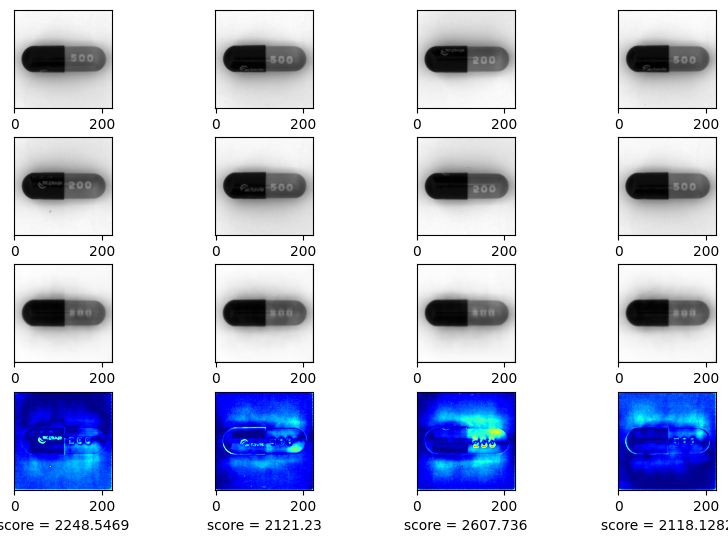

EPOCH 126/150
	 partial train loss (single batch): 0.335855
	 partial train loss (single batch): 0.321541
	 partial train loss (single batch): 0.233802
	 partial train loss (single batch): 0.497538
	 partial train loss (single batch): 0.397948
	 partial train loss (single batch): 0.335505
	 partial train loss (single batch): 0.300833
	 partial train loss (single batch): 0.529663
	 partial train loss (single batch): 0.291548
	 partial train loss (single batch): 0.359795
	 partial train loss (single batch): 0.399642
	 partial train loss (single batch): 0.267104
	 partial train loss (single batch): 0.329922
	 partial train loss (single batch): 0.256704
	 partial train loss (single batch): 0.360515
	 partial train loss (single batch): 0.234159
	 partial train loss (single batch): 0.346745
	 partial train loss (single batch): 0.228946
	 partial train loss (single batch): 0.462502
	 partial train loss (single batch): 0.331549
	 partial train loss (single batch): 0.414185
	 partial train loss

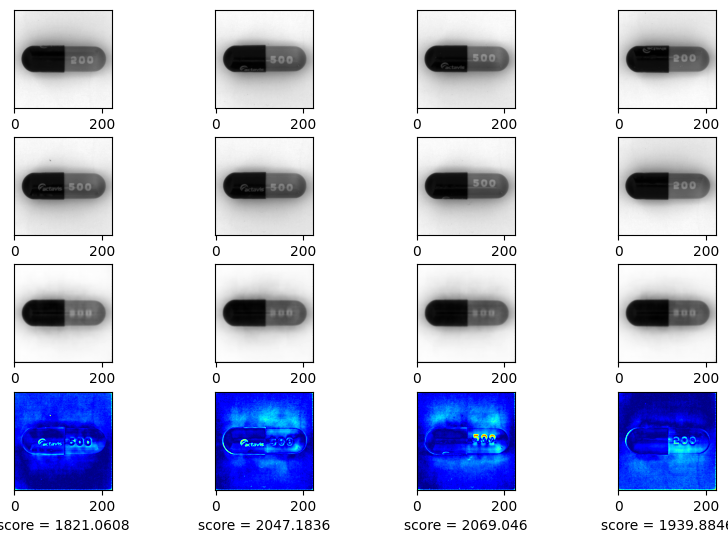

EPOCH 127/150
	 partial train loss (single batch): 0.365624
	 partial train loss (single batch): 0.500518
	 partial train loss (single batch): 0.355338
	 partial train loss (single batch): 0.725356
	 partial train loss (single batch): 0.348137
	 partial train loss (single batch): 0.619408
	 partial train loss (single batch): 0.495227
	 partial train loss (single batch): 0.512079
	 partial train loss (single batch): 0.372489
	 partial train loss (single batch): 0.326896
	 partial train loss (single batch): 0.355975
	 partial train loss (single batch): 0.269613
	 partial train loss (single batch): 0.439801
	 partial train loss (single batch): 0.336076
	 partial train loss (single batch): 0.482548
	 partial train loss (single batch): 0.318191
	 partial train loss (single batch): 0.337397
	 partial train loss (single batch): 0.238641
	 partial train loss (single batch): 0.364125
	 partial train loss (single batch): 0.341307
	 partial train loss (single batch): 0.210180
	 partial train loss

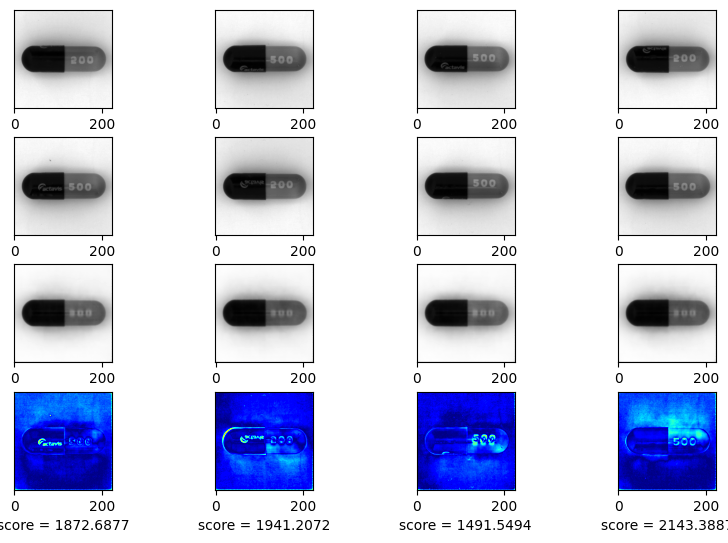

EPOCH 128/150
	 partial train loss (single batch): 0.243243
	 partial train loss (single batch): 0.220675
	 partial train loss (single batch): 0.289214
	 partial train loss (single batch): 0.281830
	 partial train loss (single batch): 0.259695
	 partial train loss (single batch): 0.294982
	 partial train loss (single batch): 0.274563
	 partial train loss (single batch): 0.256454
	 partial train loss (single batch): 0.394161
	 partial train loss (single batch): 0.504449
	 partial train loss (single batch): 0.335687
	 partial train loss (single batch): 0.205610
	 partial train loss (single batch): 0.210259
	 partial train loss (single batch): 0.230349
	 partial train loss (single batch): 0.236868
	 partial train loss (single batch): 0.284330
	 partial train loss (single batch): 0.317345
	 partial train loss (single batch): 0.269319
	 partial train loss (single batch): 0.295755
	 partial train loss (single batch): 0.344983
	 partial train loss (single batch): 0.385462
	 partial train loss

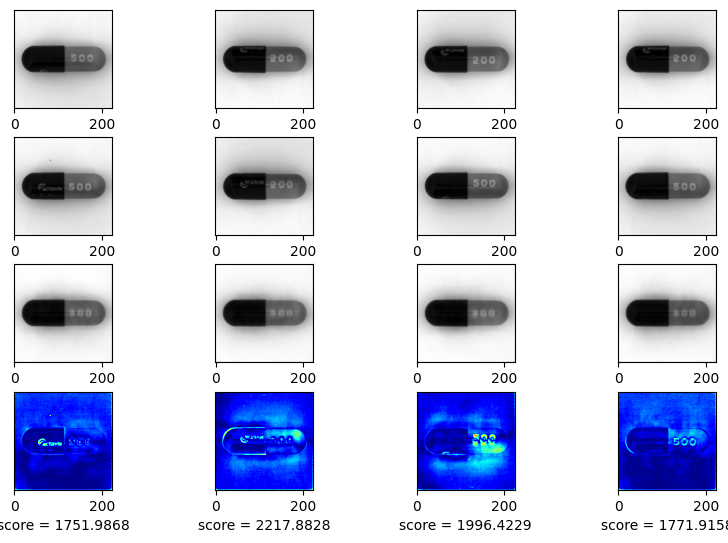

EPOCH 129/150
	 partial train loss (single batch): 0.236753
	 partial train loss (single batch): 0.430364
	 partial train loss (single batch): 0.500107
	 partial train loss (single batch): 0.484936
	 partial train loss (single batch): 0.319890
	 partial train loss (single batch): 0.241129
	 partial train loss (single batch): 0.332916
	 partial train loss (single batch): 0.360597
	 partial train loss (single batch): 0.290956
	 partial train loss (single batch): 0.230786
	 partial train loss (single batch): 0.289215
	 partial train loss (single batch): 0.292102
	 partial train loss (single batch): 0.240023
	 partial train loss (single batch): 0.224910
	 partial train loss (single batch): 0.259612
	 partial train loss (single batch): 0.399572
	 partial train loss (single batch): 0.474961
	 partial train loss (single batch): 0.290210
	 partial train loss (single batch): 0.447201
	 partial train loss (single batch): 0.321726
	 partial train loss (single batch): 0.425389
	 partial train loss

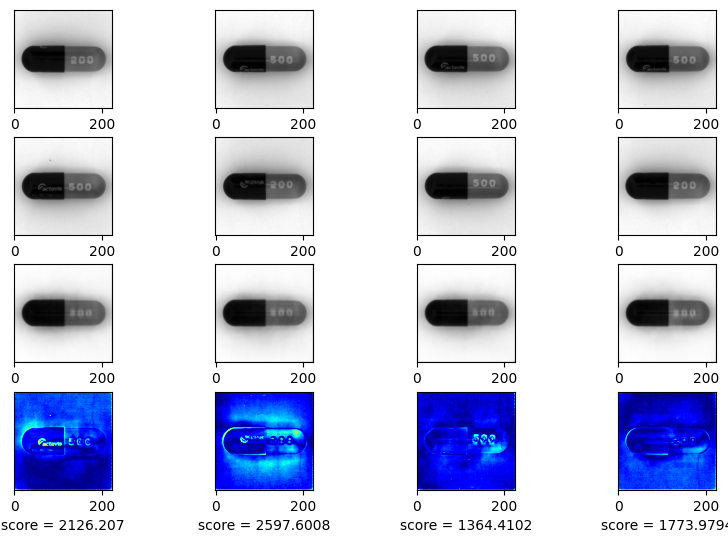

EPOCH 130/150
	 partial train loss (single batch): 0.358968
	 partial train loss (single batch): 0.502128
	 partial train loss (single batch): 0.596072
	 partial train loss (single batch): 0.354210
	 partial train loss (single batch): 0.350353
	 partial train loss (single batch): 0.534073
	 partial train loss (single batch): 0.406290
	 partial train loss (single batch): 0.356649
	 partial train loss (single batch): 0.242054
	 partial train loss (single batch): 0.378836
	 partial train loss (single batch): 0.244490
	 partial train loss (single batch): 0.330815
	 partial train loss (single batch): 0.315483
	 partial train loss (single batch): 0.556252
	 partial train loss (single batch): 0.273173
	 partial train loss (single batch): 0.345923
	 partial train loss (single batch): 0.489614
	 partial train loss (single batch): 0.393496
	 partial train loss (single batch): 0.225994
	 partial train loss (single batch): 0.578534
	 partial train loss (single batch): 0.690060
	 partial train loss

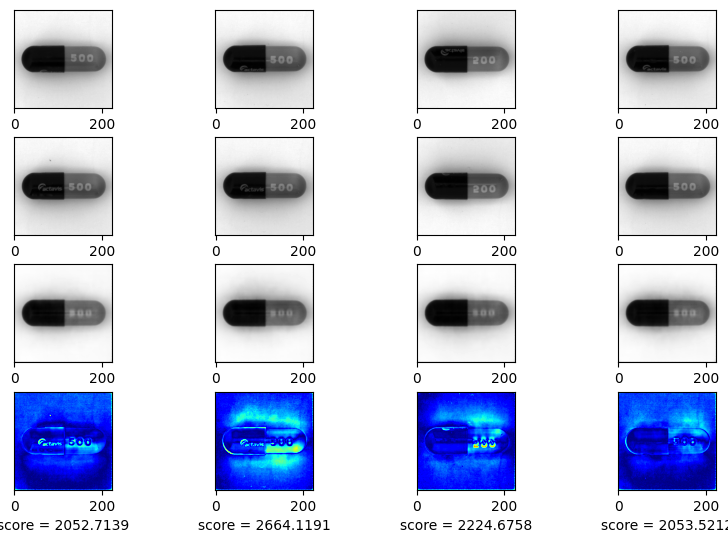

EPOCH 131/150
	 partial train loss (single batch): 0.489549
	 partial train loss (single batch): 1.108484
	 partial train loss (single batch): 1.388515
	 partial train loss (single batch): 0.704741
	 partial train loss (single batch): 0.298778
	 partial train loss (single batch): 0.629097
	 partial train loss (single batch): 1.225867
	 partial train loss (single batch): 1.068979
	 partial train loss (single batch): 0.388017
	 partial train loss (single batch): 0.296617
	 partial train loss (single batch): 0.726732
	 partial train loss (single batch): 0.571808
	 partial train loss (single batch): 0.268192
	 partial train loss (single batch): 0.541989
	 partial train loss (single batch): 0.685838
	 partial train loss (single batch): 0.339024
	 partial train loss (single batch): 0.414182
	 partial train loss (single batch): 0.821599
	 partial train loss (single batch): 0.692134
	 partial train loss (single batch): 0.288532
	 partial train loss (single batch): 0.563308
	 partial train loss

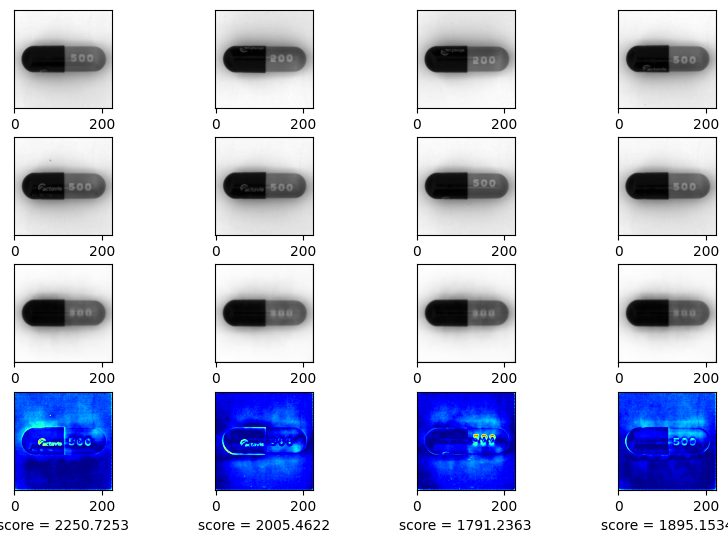

EPOCH 132/150
	 partial train loss (single batch): 0.267623
	 partial train loss (single batch): 1.016807
	 partial train loss (single batch): 2.152560
	 partial train loss (single batch): 1.699235
	 partial train loss (single batch): 0.428867
	 partial train loss (single batch): 0.523425
	 partial train loss (single batch): 1.442441
	 partial train loss (single batch): 1.046223
	 partial train loss (single batch): 0.224447
	 partial train loss (single batch): 1.463724
	 partial train loss (single batch): 2.571988
	 partial train loss (single batch): 1.333700
	 partial train loss (single batch): 0.334054
	 partial train loss (single batch): 1.016479
	 partial train loss (single batch): 1.802995
	 partial train loss (single batch): 0.855139
	 partial train loss (single batch): 0.435069
	 partial train loss (single batch): 2.399053
	 partial train loss (single batch): 2.708169
	 partial train loss (single batch): 0.644900
	 partial train loss (single batch): 0.764348
	 partial train loss

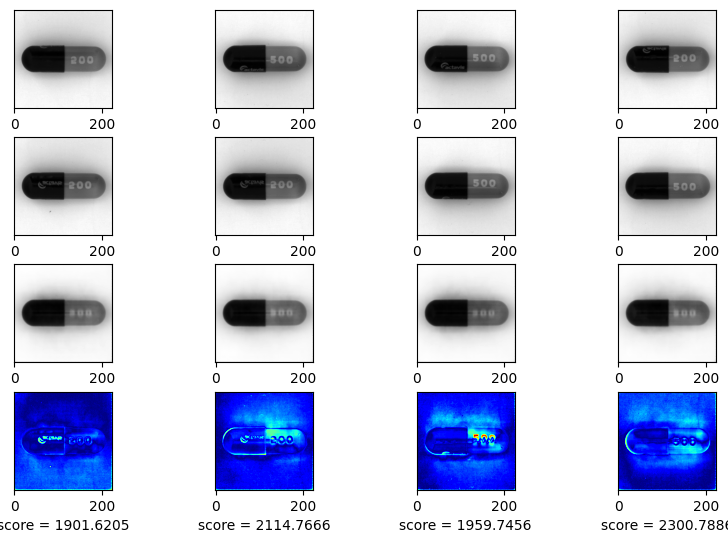

EPOCH 133/150
	 partial train loss (single batch): 0.930116
	 partial train loss (single batch): 0.433842
	 partial train loss (single batch): 2.067375
	 partial train loss (single batch): 1.571491
	 partial train loss (single batch): 0.298232
	 partial train loss (single batch): 1.257436
	 partial train loss (single batch): 2.080924
	 partial train loss (single batch): 0.992383
	 partial train loss (single batch): 0.242024
	 partial train loss (single batch): 1.100865
	 partial train loss (single batch): 1.149968
	 partial train loss (single batch): 0.445415
	 partial train loss (single batch): 0.379183
	 partial train loss (single batch): 0.659949
	 partial train loss (single batch): 0.697727
	 partial train loss (single batch): 0.271170
	 partial train loss (single batch): 0.347798
	 partial train loss (single batch): 0.373306
	 partial train loss (single batch): 0.236441
	 partial train loss (single batch): 0.318448
	 partial train loss (single batch): 0.205264
	 partial train loss

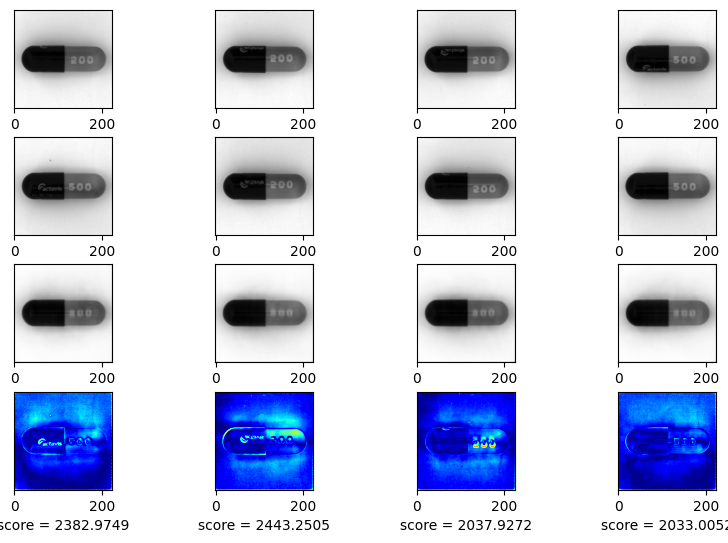

EPOCH 134/150
	 partial train loss (single batch): 0.225435
	 partial train loss (single batch): 0.203887
	 partial train loss (single batch): 0.333642
	 partial train loss (single batch): 0.408855
	 partial train loss (single batch): 0.261197
	 partial train loss (single batch): 0.257152
	 partial train loss (single batch): 0.487845
	 partial train loss (single batch): 0.319550
	 partial train loss (single batch): 0.380684
	 partial train loss (single batch): 0.635127
	 partial train loss (single batch): 0.485960
	 partial train loss (single batch): 0.259197
	 partial train loss (single batch): 0.354746
	 partial train loss (single batch): 0.378737
	 partial train loss (single batch): 0.271373
	 partial train loss (single batch): 0.221534
	 partial train loss (single batch): 0.286367
	 partial train loss (single batch): 0.477625
	 partial train loss (single batch): 0.399815
	 partial train loss (single batch): 0.235398
	 partial train loss (single batch): 0.298437
	 partial train loss

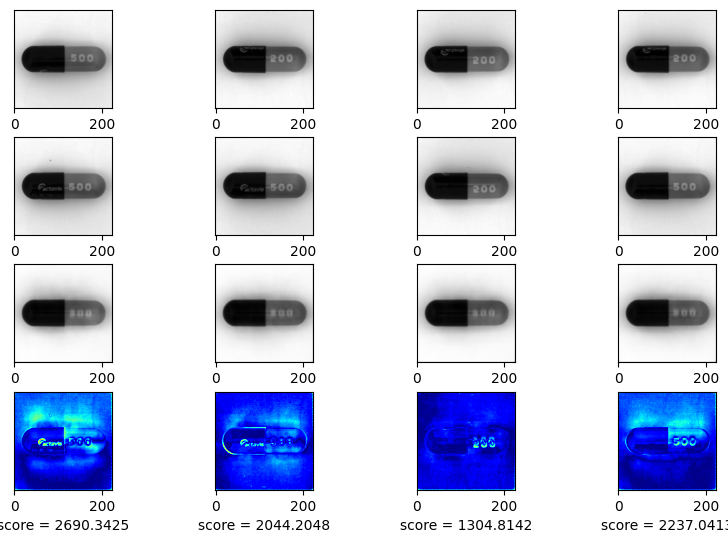

EPOCH 135/150
	 partial train loss (single batch): 0.298342
	 partial train loss (single batch): 0.289286
	 partial train loss (single batch): 0.604034
	 partial train loss (single batch): 0.569065
	 partial train loss (single batch): 0.478842
	 partial train loss (single batch): 0.461817
	 partial train loss (single batch): 0.458811
	 partial train loss (single batch): 0.517690
	 partial train loss (single batch): 0.301134
	 partial train loss (single batch): 0.592170
	 partial train loss (single batch): 0.777973
	 partial train loss (single batch): 0.337237
	 partial train loss (single batch): 0.307523
	 partial train loss (single batch): 0.664837
	 partial train loss (single batch): 0.530007
	 partial train loss (single batch): 0.265903
	 partial train loss (single batch): 0.477483
	 partial train loss (single batch): 0.705632
	 partial train loss (single batch): 0.351719
	 partial train loss (single batch): 0.329807
	 partial train loss (single batch): 1.066799
	 partial train loss

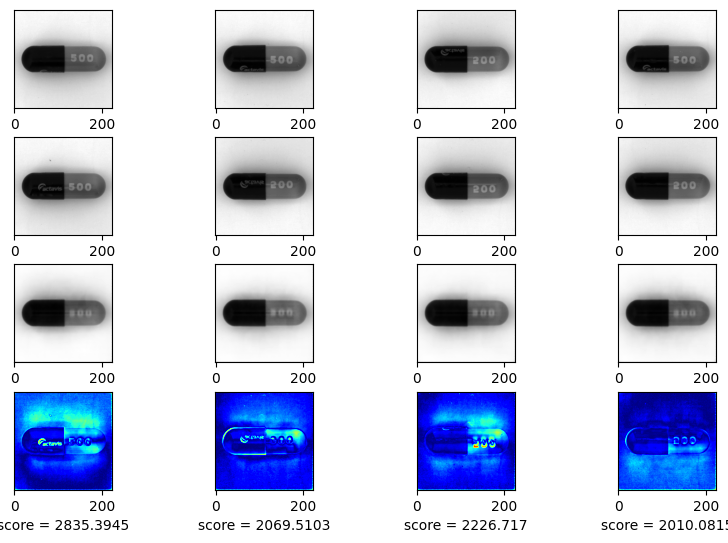

EPOCH 136/150
	 partial train loss (single batch): 0.255348
	 partial train loss (single batch): 0.799480
	 partial train loss (single batch): 1.083025
	 partial train loss (single batch): 0.571535
	 partial train loss (single batch): 0.420529
	 partial train loss (single batch): 1.058320
	 partial train loss (single batch): 1.307146
	 partial train loss (single batch): 0.430812
	 partial train loss (single batch): 0.280641
	 partial train loss (single batch): 0.338024
	 partial train loss (single batch): 0.365233
	 partial train loss (single batch): 0.340705
	 partial train loss (single batch): 0.258133
	 partial train loss (single batch): 0.499128
	 partial train loss (single batch): 0.272622
	 partial train loss (single batch): 0.660800
	 partial train loss (single batch): 0.336131
	 partial train loss (single batch): 0.416462
	 partial train loss (single batch): 0.434810
	 partial train loss (single batch): 0.282707
	 partial train loss (single batch): 0.525222
	 partial train loss

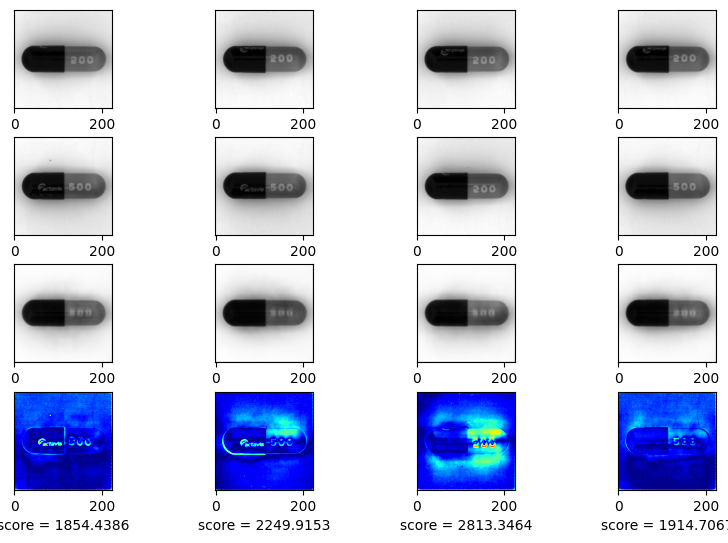

EPOCH 137/150
	 partial train loss (single batch): 0.669595
	 partial train loss (single batch): 0.404879
	 partial train loss (single batch): 0.315242
	 partial train loss (single batch): 0.499116
	 partial train loss (single batch): 0.190612
	 partial train loss (single batch): 0.396770
	 partial train loss (single batch): 0.267323
	 partial train loss (single batch): 0.262905
	 partial train loss (single batch): 0.282947
	 partial train loss (single batch): 0.265092
	 partial train loss (single batch): 0.351575
	 partial train loss (single batch): 0.333604
	 partial train loss (single batch): 0.298238
	 partial train loss (single batch): 0.304354
	 partial train loss (single batch): 0.206243
	 partial train loss (single batch): 0.281687
	 partial train loss (single batch): 0.323810
	 partial train loss (single batch): 0.236502
	 partial train loss (single batch): 0.238706
	 partial train loss (single batch): 0.296711
	 partial train loss (single batch): 0.251691
	 partial train loss

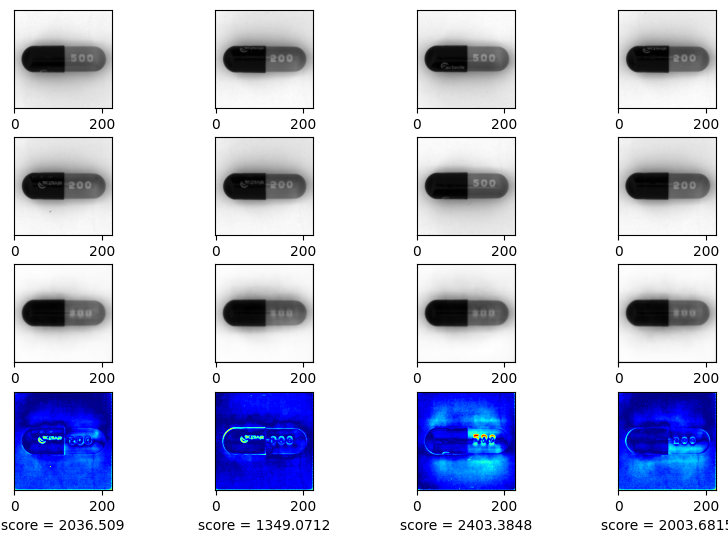

EPOCH 138/150
	 partial train loss (single batch): 0.363240
	 partial train loss (single batch): 0.392579
	 partial train loss (single batch): 0.308603
	 partial train loss (single batch): 0.296914
	 partial train loss (single batch): 0.441234
	 partial train loss (single batch): 0.571395
	 partial train loss (single batch): 0.274934
	 partial train loss (single batch): 0.709989
	 partial train loss (single batch): 1.003733
	 partial train loss (single batch): 0.553236
	 partial train loss (single batch): 0.245492
	 partial train loss (single batch): 0.778802
	 partial train loss (single batch): 1.250930
	 partial train loss (single batch): 0.731136
	 partial train loss (single batch): 0.220383
	 partial train loss (single batch): 0.639470
	 partial train loss (single batch): 0.612113
	 partial train loss (single batch): 0.277839
	 partial train loss (single batch): 0.680483
	 partial train loss (single batch): 0.650657
	 partial train loss (single batch): 0.320341
	 partial train loss

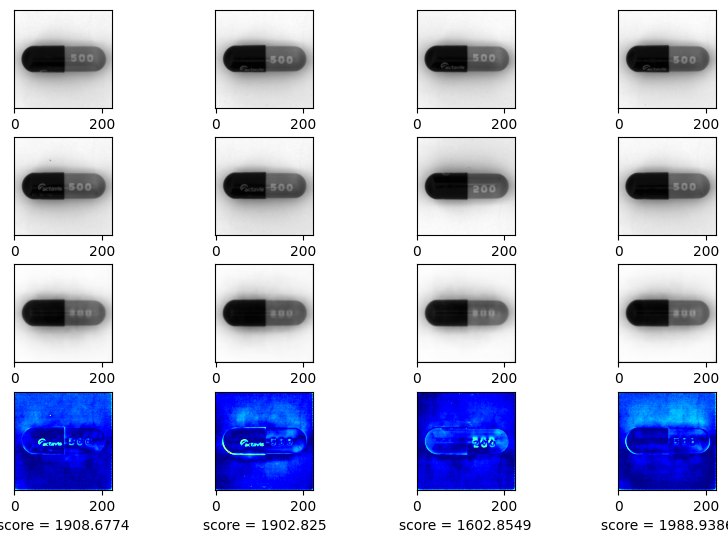

EPOCH 139/150
	 partial train loss (single batch): 1.040328
	 partial train loss (single batch): 0.368765
	 partial train loss (single batch): 0.677759
	 partial train loss (single batch): 1.258976
	 partial train loss (single batch): 0.731099
	 partial train loss (single batch): 0.237809
	 partial train loss (single batch): 0.595575
	 partial train loss (single batch): 1.067312
	 partial train loss (single batch): 0.751852
	 partial train loss (single batch): 0.280223
	 partial train loss (single batch): 0.395207
	 partial train loss (single batch): 0.752625
	 partial train loss (single batch): 0.503275
	 partial train loss (single batch): 0.340966
	 partial train loss (single batch): 0.297321
	 partial train loss (single batch): 0.400880
	 partial train loss (single batch): 0.294332
	 partial train loss (single batch): 0.198028
	 partial train loss (single batch): 0.386475
	 partial train loss (single batch): 0.582006
	 partial train loss (single batch): 0.368862
	 partial train loss

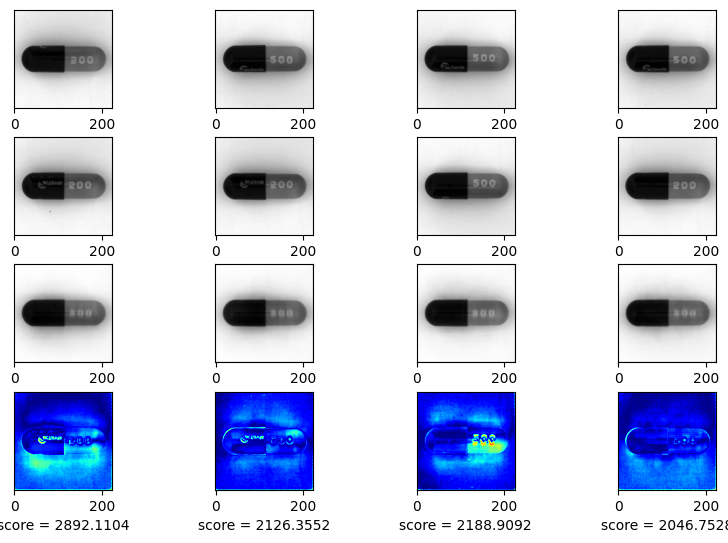

EPOCH 140/150
	 partial train loss (single batch): 0.367362
	 partial train loss (single batch): 0.323074
	 partial train loss (single batch): 0.276029
	 partial train loss (single batch): 0.266536
	 partial train loss (single batch): 0.348608
	 partial train loss (single batch): 0.357981
	 partial train loss (single batch): 0.229559
	 partial train loss (single batch): 0.326149
	 partial train loss (single batch): 0.449693
	 partial train loss (single batch): 0.301128
	 partial train loss (single batch): 0.296127
	 partial train loss (single batch): 0.277961
	 partial train loss (single batch): 0.279270
	 partial train loss (single batch): 0.381222
	 partial train loss (single batch): 0.237071
	 partial train loss (single batch): 0.312955
	 partial train loss (single batch): 0.303321
	 partial train loss (single batch): 0.276181
	 partial train loss (single batch): 0.382255
	 partial train loss (single batch): 0.269169
	 partial train loss (single batch): 0.383250
	 partial train loss

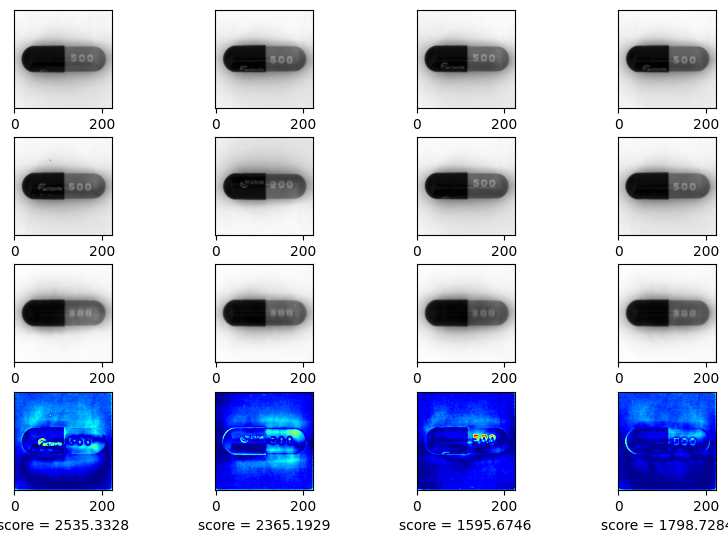

EPOCH 141/150
	 partial train loss (single batch): 0.265368
	 partial train loss (single batch): 0.279668
	 partial train loss (single batch): 0.369246
	 partial train loss (single batch): 0.682139
	 partial train loss (single batch): 0.527665
	 partial train loss (single batch): 0.286922
	 partial train loss (single batch): 0.432788
	 partial train loss (single batch): 0.416204
	 partial train loss (single batch): 0.327961
	 partial train loss (single batch): 0.267858
	 partial train loss (single batch): 0.326639
	 partial train loss (single batch): 0.372073
	 partial train loss (single batch): 0.270596
	 partial train loss (single batch): 0.227767
	 partial train loss (single batch): 0.242544
	 partial train loss (single batch): 0.249144
	 partial train loss (single batch): 0.209796
	 partial train loss (single batch): 0.424971
	 partial train loss (single batch): 0.474502
	 partial train loss (single batch): 0.523726
	 partial train loss (single batch): 0.507313
	 partial train loss

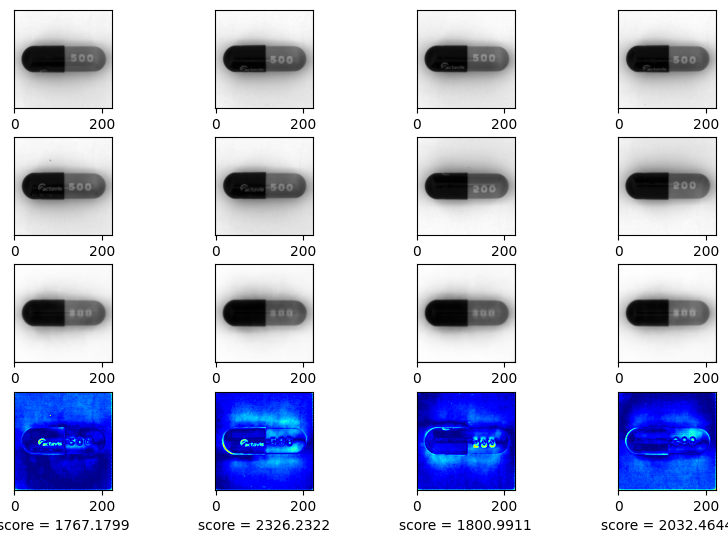

EPOCH 142/150
	 partial train loss (single batch): 0.313641
	 partial train loss (single batch): 0.299854
	 partial train loss (single batch): 0.290503
	 partial train loss (single batch): 0.331075
	 partial train loss (single batch): 0.202397
	 partial train loss (single batch): 0.491383
	 partial train loss (single batch): 0.509409
	 partial train loss (single batch): 0.391953
	 partial train loss (single batch): 0.234940
	 partial train loss (single batch): 0.270096
	 partial train loss (single batch): 0.512861
	 partial train loss (single batch): 0.459358
	 partial train loss (single batch): 0.393337
	 partial train loss (single batch): 0.419918
	 partial train loss (single batch): 0.555197
	 partial train loss (single batch): 0.996987
	 partial train loss (single batch): 0.561748
	 partial train loss (single batch): 0.258557
	 partial train loss (single batch): 0.451502
	 partial train loss (single batch): 0.516103
	 partial train loss (single batch): 0.507294
	 partial train loss

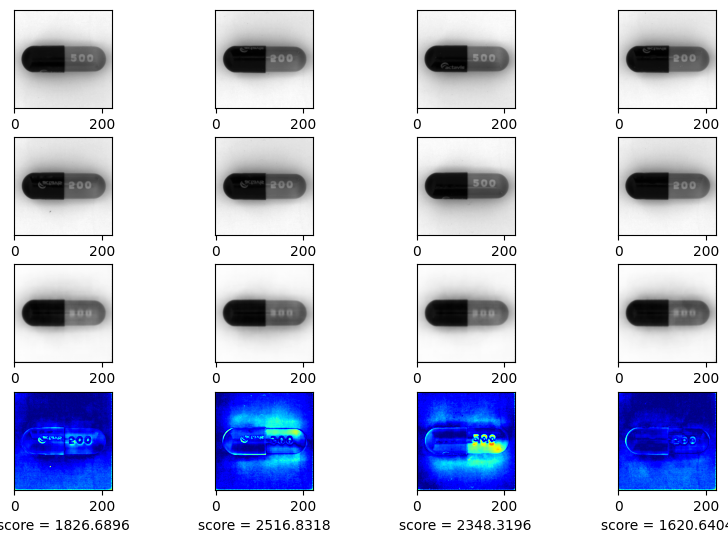

EPOCH 143/150
	 partial train loss (single batch): 0.298746
	 partial train loss (single batch): 0.458947
	 partial train loss (single batch): 0.319910
	 partial train loss (single batch): 0.290666
	 partial train loss (single batch): 0.306093
	 partial train loss (single batch): 0.245393
	 partial train loss (single batch): 0.222706
	 partial train loss (single batch): 0.235392
	 partial train loss (single batch): 0.350757
	 partial train loss (single batch): 0.248346
	 partial train loss (single batch): 0.257554
	 partial train loss (single batch): 0.216624
	 partial train loss (single batch): 0.280778
	 partial train loss (single batch): 0.241853
	 partial train loss (single batch): 0.268668
	 partial train loss (single batch): 0.297265
	 partial train loss (single batch): 0.316811
	 partial train loss (single batch): 0.252450
	 partial train loss (single batch): 0.236845
	 partial train loss (single batch): 0.246628
	 partial train loss (single batch): 0.228611
	 partial train loss

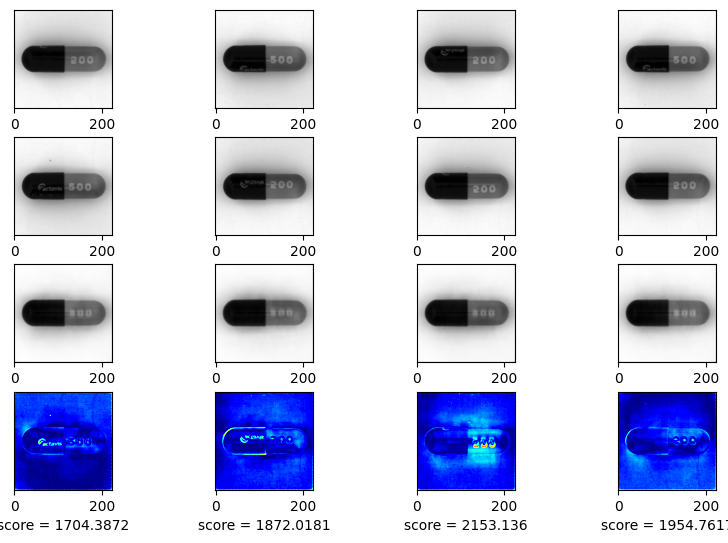

EPOCH 144/150
	 partial train loss (single batch): 0.229207
	 partial train loss (single batch): 0.217083
	 partial train loss (single batch): 0.244134
	 partial train loss (single batch): 0.236865
	 partial train loss (single batch): 0.250346
	 partial train loss (single batch): 0.319164
	 partial train loss (single batch): 0.237799
	 partial train loss (single batch): 0.263663
	 partial train loss (single batch): 0.608061
	 partial train loss (single batch): 0.611337
	 partial train loss (single batch): 0.739190
	 partial train loss (single batch): 0.437520
	 partial train loss (single batch): 0.212591
	 partial train loss (single batch): 0.616384
	 partial train loss (single batch): 0.623739
	 partial train loss (single batch): 0.415942
	 partial train loss (single batch): 0.416723
	 partial train loss (single batch): 0.315668
	 partial train loss (single batch): 0.875296
	 partial train loss (single batch): 0.806296
	 partial train loss (single batch): 0.293005
	 partial train loss

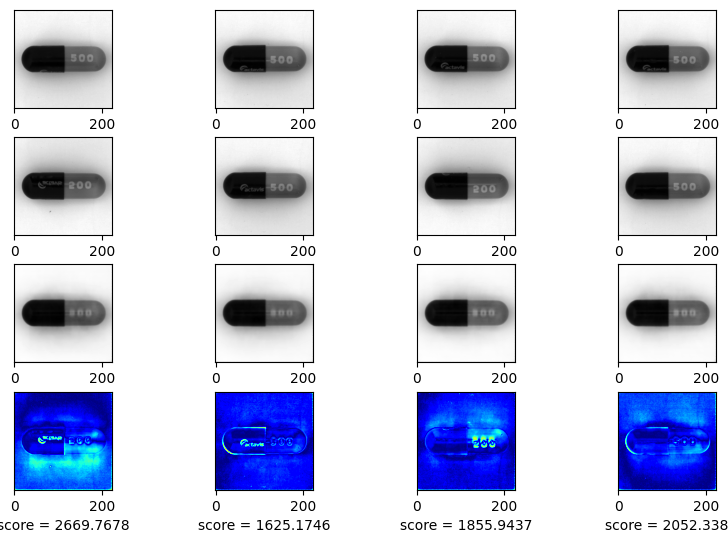

EPOCH 145/150
	 partial train loss (single batch): 1.078587
	 partial train loss (single batch): 1.172316
	 partial train loss (single batch): 0.707123
	 partial train loss (single batch): 0.304933
	 partial train loss (single batch): 0.910989
	 partial train loss (single batch): 1.022949
	 partial train loss (single batch): 0.394744
	 partial train loss (single batch): 0.371014
	 partial train loss (single batch): 0.647177
	 partial train loss (single batch): 0.427102
	 partial train loss (single batch): 0.387047
	 partial train loss (single batch): 0.350924
	 partial train loss (single batch): 0.469212
	 partial train loss (single batch): 0.553798
	 partial train loss (single batch): 0.243916
	 partial train loss (single batch): 0.655819
	 partial train loss (single batch): 1.132651
	 partial train loss (single batch): 0.841750
	 partial train loss (single batch): 0.743316
	 partial train loss (single batch): 0.794957
	 partial train loss (single batch): 1.058040
	 partial train loss

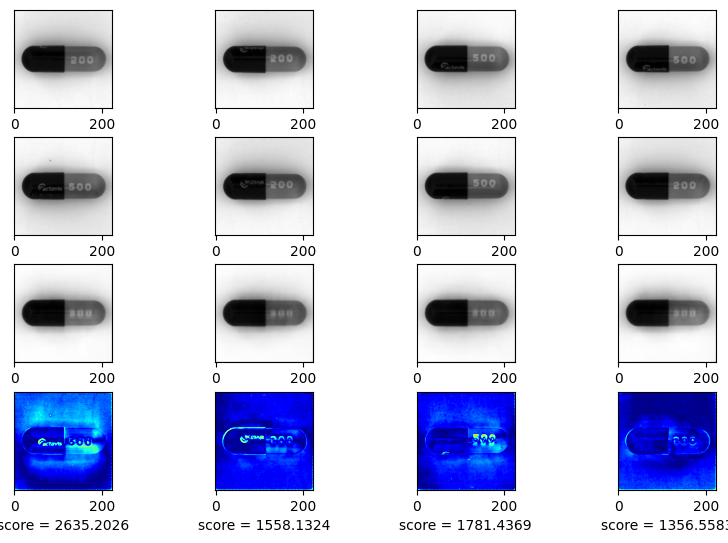

EPOCH 146/150
	 partial train loss (single batch): 0.342652
	 partial train loss (single batch): 0.504981
	 partial train loss (single batch): 0.792524
	 partial train loss (single batch): 0.352469
	 partial train loss (single batch): 0.435974
	 partial train loss (single batch): 0.749183
	 partial train loss (single batch): 0.555713
	 partial train loss (single batch): 0.412183
	 partial train loss (single batch): 0.605536
	 partial train loss (single batch): 1.027606
	 partial train loss (single batch): 0.984935
	 partial train loss (single batch): 0.272065
	 partial train loss (single batch): 0.571781
	 partial train loss (single batch): 1.021908
	 partial train loss (single batch): 0.837031
	 partial train loss (single batch): 0.381074
	 partial train loss (single batch): 0.318590
	 partial train loss (single batch): 1.101370
	 partial train loss (single batch): 1.364183
	 partial train loss (single batch): 0.739368
	 partial train loss (single batch): 0.257506
	 partial train loss

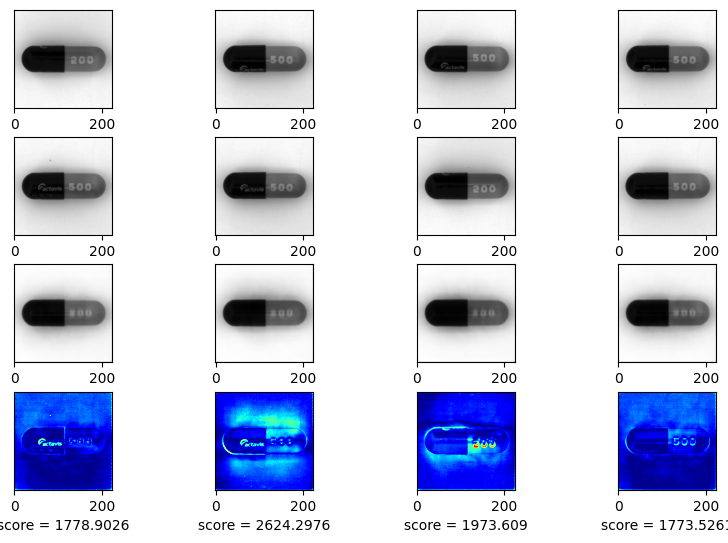

EPOCH 147/150
	 partial train loss (single batch): 1.090493
	 partial train loss (single batch): 0.515050
	 partial train loss (single batch): 0.251234
	 partial train loss (single batch): 0.564149
	 partial train loss (single batch): 1.127148
	 partial train loss (single batch): 1.010385
	 partial train loss (single batch): 0.376323
	 partial train loss (single batch): 0.265598
	 partial train loss (single batch): 1.048069
	 partial train loss (single batch): 1.720575
	 partial train loss (single batch): 1.183171
	 partial train loss (single batch): 0.393485
	 partial train loss (single batch): 0.220729
	 partial train loss (single batch): 0.464696
	 partial train loss (single batch): 0.665313
	 partial train loss (single batch): 0.382985
	 partial train loss (single batch): 0.269395
	 partial train loss (single batch): 0.750074
	 partial train loss (single batch): 0.865079
	 partial train loss (single batch): 0.519843
	 partial train loss (single batch): 0.229953
	 partial train loss

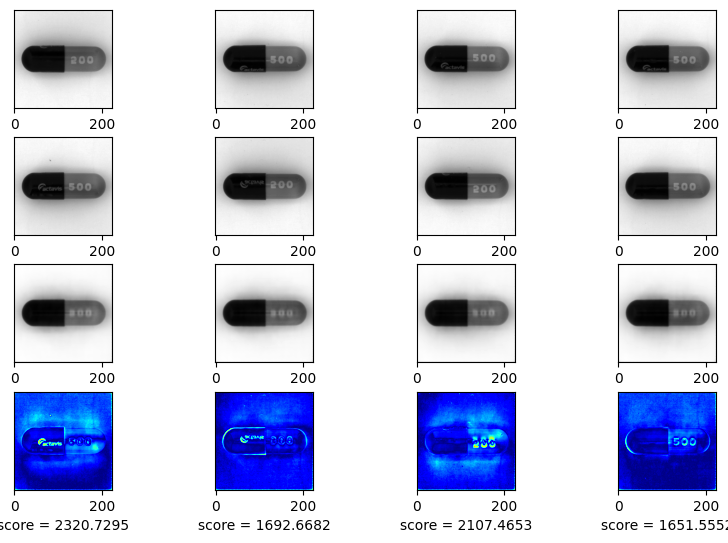

EPOCH 148/150
	 partial train loss (single batch): 0.781328
	 partial train loss (single batch): 0.962633
	 partial train loss (single batch): 0.437174
	 partial train loss (single batch): 0.466820
	 partial train loss (single batch): 1.473573
	 partial train loss (single batch): 1.495494
	 partial train loss (single batch): 0.609415
	 partial train loss (single batch): 0.225124
	 partial train loss (single batch): 0.450723


In [ ]:
import dill
from pytorch_msssim import SSIM, MS_SSIM
num_epochs =150
#loss_fn = nn.L1Loss()
loss_fn = SSIM(win_sigma=1.5, data_range=1, size_average=True, channel=1)
history_da={'train_loss':[], 'val_loss':[], 'pair_train_loss':[], 'score': []}

#autoencoder = torch.load( 'Denoise_autoencoder.pth', pickle_module = dill)

for epoch in range(num_epochs):
  print('EPOCH %d/%d' % (epoch + 1, num_epochs))

  pair_train_loss, train_loss = train_epoch(
      autoencoder=autoencoder,
      device=device,
      dataloader=capsule_trainloader,
      optimizer=optimizer,
      loss_fn =loss_fn
  )

  val_loss = test_epoch(
      autoencoder=autoencoder,
      device=device,
      dataloader=capsule_validloader,
      loss_fn = loss_fn
  )
  # Print Validationloss
  history_da['train_loss'].append(train_loss)
  history_da['val_loss'].append(val_loss)
  print('\n EPOCH {}/{} \t train loss {:.3f} \t val loss {:.3f}'.format(epoch + 1, num_epochs,pair_train_loss,val_loss))
  plot_ae_outputs_den(autoencoder)
plt.plot(train_loss)
torch.save(autoencoder, 'vae_capsule_ssim.pth',pickle_module = dill)





In [ ]:
import dill
autoencoder = torch.load('vae_capsule_ssim.pth',pickle_module = dill)
test_transform = transforms.Compose([transforms.Resize([224,224]),transforms.Grayscale(),transforms.ToTensor()])
'''
autoencoder.eval()
with torch.no_grad():
    # calculate mean and std of latent code, generated takining in test images as inputs
    images = next(iter(bottle_test_blloader))
    images = images.to(device)
    img_recon, _, _ = autoencoder(images)
    #latent = encoder(images)
    #latent = latent.cpu()

    #mean = latent.mean(dim=0)

    #print(mean)
    #print(mean.shape)
    #std = (latent - mean).pow(2).mean(dim=0).sqrt()
    #print(std)
    #print(std.shape)

    # sample latent vectors from the normal distribution
    #latent = torch.randn(224, 8,8)*std + mean

    # reconstruct images from the random latent vectors
    #latent = latent.to(device)
    #img_recon = decoder(latent)
    img_recon = img_recon.cpu()


    fig, ax = plt.subplots(figsize=(20, 8.5))
    show_image(torchvision.utils.make_grid(img_recon[:100],10,5))
    plt.show()
'''

'\nautoencoder.eval()\nwith torch.no_grad():\n    # calculate mean and std of latent code, generated takining in test images as inputs \n    images = next(iter(bottle_test_blloader))\n    images = images.to(device)\n    img_recon, _, _ = autoencoder(images)\n    #latent = encoder(images)\n    #latent = latent.cpu()\n\n    #mean = latent.mean(dim=0)\n\n    #print(mean)\n    #print(mean.shape)\n    #std = (latent - mean).pow(2).mean(dim=0).sqrt()\n    #print(std)\n    #print(std.shape)\n\n    # sample latent vectors from the normal distribution\n    #latent = torch.randn(224, 8,8)*std + mean\n\n    # reconstruct images from the random latent vectors\n    #latent = latent.to(device)\n    #img_recon = decoder(latent)\n    img_recon = img_recon.cpu()\n\n\n    fig, ax = plt.subplots(figsize=(20, 8.5))\n    show_image(torchvision.utils.make_grid(img_recon[:100],10,5))\n    plt.show()\n'

In [ ]:
from skimage.metrics import structural_similarity as ski_ssim
from pytorch_msssim import SSIM, MS_SSIM

def image_reconstructed_plot(model: torch.nn.Module,
                             image_path: str,
                             transform=None,
                             device: torch.device = device):

    """ Plots image before and after passing through autoencoder, and SSIM contour """

    fig, ax = plt.subplots(1, 3)
    plt.gray()

    img = Image.open(image_path)

    if transform:
        img_transformed = transform(img)

    model.to(device)
    model.eval()
    with torch.inference_mode():
        input_image = img_transformed.unsqueeze(dim=0).to(device)
        print(input_image.shape)
        reconstructed , _, _= model(input_image)

    original = img_transformed.permute(1, 2, 0).cpu()

    #defect = image_path.split("/")

    ax[0].imshow(original)
    ax[0].set_title(f"original_imge")
    ax[0].axis("off")

    reconstructed = reconstructed.squeeze(0).permute(1, 2, 0).cpu()
    ax[1].imshow(reconstructed)
    ax[1].set_title("Reconstructed")
    ax[1].axis("off")

    img_old = np.array(original.squeeze(2))
    print(type(img_old))
    img_new = np.array(reconstructed.squeeze(2))
    _, S = ski_ssim(img_old, img_new, full=True, channel_axis=False)

    ax[2].imshow(1-S, vmax = 1, cmap='jet')
    ax[2].set_title("SSIM")
    ax[2].axis("off")

    plt.axis(False)
    plt.show()

In [ ]:
test_good_image = mvtec_path / "pill/test/good/000.png"
test_cb_image = mvtec_path / "pill/test/combined/000.png"
test_ct_image = mvtec_path / "pill/test/contamination/000.png"
test_cr_image = mvtec_path / "pill/test/crack/000.png"
test_f_image = mvtec_path / "pill/test/faulty_imprint/000.png"
test_s_image = mvtec_path / "pill/test/scratch/000.png"


torch.Size([1, 1, 256, 256])
<class 'numpy.ndarray'>


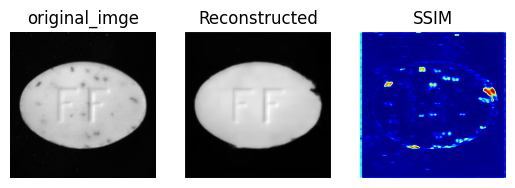

torch.Size([1, 1, 256, 256])
<class 'numpy.ndarray'>


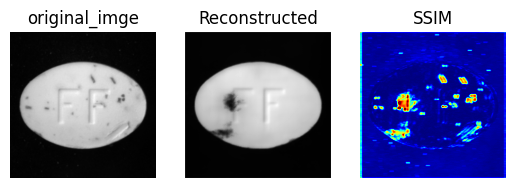

torch.Size([1, 1, 256, 256])
<class 'numpy.ndarray'>


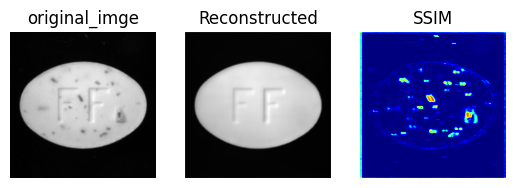

torch.Size([1, 1, 256, 256])
<class 'numpy.ndarray'>


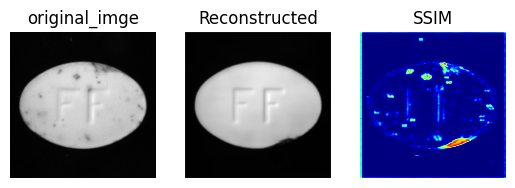

torch.Size([1, 1, 256, 256])
<class 'numpy.ndarray'>


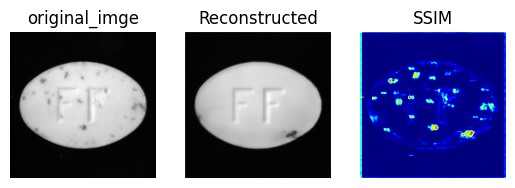

torch.Size([1, 1, 256, 256])
<class 'numpy.ndarray'>


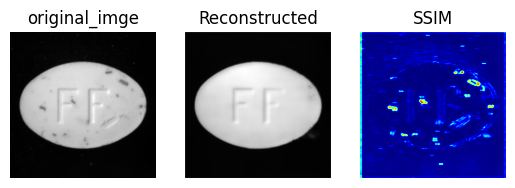

In [ ]:
image_reconstructed_plot(autoencoder, test_good_image, transform = test_transform)
image_reconstructed_plot(autoencoder, test_cb_image, transform = test_transform)
image_reconstructed_plot(autoencoder, test_ct_image, transform=test_transform)
image_reconstructed_plot(autoencoder, test_cr_image, transform=test_transform)
image_reconstructed_plot(autoencoder, test_f_image, transform=test_transform)
image_reconstructed_plot(autoencoder, test_s_image, transform=test_transform)

In [ ]:
ctest_good_image = mvtec_path / "capsule/test/good/000.png"
ctest_f_image = mvtec_path / "capsule/test/faulty_imprint/000.png"
ctest_p_image = mvtec_path / "capsule/test/poke/000.png"
ctest_sc_image = mvtec_path / "capsule/test/scratch/000.png"
ctest_sq_image = mvtec_path / "capsule/test/squeeze/000.png"

torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


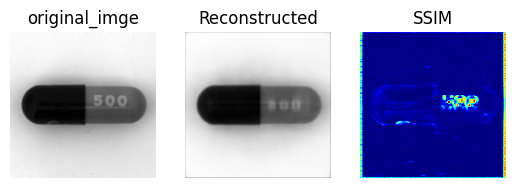

torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


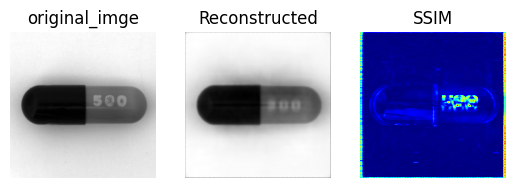

torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


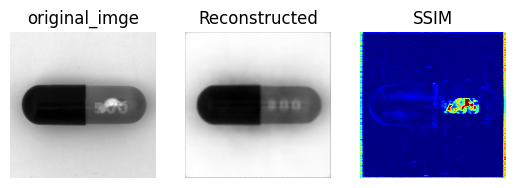

torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


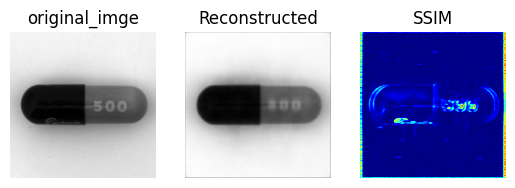

torch.Size([1, 1, 224, 224])
<class 'numpy.ndarray'>


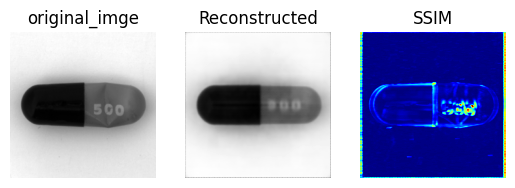

In [ ]:
image_reconstructed_plot(autoencoder, ctest_good_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_f_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_p_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_sc_image, transform = test_transform)
image_reconstructed_plot(autoencoder, ctest_sq_image, transform = test_transform)

In [ ]:
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

pca = PCA(n_components=2)
pca_data = pca.fit_transform(bottle_valid.reshape(-1, 28*28))

def plot_clusters(data, labels, title=None, show=False):
    x_min, x_max = np.min(data, 0), np.max(data, 0)
    X = (data - x_min) / (x_max - x_min)

    figure = plt.figure(figsize=(12, 10))
    for i in range(X.shape[0]):
        plt.text(X[i, 0], X[i, 1], str(labels[i]),
                 color=plt.cm.Set1(labels[i] / 10.),
                 fontdict={'weight': 'bold', 'size': 9})

    plt.title(title)
    plt.xticks([])
    plt.yticks([])
    sns.despine(top=True, left=True, bottom=True, right=True)
    if show:
        plt.show()

    return figure

figure = plot_clusters(pca_data, val_labels, title="PCA on the raw images", show=True)